In [354]:
import datetime
print(datetime.datetime.now())
today = datetime.datetime.now().strftime('%d/%m/%Y')

2025-11-23 06:47:15.496849


In [355]:
import os
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mlt

In [356]:
df = pd.read_csv('listings.csv', encoding='cp1252')
df.head()

,id,listing_url,scrape_id,last_searched,last_scraped,source,name,description,neighborhood_overview,picture_url,...,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,region_id,region_name,region_parent_id,region_parent_name,region_parent_parent_id,region_parent_parent_name,reviews_per_month
0,8815553,https://www.airbnb.com/rooms/8815553,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Forest & mountainbike heaven,"My place is in Lynmore suburb, and only a bloc...",Lynmore is a quiet green family suburb - a ver...,https://a0.muscache.com/pictures/b9eb1c60-d19e...,...,1,0,0,2499,Area Outside Ward,24,Rotorua District,NaN,NaN,6.7900
1,35266840,https://www.airbnb.com/rooms/35266840,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Tui's Nest Redwoods-Guest suite + simple break...,Tui's Nest ** No cleaning Fee ** Simple Breakf...,We love the safe and secure Neighbourhood of L...,https://a0.muscache.com/pictures/c8208ba9-34da...,...,1,0,0,2499,Area Outside Ward,24,Rotorua District,NaN,NaN,5.6500
2,1137415991237157527,https://www.airbnb.com/rooms/1137415991237157527,"20,250,900,000,000.0000",2025/9/6,2025/9/11,country scrape,Brand new Food Forest retreat,Brand new accommodation overlooking a growing ...,NaN,https://a0.muscache.com/pictures/hosting/Hosti...,...,1,0,0,2303,Te Papa-Welcome Bay Ward,23,Tauranga City,NaN,NaN,1.1600
3,43972393,https://www.airbnb.com/rooms/43972393,"20,250,900,000,000.0000",2025/9/6,2025/9/11,country scrape,"Hot Water Beach Coromandel ,Magnificient sea v...",Two bedroom typical kiwi Bach with 180 degree ...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,...,1,0,0,1102,Mercury Bay Ward,11,Thames-Coromandel District,NaN,NaN,1.8300
4,532561455107170254,https://www.airbnb.com/rooms/532561455107170254,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,"The Palm, Huia Street (5 - front unit) - LAKE ...","A hop, skip & jump to the lake, to town (10 mi...","If your after the best location, super central...",https://a0.muscache.com/pictures/miso/Hosting-...,...,2,0,0,2102,Taup?? Ward,21,Taupo District,NaN,NaN,1.9400


In [357]:
df.tail()

,id,listing_url,scrape_id,last_searched,last_scraped,source,name,description,neighborhood_overview,picture_url,...,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,region_id,region_name,region_parent_id,region_parent_name,region_parent_parent_id,region_parent_parent_name,reviews_per_month
47092,1305573353700115177,https://www.airbnb.com/rooms/1305573353700115177,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Lofty Ponsonby Haven w Parking,"Located in the lovely suburb of Ponsonby, this...",NaN,https://a0.muscache.com/pictures/hosting/Hosti...,...,4,0,0,7605,Waitemat?? and Gulf Ward,76,Auckland,NaN,NaN,9.0800
47093,25236606,https://www.airbnb.com/rooms/25236606,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Garden Studio close to city centre,Studio and bathroom in the heart of Grey Lynn....,Less than five minutes walk to Richmond Rd: La...,https://a0.muscache.com/pictures/fbfc5981-f1a9...,...,1,0,0,7605,Waitemat?? and Gulf Ward,76,Auckland,NaN,NaN,4.1900
47094,1162523178039110095,https://www.airbnb.com/rooms/1162523178039110095,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Amazing Retreat in Queenstown!,Welcome to our stunning retreat near the Remar...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,...,20,6,0,7001,Queenstown-Wakatipu Ward,70,Queenstown-Lakes District,NaN,NaN,4.2400
47095,919810258132974739,https://www.airbnb.com/rooms/919810258132974739,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Rata Retreat - Ohakune Holiday Home,With the charm of a character cottage and the ...,Ohakune is the ski capital for the North Islan...,https://a0.muscache.com/pictures/prohost-api/H...,...,1559,1,0,3604,Waimarino-Waiouru Ward,36,Ruapehu District,NaN,NaN,0.1200
47096,1127782668070579782,https://www.airbnb.com/rooms/1127782668070579782,"20,250,900,000,000.0000",2025/9/6,2025/9/12,country scrape,Mt Maunganui Hideaway,Perfectly located within a 2 minute walk to th...,NaN,https://a0.muscache.com/pictures/prohost-api/H...,...,51,0,0,2301,Mount Maunganui-Papamoa Ward,23,Tauranga City,NaN,NaN,0.8900


In [358]:
df.isna().sum().sum()

np.int64(446838)

In [359]:
df.isna().sum().sort_values(ascending=False)

license                                        47097
region_parent_parent_name                      47097
region_parent_parent_id                        47097
requires_license                               47097
calendar_updated                               47097
                                               ...  
calculated_host_listings_count_shared_rooms        0
region_parent_id                                   0
region_name                                        0
region_id                                          0
region_parent_name                                 0
Length: 85, dtype: int64

In [360]:
s = df.isna().sum().sort_values(ascending=False)
print(s.to_string())

license                                         47097
region_parent_parent_name                       47097
region_parent_parent_id                         47097
requires_license                                47097
calendar_updated                                47097
host_neighbourhood                              47018
neighbourhood                                   24601
neighborhood_overview                           24601
host_about                                      24426
host_location                                    9994
host_response_time                               6336
host_response_rate                               6336
review_scores_communication                      5172
review_scores_location                           5172
review_scores_accuracy                           5172
review_scores_checkin                            5172
review_scores_value                              5172
last_review                                      5171
reviews_per_month           

In [361]:
missing_cols = df.columns[df.isna().any()].tolist()
missing_cols

['last_searched',
 'description',
 'neighborhood_overview',
 'host_name',
 'host_since',
 'host_location',
 'host_about',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_thumbnail_url',
 'host_picture_url',
 'host_neighbourhood',
 'host_listings_count',
 'host_total_listings_count',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'neighbourhood',
 'bathrooms',
 'bathrooms_text',
 'bedrooms',
 'beds',
 'price',
 'minimum_minimum_nights',
 'maximum_minimum_nights',
 'minimum_maximum_nights',
 'maximum_maximum_nights',
 'calendar_updated',
 'has_availability',
 'estimated_revenue_l365d',
 'first_review',
 'last_review',
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value',
 'requires_license',
 'license',
 'region_parent_parent_id',
 'region_parent_parent_name',
 'reviews_per

In [362]:
report = """I. Business Context & Objectives
Business Context:
This dataset contains Airbnb listings across New Zealand cities and suburbs, featuring a wealth of attributes: 
price, availability, rating, amenities, room/property type, host profile, and location.

Objectives:
Translate these signals into actionable guidelines to help new hosts operate professionally and gradually reach the level of a "superhost."
"""
print(report)

I. Business Context & Objectives
Business Context:
This dataset contains Airbnb listings across New Zealand cities and suburbs, featuring a wealth of attributes: 
price, availability, rating, amenities, room/property type, host profile, and location.

Objectives:
Translate these signals into actionable guidelines to help new hosts operate professionally and gradually reach the level of a "superhost."



In [363]:
report = """II. Stakeholders
Host: How to become a super host and maintain stable income and positive reviews.
Guest: How to choose the best value Airbnb in your preferred suburb.
"""
print(report)

II. Stakeholders
Host: How to become a super host and maintain stable income and positive reviews.
Guest: How to choose the best value Airbnb in your preferred suburb.



In [364]:
report= """ III. Use Case
We organize use cases along two complementary lenses:

Branch A – Host ↔ Features: How to be a super host from new host.
Branch B – Market ↔ Features: How each feature associates with Market.
"""
print(report)

 III. Use Case
We organize use cases along two complementary lenses:

Branch A – Host ↔ Features: How to be a super host from new host.
Branch B – Market ↔ Features: How each feature associates with Market.



In [555]:
report='''
Branch A – Host ↔ Features: How to be a super host from new host.

First part – Host–renter interaction: response behaviour and review ratings.
This section first focuses on interaction factors between hosts and guests. 
It examines the most direct and actionable signals from both sides of the transaction on the Airbnb platform:

Host response behaviour – how hosts respond to enquiries and booking requests, measured by
host_response_rate, host_response_time, host_acceptance_rate, and instant_bookable.
These indicators describe whether a host is willing to accept bookings, how quickly they respond, and how smooth the booking process is.

Post-stay guest review ratings – how guests evaluate their stay, captured by the overall review_scores_rating and six sub-scores
(accuracy, cleanliness, check-in, communication, location, and value), together with the volume and recency of reviews 
(number_of_reviews, number_of_reviews_ltm, number_of_reviews_l30d, reviews_per_month).

These metrics reflect whether the stay experience was positive, whether guests are likely to rebook, and whether they are willing to recommend the host.


Methodologically, this part of the analysis will:
Compare groups – contrast Superhosts and non-Superhosts in terms of overall distributions and bucketed segments.
Handle missing data explicitly – distinguish between “missing = unknown” and valid zeros, and report counts and shares of missing values in the tables.
Use visual summaries – combine tables (counts and shares), bar charts (scale comparison), and pie charts (structural proportions) to present the results.


Second part – Host-related attributes, listing configuration, location and pricing.

The second part extends the analysis from interaction outcomes to the underlying host and listing attributes. 
It first examines host-related factors such as hosting age, verification methods, identity verification status, and profile picture availability. 
It then compares property type and configuration variables (accommodates, bedrooms, beds, bathrooms) across different locations
(region, city, neighbourhood) and pricing and rules (nightly price and booking constraints). 

Finally, it conducts cross-comparisons from two complementary perspectives:
Same configuration, different location pricing – how similarly configured listings are priced across different areas.
Same location, different configuration pricing – how prices vary within the same area as room size and facilities change.

In summary, we begin with Response behaviour and Review ratings,then move on to host-related factors, 
and finally link property type, configuration, location and pricing to understand 
how Superhosts and non-Superhosts differ in both interaction quality and underlying listing structure.
'''
print(report)


Branch A – Host ↔ Features: How to be a super host from new host.

First part – Host–renter interaction: response behaviour and review ratings.
This section first focuses on interaction factors between hosts and guests. 
It examines the most direct and actionable signals from both sides of the transaction on the Airbnb platform:

Host response behaviour – how hosts respond to enquiries and booking requests, measured by
host_response_rate, host_response_time, host_acceptance_rate, and instant_bookable.
These indicators describe whether a host is willing to accept bookings, how quickly they respond, and how smooth the booking process is.

Post-stay guest review ratings – how guests evaluate their stay, captured by the overall review_scores_rating and six sub-scores
(accuracy, cleanliness, check-in, communication, location, and value), together with the volume and recency of reviews 
(number_of_reviews, number_of_reviews_ltm, number_of_reviews_l30d, reviews_per_month).

These metrics ref

In [551]:
report='''
First part:Host-Rental Interaction: A Two-Dimensional Analysis from "Response Behavior" and "Review Ratings". 
This analysis report first focuses on the interaction factors between hosts and renters. 
This first part reflects the most direct and actionable signals from both ends of the transaction relationship on the Airbnb platform:
1. Host's 'response' behavior to renter inquiries/bookings , including host_response_rate, host_response_time, host_acceptance_rate, and instant_bookable. 
These metrics characterize whether a host is willing to accept bookings,how quickly they accept bookings, and whether the process is smooth.

2. Post-stay guest review ratings (review metrics), including review_scores_rating (overall) 
and six sub-categories (accuracy, cleanliness, check-in, communication, location, value), 
as well as the number and freshness of reviews related to reviews (number of reviews / _ltm / _l30d, reviews_per_month). 
These metrics reflect whether the stay was good, whether the guest is willing to rebook, and whether they would recommend the host.

Methodologically, we will:
1. Group comparison: Superhost vs Non-Superhost, examining both overall differences and bucket distribution.
2. Missing data handling: Clearly defining the boundaries between "missing data = unknown" and providing counts and shares in the table.
3. Visualization: Tables (counts & shares), bar charts (comparing scale), and pie charts (structural proportions).

Second part: we will move on to "host-related factors" (hosting age, verifications, identity_verified,has_profile_pic, etc.), 
then compare "property type" ,"accommodates、bedrooms、beds、bathrooms " with "location" and "pricing and rules"，
and finally conduct a cross-comparison of "same configuration, different location pricing" and "same location, different configuration pricing."  

We begin with Response (response behavior) and Reviews (reputation ratings) part.
Then we analyse host-related factors part.
'''
print(report)


First part:Host-Rental Interaction: A Two-Dimensional Analysis from "Response Behavior" and "Review Ratings". 
This analysis report first focuses on the interaction factors between hosts and renters. 
This first part reflects the most direct and actionable signals from both ends of the transaction relationship on the Airbnb platform:
1. Host's 'response' behavior to renter inquiries/bookings , including host_response_rate, host_response_time, host_acceptance_rate, and instant_bookable. 
These metrics characterize whether a host is willing to accept bookings,how quickly they accept bookings, and whether the process is smooth.

2. Post-stay guest review ratings (review metrics), including review_scores_rating (overall) 
and six sub-categories (accuracy, cleanliness, check-in, communication, location, value), 
as well as the number and freshness of reviews related to reviews (number of reviews / _ltm / _l30d, reviews_per_month). 
These metrics reflect whether the stay was good, whether t

In [366]:
report='''
Branch A-Response

In Airbnb's Superhost rating system, the host's ability to "respond proactively and reliably to guests" is the most crucial behavioral indicator. 

Therefore, this section focuses on the host's performance during the inquiry and booking process, comparing Superhosts and non-Superhosts in terms of 
'response rate', 'response time', 'acceptance rate', and 'instant bookable' to see just how different "superhosts" are in these behaviors.
'''
print(report)


Branch A-Response

In Airbnb's Superhost rating system, the host's ability to "respond proactively and reliably to guests" is the most crucial behavioral indicator. 

Therefore, this section focuses on the host's performance during the inquiry and booking process, comparing Superhosts and non-Superhosts in terms of 
'response rate', 'response time', 'acceptance rate', and 'instant bookable' to see just how different "superhosts" are in these behaviors.



In [367]:
df = df.copy()

df['is_super'] = (
    df['host_is_superhost']
      .astype(str)
      .str.strip()
      .str.lower()
      .map({'t': 1, 'true': 1, '1': 1,
            'f': 0, 'false': 0, '0': 0})
      .astype('Int8')
)

print("Total hosts:", len(df))
print("Superhosts:", int((df['is_super'] == 1).sum()))
print("Non-Superhosts:", int((df['is_super'] == 0).sum()))


rate_str = (
    df['host_response_rate']
      .astype(str)
      .str.strip()
      .str.replace('%', '', regex=False)       # remove %
      .replace({'nan': np.nan, '': np.nan,
                'NA': np.nan, 'N/A': np.nan})
)

df['response_rate_pct'] = pd.to_numeric(rate_str, errors='coerce')




sup = df[df['is_super'] == 1].copy()

sup_rate_counts = (
    sup['response_rate_pct']
      .dropna()
      .round(0)
      .value_counts()
      .sort_index()
      .rename_axis('response_rate_pct')
      .reset_index(name='count')
)

print("\nSuperhost response rate distribution:")
display(
    sup_rate_counts.style.format({
        'response_rate_pct': '{:.0f}%',
        'count': '{:,.0f}'
    })
)



non_sup = df[df['is_super'] == 0].copy()

non_rate_counts = (
    non_sup['response_rate_pct']
      .dropna()
      .round(0)
      .value_counts()
      .sort_index()
      .rename_axis('response_rate_pct')
      .reset_index(name='count')
)

print("\nNon-Superhost response rate distribution:")
display(
    non_rate_counts.style.format({
        'response_rate_pct': '{:.0f}%',
        'count': '{:,.0f}'
    })
)


Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Superhost response rate distribution:


,response_rate_pct,count
0,0%,24
1,17%,1
2,20%,5
3,25%,1
4,33%,5
5,40%,5
6,50%,23
7,60%,6
8,63%,1
9,67%,44



Non-Superhost response rate distribution:


,response_rate_pct,count
0,0%,540
1,10%,7
2,11%,2
3,13%,4
4,14%,2
5,17%,8
6,18%,3
7,20%,14
8,22%,1
9,25%,20


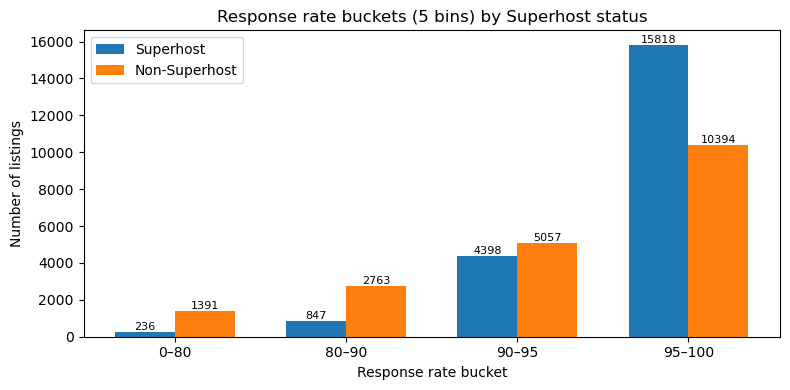

In [368]:
#table
df = df.copy()

df['is_super'] = (
    df['host_is_superhost']
      .astype(str)
      .str.strip()
      .str.lower()
      .map({'t': 1, 'true': 1, '1': 1,
            'f': 0, 'false': 0, '0': 0})
      .astype('Int8')
)

bins = [0, 80, 90, 95, 99, 100]
labels = ['0–80%', '80–90%', '90–95%', '95–99%', '100%']


#Bar chart
x_labels = pivot_counts.index.tolist()        
x = np.arange(len(x_labels))
width = 0.35

super_vals = pivot_counts['Superhost'].values
non_vals   = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(8, 4))

bars_super = plt.bar(x - width/2, super_vals, width, label='Superhost')
bars_non   = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xticks(x, x_labels)
plt.ylabel('Number of listings')
plt.xlabel('Response rate bucket')
plt.title('Response rate buckets (5 bins) by Superhost status')
plt.legend()

for bar in list(bars_super) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()


Response rate buckets (including 100%) by Superhost status:


,Non-Superhost,Superhost
bucket,,
0–80%,8.88%,1.11%
80–90%,3.66%,2.12%
90–95%,1.42%,0.61%
95–99%,12.60%,4.37%
100%,73.43%,91.78%


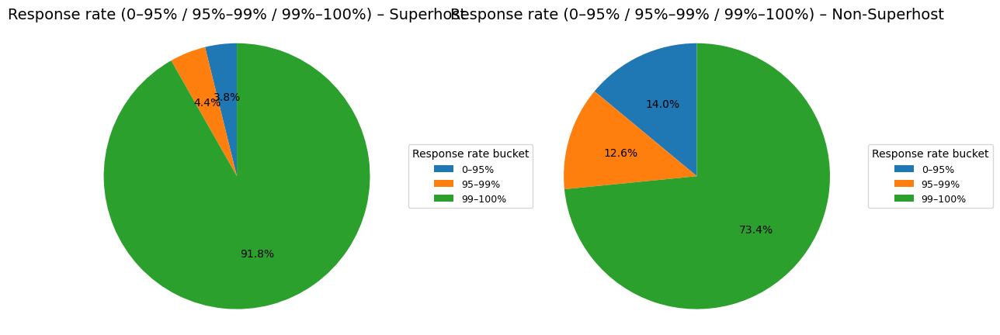

In [369]:
def bucket_response_rate(group_df, group_name):
    rates = (
        group_df['response_rate_pct']
        .dropna()
    )
    
    if len(rates) == 0:
        print(f"[WARN] No valid response rates for group {group_name}")
    
    bucket = pd.cut(
        rates,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True   
    )
    
    bc = (
        bucket.value_counts()
              .reindex(labels, fill_value=0)
              .rename_axis('bucket')
              .reset_index(name='count')
    )
    total = bc['count'].sum()
    bc['share'] = bc['count'] / total if total > 0 else 0
    bc['group'] = group_name
    return bc

bc_super = bucket_response_rate(df[df['is_super'] == 1], 'Superhost')
bc_non   = bucket_response_rate(df[df['is_super'] == 0], 'Non-Superhost')

bucket_compare = pd.concat([bc_super, bc_non], ignore_index=True)

print("\nResponse rate buckets (including 100%) by Superhost status:")

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None  

display(share_table.style.format('{:.2%}'))


pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

#pie chart
labels      = share_table.index.tolist()
sizes_super = share_table['Superhost'].values
sizes_non   = share_table['Non-Superhost'].values

bucket_map = {
    '0–80%':  '0–95%',
    '80–90%': '0–95%',
    '90–95%': '0–95%',
    '95–99%': '95–99%',
    '100%':   '99–100%',
}

agg_share = (
    share_table
        .rename(index=bucket_map)   
        .groupby(level=0).sum()     
        .reindex(['0–95%', '95–99%', '99–100%'])
)

labels_3    = agg_share.index.tolist()
sizes_super = agg_share['Superhost'].values
sizes_non   = agg_share['Non-Superhost'].values

def make_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1.1
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_3,
        title='Response rate bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

make_pie(axes[0], sizes_super, 'Response rate (0–95% / 95%–99% / 99%–100%) – Superhost')
make_pie(axes[1], sizes_non,   'Response rate (0–95% / 95%–99% / 99%–100%) – Non-Superhost')

plt.tight_layout()
plt.show()

In [370]:
report='''
The response rate closer to 100% is more likely to indicate a Superhost; a response rate below 95% strongly suggests a Non-Superhost.

For Branch A (response), host_response_rate is a highly discriminative metric: it can be directly used as one of the model's core features;
in practice, it can also be used as a simple rule, such as: `response_rate_pct >= 99%` → "high response".

It can also be seen that many listings among Non-Superhosts have a 100% response rate.
Therefore, a high response rate is a "necessary condition" for Superhosts, but not a "sufficient condition," 
and must be combined with other features such as ratings and review volume.

In this dataset, Superhosts almost consistently maintain a response rate close to 100%, 
while listings with low response rates are mainly concentrated in the Non-Superhost group. 
Therefore, "response rate" is not one of the key behavioral features for explaining Superhost identity.
'''
print(report)


The response rate closer to 100% is more likely to indicate a Superhost; a response rate below 95% strongly suggests a Non-Superhost.

For Branch A (response), host_response_rate is a highly discriminative metric: it can be directly used as one of the model's core features;
in practice, it can also be used as a simple rule, such as: `response_rate_pct >= 99%` → "high response".

It can also be seen that many listings among Non-Superhosts have a 100% response rate.
Therefore, a high response rate is a "necessary condition" for Superhosts, but not a "sufficient condition," 
and must be combined with other features such as ratings and review volume.

In this dataset, Superhosts almost consistently maintain a response rate close to 100%, 
while listings with low response rates are mainly concentrated in the Non-Superhost group. 
Therefore, "response rate" is not one of the key behavioral features for explaining Superhost identity.



Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Host response time by group (counts + shares):


,Superhost,Superhost_share,Non-Superhost,Non-Superhost_share
host_response_time_label,,,,
Within an hour,"18,297",82.83%,"12,468",52.17%
Within a few hours,"2,343",10.61%,"2,809",11.75%
Within a day,775,3.51%,"2,332",9.76%
A few days or more,42,0.19%,707,2.96%
NaN,634,2.87%,"5,584",23.36%


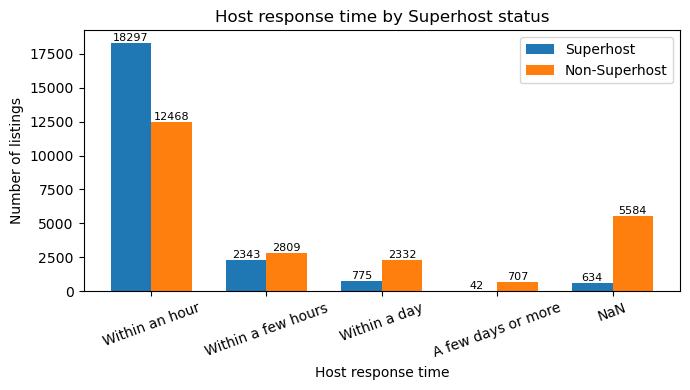

In [371]:
#response time
#table
df = df.copy()

df['is_super'] = (
    df['host_is_superhost']
      .astype(str)
      .str.strip()
      .str.lower()
      .map({'t': 1, 'true': 1, '1': 1,
            'f': 0, 'false': 0, '0': 0})
      .astype('Int8')
)

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


resp_time_str = (
    df['host_response_time']
      .astype('string')
      .str.strip()
      .str.lower()
)

label_map = {
    'within an hour': 'Within an hour',
    'within a few hours': 'Within a few hours',
    'within a day': 'Within a day',
    'a few days or more': 'A few days or more'
}

df['host_response_time_label'] = resp_time_str.map(label_map)
df['host_response_time_label'] = df['host_response_time_label'].fillna('NaN')


counts = (
    df.groupby(['host_response_time_label', 'is_super'])
      .size()
      .reset_index(name='count')
)


counts['group'] = counts['is_super'].map({1: 'Superhost', 0: 'Non-Superhost'})


totals = counts.groupby('group')['count'].sum()
counts['share'] = counts.apply(
    lambda row: row['count'] / totals[row['group']] if totals[row['group']] > 0 else 0,
    axis=1
)


count_pivot = (
    counts.pivot(index='host_response_time_label',
                 columns='group',
                 values='count')
)

share_pivot = (
    counts.pivot(index='host_response_time_label',
                 columns='group',
                 values='share')
)


result = count_pivot.copy()
if 'Superhost' in share_pivot.columns:
    result['Superhost_share'] = share_pivot['Superhost']
if 'Non-Superhost' in share_pivot.columns:
    result['Non-Superhost_share'] = share_pivot['Non-Superhost']


order = ['Within an hour', 'Within a few hours', 'Within a day', 'A few days or more', 'NaN']
order = [o for o in order if o in result.index]
result = result.reindex(order)

print("\nHost response time by group (counts + shares):")

result.columns.name = None


cols_order = ['Superhost', 'Superhost_share',
              'Non-Superhost', 'Non-Superhost_share']
result = result[cols_order]

display(
    result.style.format({
        'Superhost': '{:,.0f}',
        'Superhost_share': '{:.2%}',
        'Non-Superhost': '{:,.0f}',
        'Non-Superhost_share': '{:.2%}'
    })
)

#bar chart
plot_data = result.copy()

x_labels = plot_data.index.tolist()
x = np.arange(len(x_labels))
width = 0.35

super_vals = plot_data['Superhost'].fillna(0).values
non_vals   = plot_data['Non-Superhost'].fillna(0).values

plt.figure(figsize=(7, 4))

bars_super = plt.bar(x - width/2, super_vals, width, label='Superhost')
bars_non   = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xticks(x, x_labels, rotation=20)
plt.ylabel('Number of listings')
plt.xlabel('Host response time')
plt.title('Host response time by Superhost status')
plt.legend()

for bar in list(bars_super) + list(bars_non):
    height = bar.get_height()
    if height == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

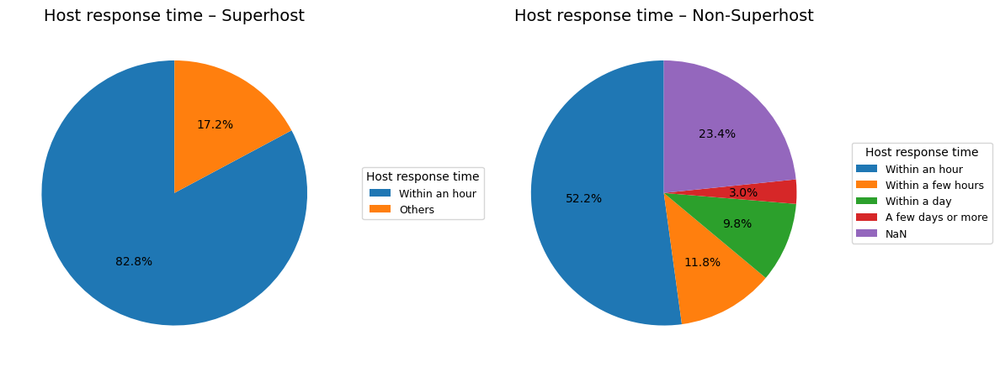

In [372]:
#pie chart response time
pie_data = result.copy()

sup_share = pie_data['Superhost_share'].fillna(0)

within_super = sup_share.get('Within an hour', 0)
others_super = sup_share.sum() - within_super

labels_super = ['Within an hour', 'Others']
sizes_super  = [within_super, others_super]

labels_non = pie_data.index.tolist()
sizes_non  = pie_data['Non-Superhost_share'].fillna(0).values

def make_pie(ax, sizes, labels, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels,
        title='Host response time',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

make_pie(
    axes[0],
    sizes_super,
    labels_super,
    'Host response time – Superhost'
)

make_pie(
    axes[1],
    sizes_non,
    labels_non,
    'Host response time – Non-Superhost'
)

plt.tight_layout()
plt.show()

In [373]:
report='''
host_response_time is a highly distinctive feature. 
The probability of seeing "Within an hour" responses is significantly higher for Superhosts than for Non-Superhosts.

"Response rate ≥ 80% within one hour" → very close to Superhost behavior;
"Response rate ≤ 50% within one hour, with many NaN responses" → more like Non-Superhosts.

Combined with response rate: We previously saw that Superhosts generally have a 99-100% response rate; 
here we see that Superhosts not only almost always respond, but most respond within one hour. 
Therefore these two behavioral dimensions together constitute the typical Superhost profile of "high responsiveness and high timeliness."

The difference in response timeliness between Superhosts and Non-Superhosts is very significant: over 80% of Superhosts can respond within one hour, 
while only about half of Non-Superhosts can do so. 
Responses taking more than a day or lacking response records are mainly concentrated in the Non-Superhost group. 
Therefore the response time should be within one hour to become a superhost.
'''
print(report)


host_response_time is a highly distinctive feature. 
The probability of seeing "Within an hour" responses is significantly higher for Superhosts than for Non-Superhosts.

"Response rate ≥ 80% within one hour" → very close to Superhost behavior;
"Response rate ≤ 50% within one hour, with many NaN responses" → more like Non-Superhosts.

Combined with response rate: We previously saw that Superhosts generally have a 99-100% response rate; 
here we see that Superhosts not only almost always respond, but most respond within one hour. 
Therefore these two behavioral dimensions together constitute the typical Superhost profile of "high responsiveness and high timeliness."

The difference in response timeliness between Superhosts and Non-Superhosts is very significant: over 80% of Superhosts can respond within one hour, 
while only about half of Non-Superhosts can do so. 
Responses taking more than a day or lacking response records are mainly concentrated in the Non-Superhost group. 
Therefor

In [374]:
#Accptance table
df = pd.read_csv("listings.csv", encoding="cp1252")

print(f"Total hosts: {len(df)}")

df['is_super'] = (
    df['host_is_superhost']
      .astype(str).str.strip().str.lower()
      .map({'t': 1, 'true': 1, '1': 1,
            'f': 0, 'false': 0, '0': 0})
      .astype('Int8')
)

print("Superhosts:", int((df['is_super'] == 1).sum()))
print("Non-Superhosts:", int((df['is_super'] == 0).sum()))


acc = (
    df['host_acceptance_rate']
      .astype(str).str.strip()
      .str.rstrip('%')   
      .replace({'nan': np.nan, '': np.nan, 'NA': np.nan, 'N/A': np.nan})
)

df['accept_rate_raw'] = pd.to_numeric(acc, errors='coerce')


if df['accept_rate_raw'].max() <= 1.1:
    df['accept_rate_pct'] = df['accept_rate_raw'] * 100
else:
    df['accept_rate_pct'] = df['accept_rate_raw']


sup_accept  = df.loc[df['is_super'] == 1, 'accept_rate_pct'].dropna()
non_accept = df.loc[df['is_super'] == 0, 'accept_rate_pct'].dropna()

print(f"\nSuperhosts with valid acceptance rate: {len(sup_accept)}")
print(f"Non-Superhosts with valid acceptance rate: {len(non_accept)}")

sup_rate_counts = (
    sup_accept.round(0)
              .value_counts()
              .sort_index()
              .rename_axis('accept_rate_pct')
              .reset_index(name='count')
)

non_rate_counts = (
    non_accept.round(0)
              .value_counts()
              .sort_index()
              .rename_axis('accept_rate_pct')
              .reset_index(name='count')
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Superhosts with valid acceptance rate: 22081
Non-Superhosts with valid acceptance rate: 21443



Acceptance rate buckets by Superhost status:


,Non-Superhost,Superhost
bucket,,
0–80%,28.01%,4.62%
80–90%,8.16%,8.32%
90–95%,5.89%,11.83%
95–99%,11.08%,33.42%
100%,46.86%,41.80%


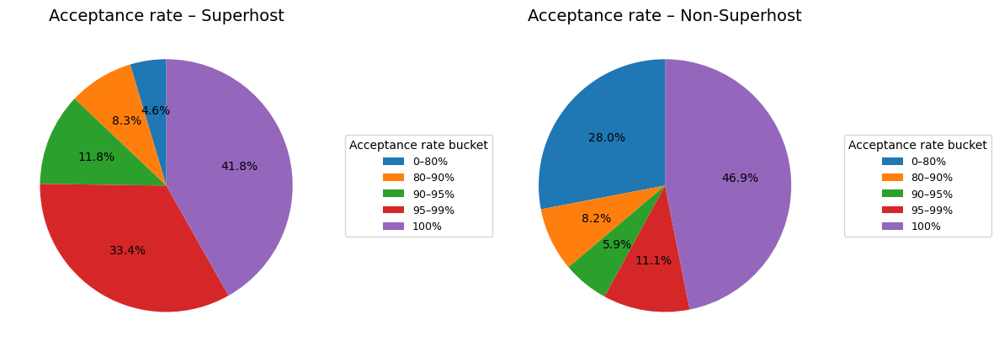

In [375]:
bins   = [0, 80, 90, 95, 99, 100]
labels = ['0–80%', '80–90%', '90–95%', '95–99%', '100%']

#table
def bucket_acceptance(rates, group_name):
    rates = rates.dropna()

    acc_bucket = pd.cut(
        rates,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bc = (
        acc_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(rates)
    bc['share'] = bc['count'] / total_valid if total_valid > 0 else 0
    bc['group'] = group_name
    return bc


bc_super = bucket_acceptance(sup_accept,  'Superhost')
bc_non   = bucket_acceptance(non_accept,  'Non-Superhost')

bucket_compare = pd.concat([bc_super, bc_non], ignore_index=True)


share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nAcceptance rate buckets by Superhost status:")
display(share_table.style.format('{:.2%}'))


#pie chart
pie_labels = share_table.index.tolist()
sizes_super = share_table['Superhost'].values
sizes_non   = share_table['Non-Superhost'].values

def make_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
        
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        pie_labels,
        title='Acceptance rate bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 6))
make_pie(axes[0], sizes_super, 'Acceptance rate – Superhost')
make_pie(axes[1], sizes_non,   'Acceptance rate – Non-Superhost')

plt.tight_layout()
plt.show()

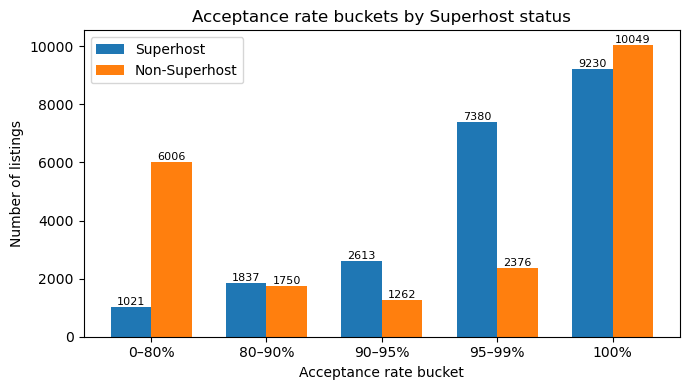

In [376]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals = pivot_counts['Superhost'].values
non_vals = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Acceptance rate bucket')
plt.ylabel('Number of listings')
plt.title('Acceptance rate buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [377]:
report='''
This table and bar chart clearly show that: Low acceptance rates (0–80%) are almost exclusively found on Non-Superhosts: 
28% of Non-Superhosts have an acceptance rate of 0–80%; only 4.6% of Superhosts have this rate.

Note: If the acceptance rate is very low, it's highly unlikely to be a Superhost.
Medium-to-high acceptance rates (90–99%) are significantly higher on Superhosts: 
90–95%: Superhost 11.8%, Non-Superhost 5.9%;  95–99%: Superhost 33.4%, Non-Superhost 11.1%.
Therefore, Superhosts are more concentrated in the 90–99% range, especially 95–99%.

Both Superhosts and Non-Superhosts have a significant number of hosts with a 100% acceptance rate,
but the percentages differ: Superhost 100%: 41.8%; Non-Superhost 100%: 46.9%. 
This indicates that a 100% acceptance rate is not unique to Superhosts; many Non-Superhosts also achieve a nominal 100% acceptance rate.

Regarding response rate, Superhosts are mostly clustered between 99-100%, while Non-Superhosts are much more dispersed.
Regarding acceptance rate: the lower range (0-80%) does indeed differentiate a large number of Non-Superhosts; however, 
the higher range (especially 100%) also contains many Non-Superhosts.

Therefore: Acceptance rate is useful for distinguishing "clearly unqualified hosts" (below 80% or 90%), 
but in the high acceptance rate range, Superhosts and Non-Superhosts are quite mixed.
Acceptance rate is a useful feature, but not as "deadly" as response rate.

Compared to regular hosts, Superhosts almost never have very low acceptance rates (0–80%),
and are more concentrated in the high acceptance rate range of 90–99%; however, 100% acceptance rates are common in both types of hosts. 
Therefore acceptance rate is not the sole criterion for superhosting eligibility, but achieving 100% acceptance is generally preferred.
'''
print(report)


This table and bar chart clearly show that: Low acceptance rates (0–80%) are almost exclusively found on Non-Superhosts: 
28% of Non-Superhosts have an acceptance rate of 0–80%; only 4.6% of Superhosts have this rate.

Note: If the acceptance rate is very low, it's highly unlikely to be a Superhost.
Medium-to-high acceptance rates (90–99%) are significantly higher on Superhosts: 
90–95%: Superhost 11.8%, Non-Superhost 5.9%;  95–99%: Superhost 33.4%, Non-Superhost 11.1%.
Therefore, Superhosts are more concentrated in the 90–99% range, especially 95–99%.

Both Superhosts and Non-Superhosts have a significant number of hosts with a 100% acceptance rate,
but the percentages differ: Superhost 100%: 41.8%; Non-Superhost 100%: 46.9%. 
This indicates that a 100% acceptance rate is not unique to Superhosts; many Non-Superhosts also achieve a nominal 100% acceptance rate.

Regarding response rate, Superhosts are mostly clustered between 99-100%, while Non-Superhosts are much more dispersed.
Reg

Instant bookable by Superhost status:


,group,n_hosts,n_instant,share_instant
0,Non-Superhost,"23,900","8,945",37.43%
1,Superhost,"22,091","9,008",40.78%


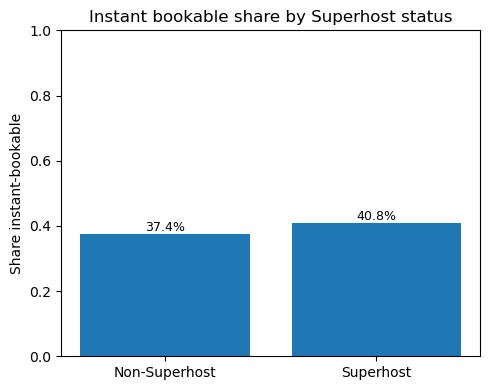


Instant bookable distribution within Superhosts:


,instant_bookable,count,share
0,Not instant bookable,"13,083",59.22%
1,Instant bookable,"9,008",40.78%


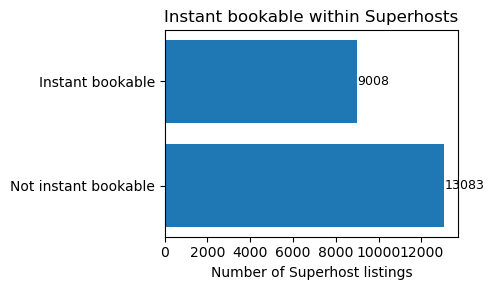

In [378]:
#Instant bookable
df = df.copy()

df['host_is_superhost_bin'] = (
    df['host_is_superhost']
      .astype(str)
      .str.strip()
      .str.lower()
      .map({'t': 1, 'true': 1, '1': 1,
            'f': 0, 'false': 0, '0': 0})
      .astype('Int8')
)

df['instant_bookable_bin'] = (
    df['instant_bookable']
      .astype(str)
      .str.strip()
      .str.lower()
      .map({'t': 1, 'true': 1, '1': 1,
            'f': 0, 'false': 0, '0': 0})
      .astype('Int8')
)


label_map = {0: 'Non-Superhost', 1: 'Superhost'}

tmp = df[
    df['host_is_superhost_bin'].notna() &
    df['instant_bookable_bin'].notna()
].copy()

summary_inst = (
    tmp.assign(group=lambda x: x['host_is_superhost_bin'].map(label_map))
       .groupby('group')['instant_bookable_bin']
       .agg(
           n_hosts='count',          
           n_instant='sum',            
           share_instant='mean'        
       )
       .reset_index()
)

print("Instant bookable by Superhost status:")
display(
    summary_inst.style.format({
        'share_instant': '{:.2%}',
        'n_hosts': '{:,.0f}',
        'n_instant': '{:,.0f}'
    })
)


plt.figure(figsize=(5, 4))

x = summary_inst['group']
y = summary_inst['share_instant']

bars = plt.bar(x, y)

plt.ylabel('Share instant-bookable')
plt.title('Instant bookable share by Superhost status')


for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{height:.1%}',
        ha='center',
        va='bottom',
        fontsize=9
    )

plt.ylim(0, 1)
plt.tight_layout()
plt.show()

sup = df[
    (df['host_is_superhost_bin'] == 1) &
    df['instant_bookable_bin'].notna()
].copy()

inst_counts = (
    sup['instant_bookable_bin']
       .value_counts()
       .rename(index={0: 'Not instant bookable', 1: 'Instant bookable'})
       .rename_axis('instant_bookable')
       .reset_index(name='count')
)

inst_counts['share'] = inst_counts['count'] / inst_counts['count'].sum()

print("\nInstant bookable distribution within Superhosts:")
display(
    inst_counts.style.format({
        'count': '{:,.0f}',
        'share': '{:.2%}'
    })
)

plt.figure(figsize=(5, 3))

bars2 = plt.barh(inst_counts['instant_bookable'], inst_counts['count'])

plt.xlabel('Number of Superhost listings')
plt.title('Instant bookable within Superhosts')

for bar in bars2:
    width = bar.get_width()
    y_pos = bar.get_y() + bar.get_height() / 2
    plt.text(
        width,
        y_pos,
        f'{int(width)}',
        va='center',
        ha='left',
        fontsize=9
    )

plt.tight_layout()
plt.show()

In [379]:
report='''
Approximately 41% of Superhosts offer instant booking, and approximately 37% of Non-Superhosts offer instant booking.
The difference is only 3–4 percentage points, far less extreme than the response rate/response time.

Within Superhosts, most listings do not actually offer instant booking:Instant bookable: 9,008 (40.78%),Not instant bookable: 13,083 (59.22%)

Therefore, even among Superhosts, about 60% of listings still require traditional booking methods that require manual confirmation.
This indicates that instant booking is not a necessary condition for becoming a Superhost, nor is it a strong differentiating feature.

Superhosts do have a slight preference for enabling instant booking, but many Non-Superhosts also offer instant booking. 
Therefore, in the model, instant_bookable is far less differentiating than: host_response_rate, host_response_time, review_scores_.

If you already meet the criteria of high response time, high order acceptance rate, and positive reviews, enabling instant booking can be a bonus, 
making new hosts more like typical Superhosts. 
However, simply enabling instant booking doesn't make you a Superhost; it's more of a slight bonus than a core requirement.

Compared to regular hosts, Superhosts have a slightly higher percentage enabling instant booking (approximately 41% vs 37%), 
but the difference is not significant, and most Superhosts don't actually enable instant booking. 
Therefore instant bookability is more of a slight preference trait than a key indicator of Superhost status.
'''
print(report)


Approximately 41% of Superhosts offer instant booking, and approximately 37% of Non-Superhosts offer instant booking.
The difference is only 3–4 percentage points, far less extreme than the response rate/response time.

Within Superhosts, most listings do not actually offer instant booking:Instant bookable: 9,008 (40.78%),Not instant bookable: 13,083 (59.22%)

Therefore, even among Superhosts, about 60% of listings still require traditional booking methods that require manual confirmation.
This indicates that instant booking is not a necessary condition for becoming a Superhost, nor is it a strong differentiating feature.

Superhosts do have a slight preference for enabling instant booking, but many Non-Superhosts also offer instant booking. 
Therefore, in the model, instant_bookable is far less differentiating than: host_response_rate, host_response_time, review_scores_.

If you already meet the criteria of high response time, high order acceptance rate, and positive reviews, enablin

In [380]:
report='''
Branch A – Response Behavior Analysis

This section compares the differences between Superhosts and non-Superhosts in four key aspects from a platform behavior perspective: 
host_response_rate; host_response_time; host_acceptance_rate; and instant_bookability. 
The data includes approximately 47k listings, with Superhosts ≈ 22k and non-Superhosts ≈ 24k. 
The sample sizes for both categories are similar, making it suitable for proportional comparison.

1. Response Rate (host_response_rate)
We first divide the response rate into five intervals: 0–80%, 80–90%, 90–95%, 95–99%, and 100%, a
nd then calculate the percentage of Superhosts and non-Superhosts for each interval.

    1.1 Distribution Characteristics
        Superhosts: 100% response rate, approximately 92%; 95–99%: approximately 4%; 
        Those below 95% account for only a very small portion (less than 5% in total).

        Non-Superhosts: 100% response rate accounts for approximately 73%; 95–99%: approximately 13%; 
        Below 95% totals around 14%, with the 0–80% range accounting for approximately 9%.

    1.2 Conclusion
        High response rate is a basic requirement for Superhosts: 
        the vast majority of listings in the Superhost community maintain a 99–100% response rate, 
        and hosts with consistently low response times are almost never seen.

Low response rates almost exclusively occur in non-Superhosts: the 0–80% range accounts for 8–9% in non-Superhosts, but only about 1% in Superhosts.

However, it's important to note that a 100% response rate is common in both categories, 
indicating that "response rate = 100%" is not a necessary condition for Superhosts, but rather a threshold.

2. Response Time (host_response_time)
Response rate only considers "whether there is a response"; response time reflects "how quickly the response is received.
" We standardized the platform's tags into four levels: Within an hour; Within a few hours; Within a day; A few days or more 
(plus NaN, indicating the system failed to track stable response times).

    2.1 Superhost vs Non-Superhost Comparison

        Superhost: Within an hour: ≈ 83%; Within a few hours: ≈ 11%
            Within a day: ≈ 4%; A few days or more: ~0.2%; NaN: ≈ 3%

        Non-Superhost: Within an hour: ≈ 52%; Within a few hours: ≈ 12%
            Within a day: ≈ 10%; A few days or more: ≈ 3%; NaN: ~23%

    2.2 Conclusion
        Superhosts almost always respond within one hour, and there are virtually no cases of responses taking several days. 
        While non-Superhosts also have about half of their listings responding within one hour,
        Slow responses (one day or more) are significantly more frequent; and nearly a quarter of listings.
        The lack of stable response time records (high NaN ratio) indicates either infrequent inquiries or inconsistent response behavior.

Summary: In terms of "whether they respond" and "how quickly they respond," Superhost's behavior is highly focused on "fast and stable," 
while non-Superhost's performance is more scattered and uncertain.

3. Acceptance Rate (host_acceptance_rate) The acceptance rate measures the host's acceptance of booking requests. We also divide it into five levels: 0–80%, 80–90%, 90–95%, 95–99%, and 100%.

    3.1 Distribution Characteristics
        Superhost: 0–80%:4.6%; 80–90%:8.3%; 90–95%:11.8%; 95–99%: 33.4%; 100%: 41.8%
        Non-Superhost:0–80%: 28% ;80–90%: 8.2%; 90–95%: 5.9%; 95–99%: 11.1%; 100%: 46.9%

    3.2 Conclusion
        Low booking rates almost exclusively occur in Non-Superhosts: 28% of Non-Superhosts have a booking rate of 0–80%, while Superhosts have 4–5%.
        Superhosts are more concentrated in the 90–99% booking rate range, especially 95–99%;
    
However, unlike response rate, a "100% booking rate" is common in both categories, even slightly higher in Non-Superhosts. 
This suggests that some hosts, while currently accepting all bookings, 
may not perform well in other areas (response speed, ratings, number of reviews, etc.) and therefore are not rated as Superhosts.

Summary: Acceptance is not the standard for judging a superhost, and most listings are not superhosts, 
but a near 100% booking success rate does not guarantee you will be a superhost.

4. Instant Bookable
Instant bookable reduces communication costs and is generally considered helpful in improving conversion rates.
Here we look at whether the listing has instant_bookable = True enabled.

    4.1 Superhost vs Non-Superhost
        Non-Superhost: Approximately 37% support instant bookable;
        Superhost: Approximately 41% support instant bookable.

        Within Superhost:
            Instant bookable: Approximately 41%
            Not instant bookable: Approximately 59%

    4.2 Conclusion
        Superhosts do have a slight preference for instant bookable, but the difference is only 3–4 percentage points;
        even within the Superhost community, most listings still use a "manual confirmation required" booking method; 
        therefore, compared to the response rate and response time mentioned earlier, instant_bookable. 
        The differentiation is significantly weaker; it's more of a "slight bonus" than a decisive factor.

Summary: Instant booking is a small optimization that can improve the experience, but it's not a core requirement for Superhost.

5. Overall Conclusion: What kind of "Response Behavior" is closer to Superhost?

Looking at these four characteristics as a whole, we can derive a relatively clear behavioral path:
1. High and stable response rate (almost 100%): Almost all Superhosts have a response rate of 99-100%; 
a consistently low response rate almost directly equates to "non-Superhost".

2. Extremely fast response time (mostly responding within one hour): Over 80% of Superhosts respond within one hour; 
long periods without response/unstable response behavior are more like a non-Superhost.

3. Not overly selective order acceptance behavior (at least maintaining a medium-to-high order acceptance rate): 
Superhosts rarely have an order acceptance rate below 80%; there are significantly more Superhosts with an order acceptance rate of 95-99%, 
but a 100% order acceptance rate does not necessarily indicate a Superhost. Exclusive.

4. Use instant booking appropriately to reduce booking friction. 
Enabling instant booking can slightly improve consistency with Superhost's behavior, but it is not a hard requirement.

In this dataset, the biggest difference between Superhost and ordinary hosts is not whether they "enable instant booking,"
but whether they can "respond to almost all inquiries and provide feedback to guests within an hour, 
while maintaining a high booking acceptance rate."
'''
print(report)


Branch A – Response Behavior Analysis

This section compares the differences between Superhosts and non-Superhosts in four key aspects from a platform behavior perspective: 
host_response_rate; host_response_time; host_acceptance_rate; and instant_bookability. 
The data includes approximately 47k listings, with Superhosts ≈ 22k and non-Superhosts ≈ 24k. 
The sample sizes for both categories are similar, making it suitable for proportional comparison.

1. Response Rate (host_response_rate)
We first divide the response rate into five intervals: 0–80%, 80–90%, 90–95%, 95–99%, and 100%, a
nd then calculate the percentage of Superhosts and non-Superhosts for each interval.

    1.1 Distribution Characteristics
        Superhosts: 100% response rate, approximately 92%; 95–99%: approximately 4%; 
        Those below 95% account for only a very small portion (less than 5% in total).

        Non-Superhosts: 100% response rate accounts for approximately 73%; 95–99%: approximately 13%; 
       

In [381]:
report='''
Branch A – Reputation & Ratings

On Airbnb, guest feedback is at the heart of the Superhost program. Beyond operational behavior like response and acceptance, 
the platform evaluates hosts on how consistently they deliver great stays through ratings and reviews.

Therefore, this section focuses on the host’s reputation and review performance,
comparing Superhosts and non-Superhosts in terms of overall rating (review_scores_rating), 
detailed sub-scores (accuracy, cleanliness, check-in, communication, location, value), 
review volume and recency (number_of_reviews, number_of_reviews_ltm, reviews_per_month).
'''
print(report)


Branch A – Reputation & Ratings

On Airbnb, guest feedback is at the heart of the Superhost program. Beyond operational behavior like response and acceptance, 
the platform evaluates hosts on how consistently they deliver great stays through ratings and reviews.

Therefore, this section focuses on the host’s reputation and review performance,
comparing Superhosts and non-Superhosts in terms of overall rating (review_scores_rating), 
detailed sub-scores (accuracy, cleanliness, check-in, communication, location, value), 
review volume and recency (number_of_reviews, number_of_reviews_ltm, reviews_per_month).



In [382]:
cols_B = [
    'host_listings_count',
    'review_scores_rating',
    'review_scores_accuracy',
    'review_scores_cleanliness',
    'review_scores_checkin',
    'review_scores_communication',
    'review_scores_location',
    'review_scores_value',
    'number_of_reviews',
    'number_of_reviews_ltm',
    'number_of_reviews_l30d',
    'reviews_per_month',
]

missing = (
    df[cols_B]
      .isna()
      .sum()
      .rename('missing_count')
      .to_frame()
)

missing['missing_share'] = missing['missing_count'] / len(df)

print("Missing values for Branch A-Reputation features:")
display(
    missing.style.format({
        'missing_count': '{:,.0f}',
        'missing_share': '{:.2%}'
    })
)


missing_cols = missing[missing['missing_count'] > 0].index.tolist()
print("\nColumns with missing values:")
print(missing_cols)

Missing values for Branch A-Reputation features:


,missing_count,missing_share
host_listings_count,19,0.04%
review_scores_rating,"5,171",10.98%
review_scores_accuracy,"5,172",10.98%
review_scores_cleanliness,"5,171",10.98%
review_scores_checkin,"5,172",10.98%
review_scores_communication,"5,172",10.98%
review_scores_location,"5,172",10.98%
review_scores_value,"5,172",10.98%
number_of_reviews,0,0.00%
number_of_reviews_ltm,0,0.00%



Columns with missing values:
['host_listings_count', 'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value', 'reviews_per_month']


In [383]:
#review_scores_rating	
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")

rating_raw = pd.to_numeric(df['review_scores_rating'], errors='coerce')
max_val = rating_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['rating_pct'] = rating_raw * 20
else:
    df['rating_pct'] = rating_raw

summary_stats = (
    df.groupby('is_super')['rating_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_rating (0–100 scale):")
display(summary_stats.style.format({'mean': '{:.2f}', 'median': '{:.2f}', 'count': '{:,.0f}'}))



bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_rating(group_df, group_name):
    r = group_df['rating_pct'].dropna()
    rating_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        rating_bucket.value_counts()
                     .reindex(labels, fill_value=0)
                     .rename_axis('bucket')
                     .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = bucket_counts['count'] / total_valid if total_valid > 0 else 0
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_rating(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_rating(df[df['is_super'] == 0], 'Non-Superhost')


print("\nRating buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nRating buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)


Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_rating (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,606",95.45,97.60
Superhost,"21,299",97.80,98.40



Rating buckets among Superhosts:


,bucket,count,share
0,0–80,116,0.54%
1,80–90,316,1.48%
2,90–95,"1,765",8.29%
3,95–100,"19,102",89.68%



Rating buckets among Non-Superhosts:


,bucket,count,share
0,0–80,929,4.74%
1,80–90,"1,798",9.17%
2,90–95,"3,819",19.48%
3,95–100,"13,060",66.61%



Share of listings in each rating bucket (Superhost vs Non-Superhost):


,Superhost,Non-Superhost
bucket,,
0–80,0.54%,4.74%
80–90,1.48%,9.17%
90–95,8.29%,19.48%
95–100,89.68%,66.61%


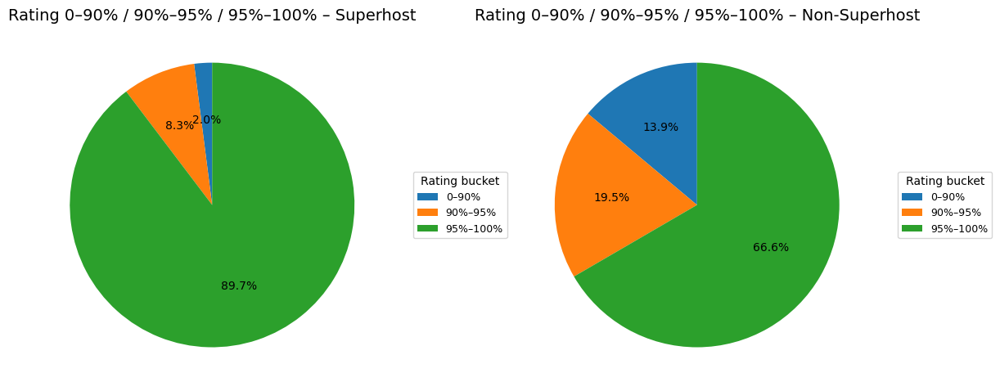

In [384]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)

share_table.columns.name = None

share_table = share_table[['Superhost', 'Non-Superhost']]

print("\nShare of listings in each rating bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))



#pie chart
pie_data = share_table.copy()   
sup_vals = pie_data['Superhost'].fillna(0).values
non_vals = pie_data['Non-Superhost'].fillna(0).values


sup_0_90   = sup_vals[0] + sup_vals[1]
sup_90_95  = sup_vals[2]
sup_95_100 = sup_vals[3]

non_0_90   = non_vals[0] + non_vals[1]
non_90_95  = non_vals[2]
non_95_100 = non_vals[3]


agg_share = pd.DataFrame({
    'Superhost':      [sup_0_90,   sup_90_95,   sup_95_100],
    'Non-Superhost':  [non_0_90,   non_90_95,   non_95_100],
}, index=['0–90%', '90%–95%', '95%–100%'])

labels_3    = agg_share.index.tolist()
sizes_super = agg_share['Superhost'].values
sizes_non   = agg_share['Non-Superhost'].values

def make_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_3,
        title='Rating bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

make_pie(axes[0], sizes_super, 'Rating 0–90% / 90%–95% / 95%–100% – Superhost')
make_pie(axes[1], sizes_non,   'Rating 0–90% / 90%–95% / 95%–100% – Non-Superhost')

plt.tight_layout()
plt.show()


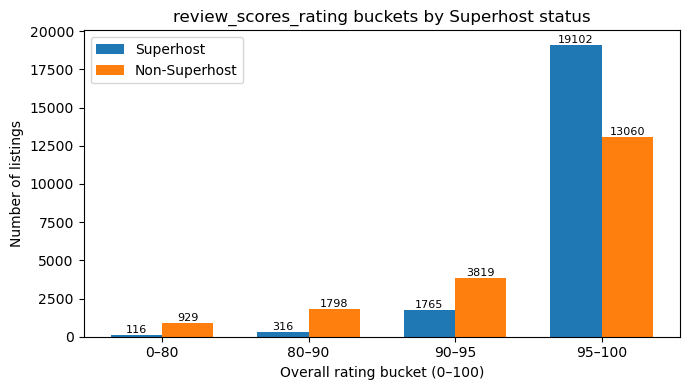

In [385]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals,  width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals,  width, label='Non-Superhost')

plt.xlabel('Overall rating bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_rating buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [386]:
report='''
Superhost's overall review ratings are significantly higher and more concentrated in the high-score range: the mean is 2.35 higher (97.80 vs 95.45), 
and the median is 0.8 points higher (98.40 vs 97.60); the percentage of ratings in the 95–100 range is 23.07 percentage points higher (89.68% vs 66.61%).

Key findings:

89.68% of Superhost's ratings are in the 95–100 range, compared to 66.61% for Non-Superhost.

The percentage of ratings in the low-score range is extremely small: only 2.02% for Superhost (0–90, 0.54% + 1.48%), 
and 13.91% for Non-Superhost (4.74% + 9.17%).

In the 90–95 score range, there are significantly more Non-Superhosts (19.48% vs 8.29%), 
indicating that they are generally stuck at the second-highest score for longer, struggling to surpass the 95-point threshold.

Higher central tendency:
Mean: 97.80 (SH) vs 95.45 (NSH), +2.35.Median: 98.40 (SH) vs 97.60 (NSH), +0.80.

This means that Superhosts are not just "more at the top," but rather that the overall level is rising.

Search Ranking and Conversion: Review ratings are a crucial indicator of ranking and click/booking rates; 
Superhosts have a higher density of ratings in the 95+ range, naturally gaining more exposure and trust.

Reputation: Non-Superhosts are largely clustered in the 90-95 range, 
indicating that a few negative reviews/experience fluctuations are enough to prevent them from reaching 95+; 
Superhosts are more resilient, less likely to drop out of the high-score range with small fluctuations.

To become a Superhost, prioritize raising your rating from 90-95 to 95+, as this yields the most marginal benefit.

Selection Bias: Hosts with low ratings may have already been delisted, creating a natural bias towards high-scoring hosts.

Heterogeneity: Location, price range, room type, and seasonal demand affect ratings; 
further comparisons can be made within comparable groups of the same city/price/room type to control confounding factors.

Time Dimension: It is recommended to add `last_review` and `reviews_per_month` metrics to differentiate.
'''
print(report)


Superhost's overall review ratings are significantly higher and more concentrated in the high-score range: the mean is 2.35 higher (97.80 vs 95.45), 
and the median is 0.8 points higher (98.40 vs 97.60); the percentage of ratings in the 95–100 range is 23.07 percentage points higher (89.68% vs 66.61%).

Key findings:

89.68% of Superhost's ratings are in the 95–100 range, compared to 66.61% for Non-Superhost.

The percentage of ratings in the low-score range is extremely small: only 2.02% for Superhost (0–90, 0.54% + 1.48%), 
and 13.91% for Non-Superhost (4.74% + 9.17%).

In the 90–95 score range, there are significantly more Non-Superhosts (19.48% vs 8.29%), 
indicating that they are generally stuck at the second-highest score for longer, struggling to surpass the 95-point threshold.

Higher central tendency:
Mean: 97.80 (SH) vs 95.45 (NSH), +2.35.Median: 98.40 (SH) vs 97.60 (NSH), +0.80.

This means that Superhosts are not just "more at the top," but rather that the overall level is

In [387]:
# review_scores_accuracy
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


acc_raw = pd.to_numeric(df['review_scores_accuracy'], errors='coerce')
max_val = acc_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['accuracy_pct'] = acc_raw * 20
elif pd.notna(max_val) and max_val <= 10.1:
    df['accuracy_pct'] = acc_raw * 10
else:
    df['accuracy_pct'] = acc_raw




summary_acc = (
    df.groupby('is_super')['accuracy_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_accuracy (0–100 scale):")
display(summary_acc.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_accuracy(group_df, group_name):
    r = group_df['accuracy_pct'].dropna()
    acc_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        acc_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_accuracy(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_accuracy(df[df['is_super'] == 0], 'Non-Superhost')

print("\nAccuracy buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nAccuracy buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)



Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_accuracy (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,605",95.95,98.00
Superhost,"21,299",98.03,98.60



Accuracy buckets among Superhosts:


,bucket,count,share
0,0–80,116,0.54%
1,80–90,274,1.29%
2,90–95,"1,267",5.95%
3,95–100,"19,642",92.22%



Accuracy buckets among Non-Superhosts:


,bucket,count,share
0,0–80,814,4.15%
1,80–90,"1,467",7.48%
2,90–95,"3,162",16.13%
3,95–100,"14,162",72.24%



Share of listings in each accuracy bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0–80,4.15%,0.54%
80–90,7.48%,1.29%
90–95,16.13%,5.95%
95–100,72.24%,92.22%


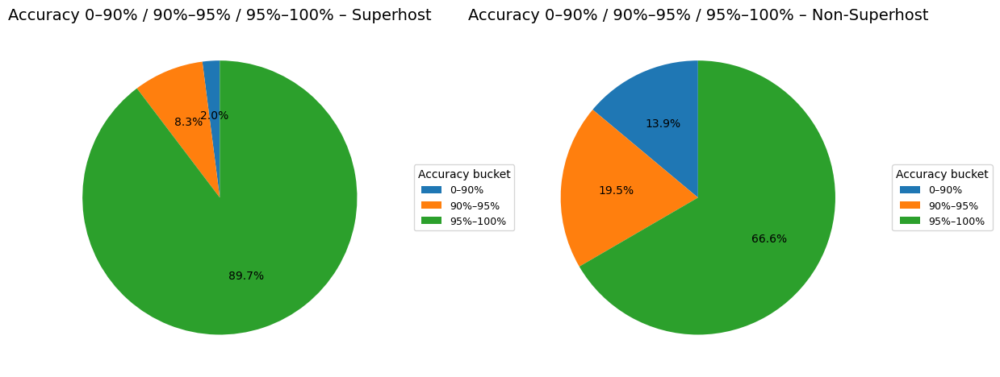

In [388]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each accuracy bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))


#pie chart
pie_data = share_table[['Superhost', 'Non-Superhost']].fillna(0)

sup_vals = pie_data['Superhost'].values
non_vals = pie_data['Non-Superhost'].values

sup_0_90   = sup_vals[0] + sup_vals[1]
sup_90_95  = sup_vals[2]
sup_95_100 = sup_vals[3]

non_0_90   = non_vals[0] + non_vals[1]
non_90_95  = non_vals[2]
non_95_100 = non_vals[3]

#chart
labels_3    = agg_share.index.tolist()
sizes_super = agg_share['Superhost'].values
sizes_non   = agg_share['Non-Superhost'].values

def make_pie_3(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_3,
        title='Accuracy bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

make_pie_3(axes[0], sizes_super, 'Accuracy 0–90% / 90%–95% / 95%–100% – Superhost')
make_pie_3(axes[1], sizes_non,   'Accuracy 0–90% / 90%–95% / 95%–100% – Non-Superhost')

plt.tight_layout()
plt.show()

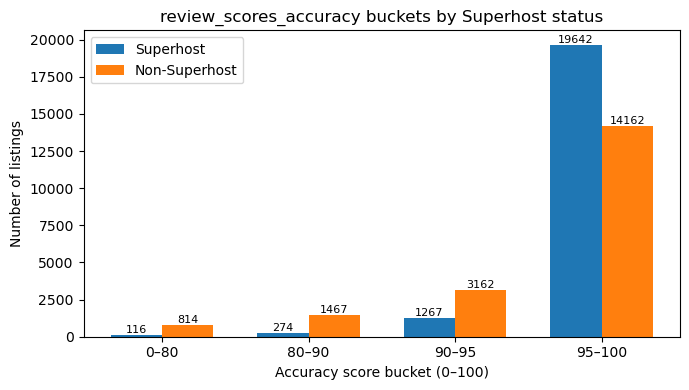

In [389]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Accuracy score bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_accuracy buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [390]:
report='''
Based on the overall statistics and distribution analysis of review scores accuracy, 
Superhost significantly outperforms in "consistency between check-in experience and property description.
Superhost's mean and median scores are 98.03 and 98.60, respectively, significantly higher than Non-superhost's (95.95 and 98.00). 
Bucket analysis shows that 92.22% of Superhost's listings are concentrated in the 95–100 high score range, compared to only 72.24% for Non-superhost. 

Furthermore, Non-superhost has a higher percentage of listings in the 90–95 and 0–90 low-to-mid score ranges 
(16.13% and 11.63%, respectively, compared to Superhost's 5.95% and 1.83%). 

This indicates that Superhost not only has a higher average score but also a larger proportion of consistently high scores, 
exhibiting a "high-score and concentrated" distribution characteristic.
'''
print(report)


Based on the overall statistics and distribution analysis of review scores accuracy, 
Superhost significantly outperforms in "consistency between check-in experience and property description.
Superhost's mean and median scores are 98.03 and 98.60, respectively, significantly higher than Non-superhost's (95.95 and 98.00). 
Bucket analysis shows that 92.22% of Superhost's listings are concentrated in the 95–100 high score range, compared to only 72.24% for Non-superhost. 

Furthermore, Non-superhost has a higher percentage of listings in the 90–95 and 0–90 low-to-mid score ranges 
(16.13% and 11.63%, respectively, compared to Superhost's 5.95% and 1.83%). 

This indicates that Superhost not only has a higher average score but also a larger proportion of consistently high scores, 
exhibiting a "high-score and concentrated" distribution characteristic.



In [391]:
#review_scores_cleanliness
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


clean_raw = pd.to_numeric(df['review_scores_cleanliness'], errors='coerce')
max_val = clean_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['cleanliness_pct'] = clean_raw * 20
elif pd.notna(max_val) and max_val <= 10.1:
    df['cleanliness_pct'] = clean_raw * 10
else:
    df['cleanliness_pct'] = clean_raw

summary_clean = (
    df.groupby('is_super')['cleanliness_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_cleanliness (0–100 scale):")
display(summary_clean.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))

bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_cleanliness(group_df, group_name):
    r = group_df['cleanliness_pct'].dropna()
    cl_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        cl_bucket.value_counts()
                 .reindex(labels, fill_value=0)
                 .rename_axis('bucket')
                 .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_cleanliness(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_cleanliness(df[df['is_super'] == 0], 'Non-Superhost')

print("\nCleanliness buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nCleanliness buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_cleanliness (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,606",95.11,97.60
Superhost,"21,299",97.70,98.60



Cleanliness buckets among Superhosts:


,bucket,count,share
0,0–80,121,0.57%
1,80–90,474,2.23%
2,90–95,"2,182",10.24%
3,95–100,"18,522",86.96%



Cleanliness buckets among Non-Superhosts:


,bucket,count,share
0,0–80,"1,077",5.49%
1,80–90,"2,120",10.81%
2,90–95,"3,603",18.38%
3,95–100,"12,806",65.32%



Share of listings in each cleanliness bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0–80,5.49%,0.57%
80–90,10.81%,2.23%
90–95,18.38%,10.24%
95–100,65.32%,86.96%


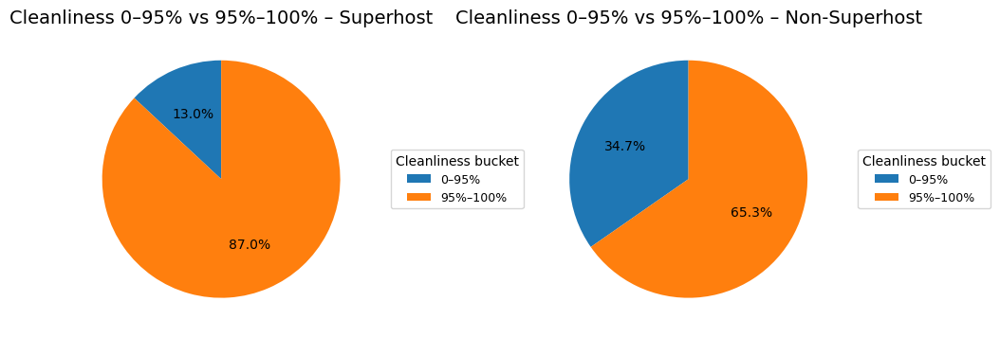

In [392]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each cleanliness bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))

#pie chart
low_bins  = ['0–80', '80–90', '90–95']   
high_bin  = '95–100'                     

sup_0_95   = sup_bucket.loc[sup_bucket['bucket'].isin(low_bins), 'share'].sum()
sup_95_100 = sup_bucket.loc[sup_bucket['bucket'] == high_bin, 'share'].sum()

non_0_95   = non_bucket.loc[non_bucket['bucket'].isin(low_bins), 'share'].sum()
non_95_100 = non_bucket.loc[non_bucket['bucket'] == high_bin, 'share'].sum()


agg_clean = pd.DataFrame(
    {'Superhost':     [sup_0_95,  sup_95_100],
        'Non-Superhost': [non_0_95,  non_95_100],},
    index=['0–95%', '95%–100%']
)

labels_2    = agg_clean.index.tolist()
sizes_super = agg_clean['Superhost'].values
sizes_non   = agg_clean['Non-Superhost'].values

def make_pie_0_95(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_2,
        title='Cleanliness bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_pie_0_95(axes[0], sizes_super, 'Cleanliness 0–95% vs 95%–100% – Superhost')
make_pie_0_95(axes[1], sizes_non,   'Cleanliness 0–95% vs 95%–100% – Non-Superhost')

plt.tight_layout()
plt.show()

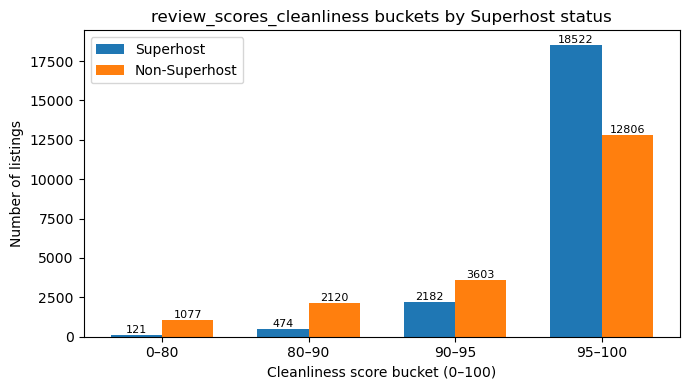

In [393]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Cleanliness score bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_cleanliness buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()

# add count labels on top
for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [394]:
report='''
Superhosts have materially higher cleanliness scores: mean 97.70 vs 95.11, median 98.60 vs 97.60.
The 95–100 bucket share is 86.96% (Superhost) vs 65.32% (Non-Superhost).
Low buckets (<90) are 2.80% for Superhosts vs 16.30% for Non-Superhosts.

Pies chart show Superhosts heavily concentrated in 95–100 (~87%), while Non-Superhosts still have ~35% in 0–95.
The summary table shows right-shifted central tendency for Superhosts and a much fatter top bucket.
Bar chart highlights the dominance of Superhosts in the 95–100 bucket and the mid-bucket mass for Non-Superhosts.
Pie Chart (0–95 vs 95–100): The 2-slice pies compress the story into “excellent vs not yet excellent,” great for execution slides.

Therefore, Cleanliness is a controllable strength: it is strongly correlated with Superhost status, 
and the cleanliness score is an important indicator for determining whether someone becomes a Superhost.

In summary: Superhosts almost always maintain a cleanliness level in the 95–100 range, 
while non-Superhosts have a much higher proportion of long-tail and mid-tier hosts. 
Standardizing the cleanliness process is a low-cost, high-return option for new hosts aiming for Superhost status.
'''
print(report)


Superhosts have materially higher cleanliness scores: mean 97.70 vs 95.11, median 98.60 vs 97.60.
The 95–100 bucket share is 86.96% (Superhost) vs 65.32% (Non-Superhost).
Low buckets (<90) are 2.80% for Superhosts vs 16.30% for Non-Superhosts.

Pies chart show Superhosts heavily concentrated in 95–100 (~87%), while Non-Superhosts still have ~35% in 0–95.
The summary table shows right-shifted central tendency for Superhosts and a much fatter top bucket.
Bar chart highlights the dominance of Superhosts in the 95–100 bucket and the mid-bucket mass for Non-Superhosts.
Pie Chart (0–95 vs 95–100): The 2-slice pies compress the story into “excellent vs not yet excellent,” great for execution slides.

Therefore, Cleanliness is a controllable strength: it is strongly correlated with Superhost status, 
and the cleanliness score is an important indicator for determining whether someone becomes a Superhost.

In summary: Superhosts almost always maintain a cleanliness level in the 95–100 range, 
w

In [395]:
#review_scores_checkin
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


check_raw = pd.to_numeric(df['review_scores_checkin'], errors='coerce')
max_val = check_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['checkin_pct'] = check_raw * 20
elif pd.notna(max_val) and max_val <= 10.1:
    df['checkin_pct'] = check_raw * 10
else:
    df['checkin_pct'] = check_raw


summary_checkin = (
    df.groupby('is_super')['checkin_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_checkin (0–100 scale):")
display(summary_checkin.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_checkin(group_df, group_name):
    r = group_df['checkin_pct'].dropna()
    ck_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        ck_bucket.value_counts()
                 .reindex(labels, fill_value=0)
                 .rename_axis('bucket')
                 .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_checkin(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_checkin(df[df['is_super'] == 0], 'Non-Superhost')

print("\nCheck-in score buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nCheck-in score buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_checkin (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,605",97.14,99.20
Superhost,"21,299",98.61,99.20



Check-in score buckets among Superhosts:


,bucket,count,share
0,0–80,71,0.33%
1,80–90,192,0.90%
2,90–95,728,3.42%
3,95–100,"20,308",95.35%



Check-in score buckets among Non-Superhosts:


,bucket,count,share
0,0–80,600,3.06%
1,80–90,892,4.55%
2,90–95,"1,864",9.51%
3,95–100,"16,249",82.88%



Share of listings in each check-in bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0–80,3.06%,0.33%
80–90,4.55%,0.90%
90–95,9.51%,3.42%
95–100,82.88%,95.35%


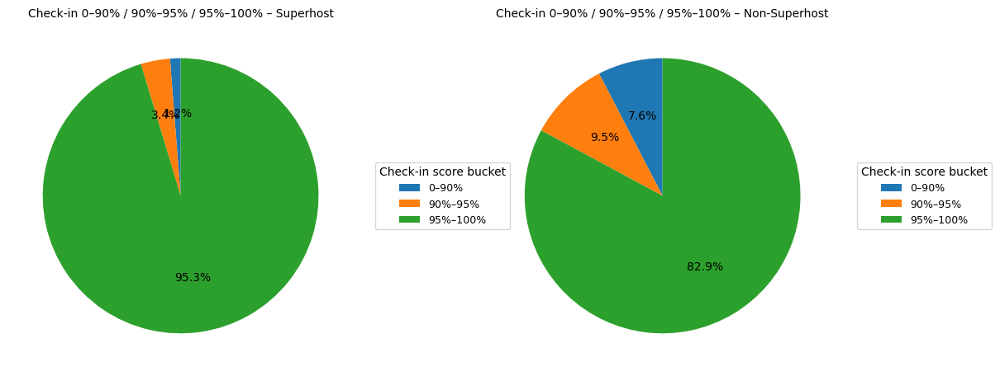

In [396]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each check-in bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))

# Pie chart
low_bins   = ['0–80', '80–90']   
mid_bin    = '90–95'
high_bin   = '95–100'

sup_0_90   = sup_bucket.loc[sup_bucket['bucket'].isin(low_bins), 'share'].sum()
sup_90_95  = sup_bucket.loc[sup_bucket['bucket'] == mid_bin, 'share'].sum()
sup_95_100 = sup_bucket.loc[sup_bucket['bucket'] == high_bin, 'share'].sum()

non_0_90   = non_bucket.loc[non_bucket['bucket'].isin(low_bins), 'share'].sum()
non_90_95  = non_bucket.loc[non_bucket['bucket'] == mid_bin, 'share'].sum()
non_95_100 = non_bucket.loc[non_bucket['bucket'] == high_bin, 'share'].sum()


agg_checkin = pd.DataFrame(
    {
        'Superhost':     [sup_0_90,  sup_90_95,  sup_95_100],
        'Non-Superhost': [non_0_90,  non_90_95,  non_95_100],
    },
    index=['0–90%', '90%–95%', '95%–100%']
)

labels_3    = agg_checkin.index.tolist()
sizes_super = agg_checkin['Superhost'].values
sizes_non   = agg_checkin['Non-Superhost'].values

def make_pie_3(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=10)
    ax.legend(
        wedges,
        labels_3,
        title='Check-in score bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

make_pie_3(axes[0], sizes_super, 'Check-in 0–90% / 90%–95% / 95%–100% – Superhost')
make_pie_3(axes[1], sizes_non,   'Check-in 0–90% / 90%–95% / 95%–100% – Non-Superhost')

plt.tight_layout()
plt.show()

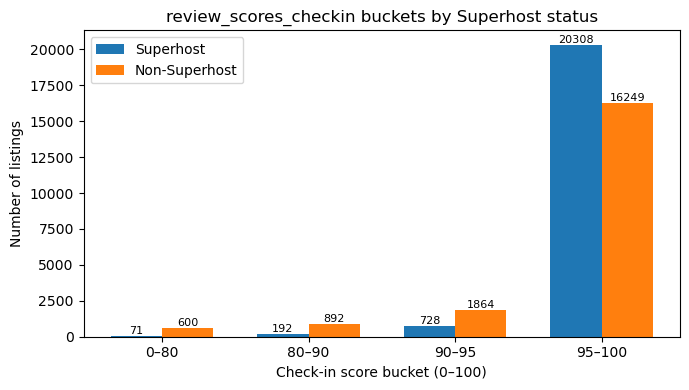

In [397]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Check-in score bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_checkin buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [398]:
report='''
Check-in Scores:

Superhost: Mean 98.61, Median 99.20; Non-superhost: Mean 97.14, Median 99.20. 
Both groups have a median of 99.2, but Superhost has a higher mean and a more concentrated distribution.

Distribution Comparison:
95–100: Superhost 95.35% vs Non-superhost 82.88% (12.5pp higher)
90–95: Superhost 3.42% vs Non-superhost 9.51%
80–90: Superhost 0.90% vs 4.55%
0–80: Superhost 0.33% vs 3.06%

Non-Superhost has a significantly longer percentage of scores below 95,
with the lower score range (≤90) being approximately 4–9 times higher than Superhost.

Bar Chart:

1. Superhost: 95–100 approximately 20,308, 90–95 728, 80–90 192, 0–80 71

2. Non-superhost: 95–100 16,249, 90–95 1,864, 80–90 892, 0–80 600

Low scores are mainly concentrated in Non-superhosts, and even more so in the 80–95 range.

Check-in scores are very important for new hosts.
Superhosts have significantly higher scores in the 95–100 range (95.35% vs 82.88%), while those ≤95 have significantly lower scores (4.65% vs 17.12%). 
This indicates that the guest check-in experience is one of the core indicators distinguishing Superhosts from Non-Superhosts.
'''
print(report)


Check-in Scores:

Superhost: Mean 98.61, Median 99.20; Non-superhost: Mean 97.14, Median 99.20. 
Both groups have a median of 99.2, but Superhost has a higher mean and a more concentrated distribution.

Distribution Comparison:
95–100: Superhost 95.35% vs Non-superhost 82.88% (12.5pp higher)
90–95: Superhost 3.42% vs Non-superhost 9.51%
80–90: Superhost 0.90% vs 4.55%
0–80: Superhost 0.33% vs 3.06%

Non-Superhost has a significantly longer percentage of scores below 95,
with the lower score range (≤90) being approximately 4–9 times higher than Superhost.

Bar Chart:

1. Superhost: 95–100 approximately 20,308, 90–95 728, 80–90 192, 0–80 71

2. Non-superhost: 95–100 16,249, 90–95 1,864, 80–90 892, 0–80 600

Low scores are mainly concentrated in Non-superhosts, and even more so in the 80–95 range.

Check-in scores are very important for new hosts.
Superhosts have significantly higher scores in the 95–100 range (95.35% vs 82.88%), while those ≤95 have significantly lower scores (4.65% vs 

In [399]:
#review_scores_communication
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


comm_raw = pd.to_numeric(df['review_scores_communication'], errors='coerce')
max_val = comm_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['comm_pct'] = comm_raw * 20
elif pd.notna(max_val) and max_val <= 10.1:
    df['comm_pct'] = comm_raw * 10
else:
    # already 0–100
    df['comm_pct'] = comm_raw



summary_comm = (
    df.groupby('is_super')['comm_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_communication (0–100 scale):")
display(summary_comm.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_comm(group_df, group_name):
    r = group_df['comm_pct'].dropna()
    cm_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        cm_bucket.value_counts()
                 .reindex(labels, fill_value=0)
                 .rename_axis('bucket')
                 .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_comm(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_comm(df[df['is_super'] == 0], 'Non-Superhost')

print("\nCommunication score buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nCommunication score buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_communication (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,605",97.13,99.20
Superhost,"21,299",98.75,99.40



Communication score buckets among Superhosts:


,bucket,count,share
0,0–80,62,0.29%
1,80–90,149,0.70%
2,90–95,603,2.83%
3,95–100,"20,485",96.18%



Communication score buckets among Non-Superhosts:


,bucket,count,share
0,0–80,593,3.02%
1,80–90,880,4.49%
2,90–95,"1,822",9.29%
3,95–100,"16,310",83.19%



Share of listings in each communication bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0–80,3.02%,0.29%
80–90,4.49%,0.70%
90–95,9.29%,2.83%
95–100,83.19%,96.18%


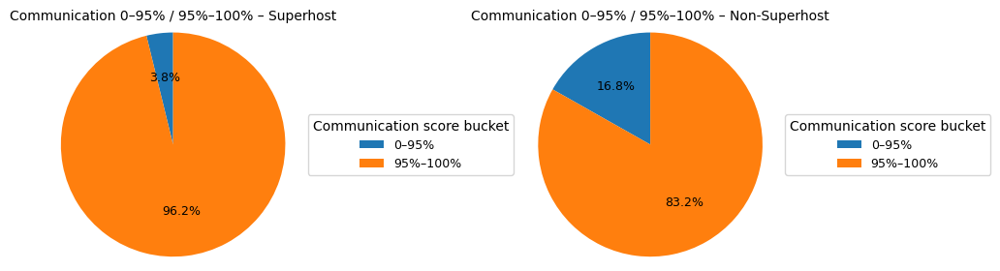

In [400]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each communication bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))


# Pie chart
low_bins = ['0–80', '80–90', '90–95']
high_bin = '95–100'

sup_0_95   = sup_bucket.loc[sup_bucket['bucket'].isin(low_bins), 'share'].sum()
sup_95_100 = sup_bucket.loc[sup_bucket['bucket'] == high_bin, 'share'].sum()

non_0_95   = non_bucket.loc[non_bucket['bucket'].isin(low_bins), 'share'].sum()
non_95_100 = non_bucket.loc[non_bucket['bucket'] == high_bin, 'share'].sum()


agg_comm = pd.DataFrame(
    {
        'Superhost':     [sup_0_95,  sup_95_100],
        'Non-Superhost': [non_0_95,  non_95_100],
    },
    index=['0–95%', '95%–100%']
)

labels_2    = agg_comm.index.tolist()
sizes_super = agg_comm['Superhost'].values
sizes_non   = agg_comm['Non-Superhost'].values

def make_pie_2(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 9},
        radius=1.2
    )
    ax.set_title(title, fontsize=10)
    ax.legend(
        wedges,
        labels_2,
        title='Communication score bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_pie_2(axes[0], sizes_super, 'Communication 0–95% / 95%–100% – Superhost')
make_pie_2(axes[1], sizes_non,   'Communication 0–95% / 95%–100% – Non-Superhost')

plt.tight_layout()
plt.show()

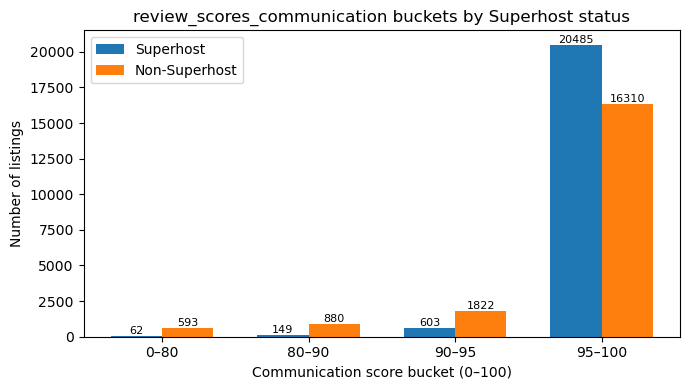

In [401]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Communication score bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_communication buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [402]:
report='''
Based on 47,097 listings (22,091 Superhosts; 23,900 Non-Superhosts), 
communication ratings on a 0–100 scale are highly discriminative for Superhosts: the mean rating for Superhosts is 98.75, and the median is 99.40; 
for Non-Superhosts, the mean rating is 97.13, and the median is 99.20. 

In terms of distribution, ratings ≥95 account for 96.18% of Superhosts vs. 83.19% of Non-Superhosts (a difference of approximately 13%); 
ratings <95 account for 3.82% vs. 16.81%.

Specific ranges: 0–80: 0.29% vs. 3.02%; 80–90: 0.70% vs. 4.49%; 90–95: 2.83% vs. 9.29%.
Based on the relative advantage estimate of "≥95 points", Superhost has an advantage of approximately 25.2,
while Non-Superhost has an advantage of approximately 4.95, with an advantage ratio of ≈ 5.1. 
This means that a high communication score (≥95) has a significant impact on becoming a Superhost.

Overall, the communication score reflects both the quality of host interaction and is linked to the platform's professionalism, 
making it one of the key indicators among interaction factors.
'''
print(report)


Based on 47,097 listings (22,091 Superhosts; 23,900 Non-Superhosts), 
communication ratings on a 0–100 scale are highly discriminative for Superhosts: the mean rating for Superhosts is 98.75, and the median is 99.40; 
for Non-Superhosts, the mean rating is 97.13, and the median is 99.20. 

In terms of distribution, ratings ≥95 account for 96.18% of Superhosts vs. 83.19% of Non-Superhosts (a difference of approximately 13%); 
ratings <95 account for 3.82% vs. 16.81%.

Specific ranges: 0–80: 0.29% vs. 3.02%; 80–90: 0.70% vs. 4.49%; 90–95: 2.83% vs. 9.29%.
Based on the relative advantage estimate of "≥95 points", Superhost has an advantage of approximately 25.2,
while Non-Superhost has an advantage of approximately 4.95, with an advantage ratio of ≈ 5.1. 
This means that a high communication score (≥95) has a significant impact on becoming a Superhost.

Overall, the communication score reflects both the quality of host interaction and is linked to the platform's professionalism, 
making 

In [403]:
#review_scores_location
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


loc_raw = pd.to_numeric(df['review_scores_location'], errors='coerce')
max_val = loc_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['location_pct'] = loc_raw * 20
elif pd.notna(max_val) and max_val <= 10.1:
    df['location_pct'] = loc_raw * 10
else:
    df['location_pct'] = loc_raw

summary_loc = (
    df.groupby('is_super')['location_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_location (0–100 scale):")
display(summary_loc.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_location(group_df, group_name):
    r = group_df['location_pct'].dropna()
    loc_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        loc_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_location(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_location(df[df['is_super'] == 0], 'Non-Superhost')

print("\nLocation score buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nLocation score buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_location (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,605",96.85,98.40
Superhost,"21,299",97.82,98.40



Location score buckets among Superhosts:


,bucket,count,share
0,0–80,80,0.38%
1,80–90,251,1.18%
2,90–95,"1,607",7.54%
3,95–100,"19,361",90.90%



Location score buckets among Non-Superhosts:


,bucket,count,share
0,0–80,505,2.58%
1,80–90,"1,019",5.20%
2,90–95,"2,685",13.70%
3,95–100,"15,396",78.53%



Share of listings in each location bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0–80,2.58%,0.38%
80–90,5.20%,1.18%
90–95,13.70%,7.54%
95–100,78.53%,90.90%


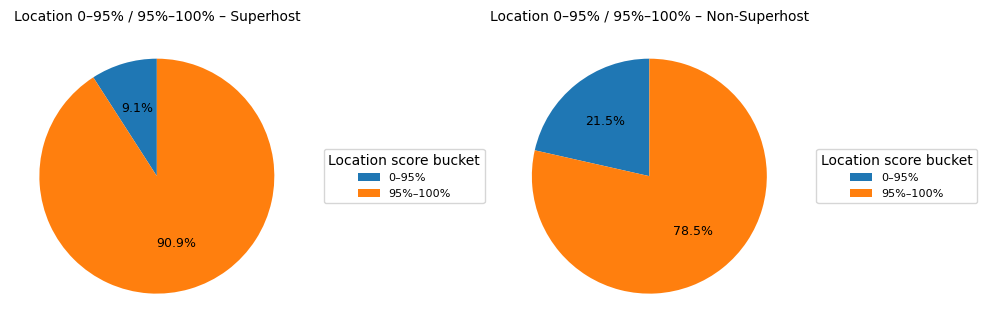

In [404]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each location bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))


#Pie chart
low_bins  = ['0–80', '80–90', '90–95']
high_bin  = '95–100'

sup_0_95   = sup_bucket.loc[sup_bucket['bucket'].isin(low_bins), 'share'].sum()
sup_95_100 = sup_bucket.loc[sup_bucket['bucket'] == high_bin, 'share'].sum()

non_0_95   = non_bucket.loc[non_bucket['bucket'].isin(low_bins), 'share'].sum()
non_95_100 = non_bucket.loc[non_bucket['bucket'] == high_bin, 'share'].sum()


agg_loc = pd.DataFrame(
    {
        'Superhost':     [sup_0_95,  sup_95_100],
        'Non-Superhost': [non_0_95,  non_95_100],
    },
    index=['0–95%', '95%–100%']
)

labels_2    = agg_loc.index.tolist()
sizes_super = agg_loc['Superhost'].values
sizes_non   = agg_loc['Non-Superhost'].values

def make_loc_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 9},
        radius=1
    )
    ax.set_title(title, fontsize=10)
    ax.legend(
        wedges,
        labels_2,
        title='Location score bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=8
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_loc_pie(axes[0], sizes_super, 'Location 0–95% / 95%–100% – Superhost')
make_loc_pie(axes[1], sizes_non,   'Location 0–95% / 95%–100% – Non-Superhost')

plt.tight_layout()
plt.show()

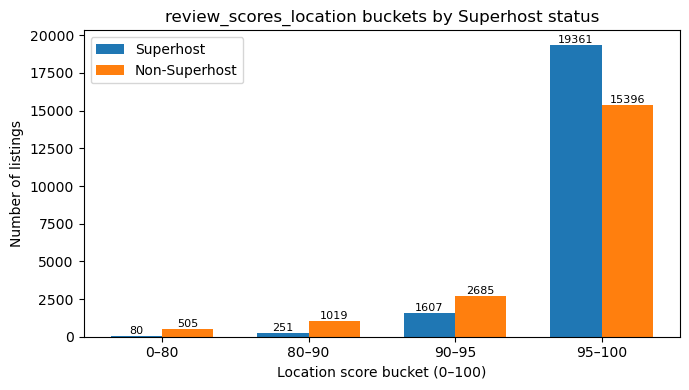

In [405]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Location score bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_location buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [406]:
report='''
The data shows that Superhosts have a significantly higher percentage (90.90%) in the 95–100 score range than Non-Superhosts (78.53%), 
while the percentage in the lower score range (≤95) is significantly lower (9.10% vs 21.47%). 
This indicates a strong correlation between high location scores and becoming a Superhost, 
serving as a stable characteristic for differentiating high-performing listings. 

However, location scores are more influenced by geography and surrounding resources, making them less controllable.
They are more suitable as a control variable than a factor that can be directly modified in the short-term operations of a new host.
'''
print(report)


The data shows that Superhosts have a significantly higher percentage (90.90%) in the 95–100 score range than Non-Superhosts (78.53%), 
while the percentage in the lower score range (≤95) is significantly lower (9.10% vs 21.47%). 
This indicates a strong correlation between high location scores and becoming a Superhost, 
serving as a stable characteristic for differentiating high-performing listings. 

However, location scores are more influenced by geography and surrounding resources, making them less controllable.
They are more suitable as a control variable than a factor that can be directly modified in the short-term operations of a new host.



In [407]:
#review_scores_value
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


val_raw = pd.to_numeric(df['review_scores_value'], errors='coerce')
max_val = val_raw.max()

if pd.notna(max_val) and max_val <= 5.1:
    df['value_pct'] = val_raw * 20
elif pd.notna(max_val) and max_val <= 10.1:
    df['value_pct'] = val_raw * 10
else:
    df['value_pct'] = val_raw


summary_value = (
    df.groupby('is_super')['value_pct']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of review_scores_value (0–100 scale):")
display(summary_value.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 80, 90, 95, 100]
labels = ['0–80', '80–90', '90–95', '95–100']

def bucket_value(group_df, group_name):
    r = group_df['value_pct'].dropna()
    val_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=True
    )

    bucket_counts = (
        val_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_value(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_value(df[df['is_super'] == 0], 'Non-Superhost')

print("\nValue score buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nValue score buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of review_scores_value (0–100 scale):


,count,mean,median
is_super,,,
Non-Superhost,"19,605",93.73,95.60
Superhost,"21,299",96.25,97.00



Value score buckets among Superhosts:


,bucket,count,share
0,0–80,236,1.11%
1,80–90,847,3.98%
2,90–95,"4,398",20.65%
3,95–100,"15,818",74.27%



Value score buckets among Non-Superhosts:


,bucket,count,share
0,0–80,"1,391",7.10%
1,80–90,"2,763",14.09%
2,90–95,"5,057",25.79%
3,95–100,"10,394",53.02%



Share of listings in each value bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0–80,7.10%,1.11%
80–90,14.09%,3.98%
90–95,25.79%,20.65%
95–100,53.02%,74.27%


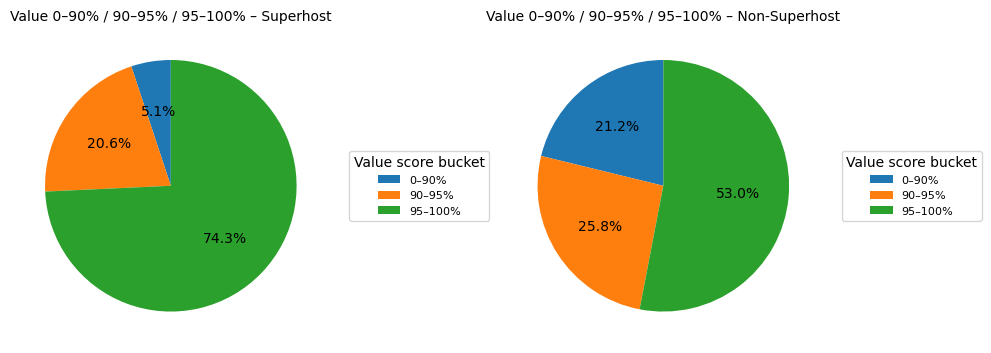

In [408]:
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each value bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))

#Pie chart
low_bins  = ['0–80', '80–90']   
mid_bin   = '90–95'             
high_bin  = '95–100'            

sup_0_90   = sup_bucket.loc[sup_bucket['bucket'].isin(low_bins), 'share'].sum()
sup_90_95  = sup_bucket.loc[sup_bucket['bucket'] == mid_bin, 'share'].sum()
sup_95_100 = sup_bucket.loc[sup_bucket['bucket'] == high_bin, 'share'].sum()

non_0_90   = non_bucket.loc[non_bucket['bucket'].isin(low_bins), 'share'].sum()
non_90_95  = non_bucket.loc[non_bucket['bucket'] == mid_bin, 'share'].sum()
non_95_100 = non_bucket.loc[non_bucket['bucket'] == high_bin, 'share'].sum()


agg_value = pd.DataFrame(
    {
        'Superhost':     [sup_0_90,  sup_90_95,  sup_95_100],
        'Non-Superhost': [non_0_90,  non_90_95,  non_95_100],
    },
    index=['0–90%', '90–95%', '95–100%']
)

labels_3    = agg_value.index.tolist()              
sizes_super = agg_value['Superhost'].values
sizes_non   = agg_value['Non-Superhost'].values

def make_value_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',          
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=10)
    ax.legend(
        wedges,
        labels_3,                   
        title='Value score bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=8
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_value_pie(axes[0], sizes_super, 'Value 0–90% / 90–95% / 95–100% – Superhost')
make_value_pie(axes[1], sizes_non,   'Value 0–90% / 90–95% / 95–100% – Non-Superhost')

plt.tight_layout()
plt.show()

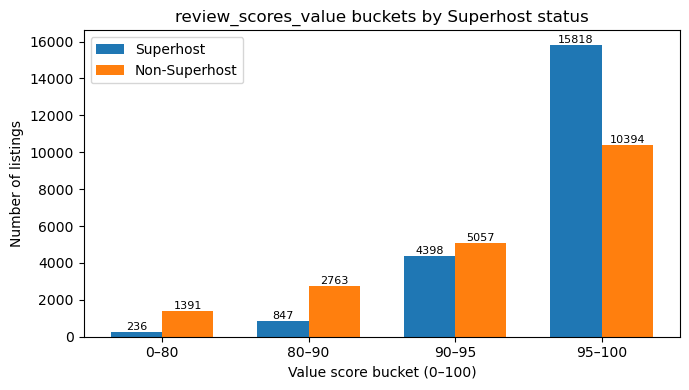

In [409]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Value score bucket (0–100)')
plt.ylabel('Number of listings')
plt.title('review_scores_value buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [410]:
report='''
Overall Value Scores: 
Superhosts: 21,299 listings; Non-Superhosts: 19,605 listings
Mean Score: 96.25 (Superhost) vs 93.73 (Non-Superhost)
Median: 97.00 (Superhost) vs 95.60 (Non-Superhost)

Bar Chart:
0–80: 236 (Superhost) vs 1,391 (Non-Superhost)
80–90: 847 vs 2,763
90–95: 4,398 vs 5,057
95–100: 15,818 vs 10,394

Pie Chart:
Superhost: 0–90 5.1%｜90–95 20.6%｜95–100 74.3%
Non-Superhost: 0–90 21.2% | 90–95 25.8% | 95–100 53.0%

Key Comparisons:
Difference in percentage of high-scoring users (95–100): 74.3% (SH) – 53.0% (NSH) (Superhost is more concentrated at the top).
Difference in percentage of low-scoring users (≤90): 5.1% (SH) – 21.2% (NSH) (Superhost has fewer low-scoring users).
Superhost's mean/median score is 2.52/1.40 points higher.
Conclusion: Superhost is significantly better overall in terms of "value for money": 21.3% more guests scored high (95–100), 
and 16.1% fewer scored low (≤90); its mean score of 96.25 and median score of 97.00 are also higher than non-Superhost (93.73 / 95.60). 
This indicates that Superhost is more consistent and closer to the perfect score range in guests' perception of whether the cost matches the experience.
This indicator has only a moderate impact.
'''
print(report)


Overall Value Scores: 
Superhosts: 21,299 listings; Non-Superhosts: 19,605 listings
Mean Score: 96.25 (Superhost) vs 93.73 (Non-Superhost)
Median: 97.00 (Superhost) vs 95.60 (Non-Superhost)

Bar Chart:
0–80: 236 (Superhost) vs 1,391 (Non-Superhost)
80–90: 847 vs 2,763
90–95: 4,398 vs 5,057
95–100: 15,818 vs 10,394

Pie Chart:
Superhost: 0–90 5.1%｜90–95 20.6%｜95–100 74.3%
Non-Superhost: 0–90 21.2% | 90–95 25.8% | 95–100 53.0%

Key Comparisons:
Difference in percentage of high-scoring users (95–100): 74.3% (SH) – 53.0% (NSH) (Superhost is more concentrated at the top).
Difference in percentage of low-scoring users (≤90): 5.1% (SH) – 21.2% (NSH) (Superhost has fewer low-scoring users).
Superhost's mean/median score is 2.52/1.40 points higher.
Conclusion: Superhost is significantly better overall in terms of "value for money": 21.3% more guests scored high (95–100), 
and 16.1% fewer scored low (≤90); its mean score of 96.25 and median score of 97.00 are also higher than non-Superhost (93.

In [411]:
from scipy import stats

# Superhost
df = df.copy()
if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost'].astype(str).str.strip().str.lower()
          .map({'t':1,'true':1,'1':1,'f':0,'false':0,'0':0}).astype('Int8')
    )


score_cols = [
    'review_scores_rating',         
    'review_scores_accuracy',       
    'review_scores_cleanliness',    
    'review_scores_checkin',        
    'review_scores_communication',  
    'review_scores_location',       
    'review_scores_value',          
]


def to_100_scale(s: pd.Series) -> pd.Series:
    r = pd.to_numeric(s, errors='coerce')
    mx = r.max()
    if pd.isna(mx):
        return r
    if mx <= 5.1:   
        return r * 20
    if mx <= 10.1:  
        return r * 10
    return r        

# Welch t-test 
def welch_ttest(x, g):
    """x: Series；g: (1=Superhost, 0=Non)"""
    a = x[g==1].dropna().astype(float)
    b = x[g==0].dropna().astype(float)
    n1, n0 = len(a), len(b)
    m1, m0 = a.mean(), b.mean()
    s1, s0 = a.var(ddof=1), b.var(ddof=1)
   
    # t/df (Welch)
    se = np.sqrt(s1/n1 + s0/n0)
    t = (m1 - m0) / se
    df_w = (s1/n1 + s0/n0)**2 / ((s1**2)/((n1**2)*(n1-1)) + (s0**2)/((n0**2)*(n0-1)))
    p = 2*stats.t.sf(np.abs(t), df_w)

    # 均值差 CI
    alpha = 0.05
    tcrit = stats.t.ppf(1 - alpha/2, df_w)
    diff = m1 - m0
    ci_low, ci_high = diff - tcrit*se, diff + tcrit*se

    # Cohen's d（pooled SD） Hedges' g
    sp = np.sqrt(((n1-1)*s1 + (n0-1)*s0) / (n1 + n0 - 2))
    d = diff / sp if sp > 0 else np.nan
    J = 1 - 3/(4*(n1+n0)-9)            # Hedges g 
    g_eff = J * d

    return {
        'n_super': n1, 'n_non': n0,
        'mean_super': m1, 'mean_non': m0, 'diff(SH-NSH)': diff,
        't': t, 'df': df_w, 'p': p,
        'ci_low': ci_low, 'ci_high': ci_high,
        "cohen_d": d, "hedges_g": g_eff
    }


rows = []
for col in score_cols:
    x100 = to_100_scale(df[col])
    res = welch_ttest(x100, df['is_super'])
    res['metric'] = col
    rows.append(res)

out = pd.DataFrame(rows)

# Benjamini–Hochberg (FDR) 
p = out['p'].values
m = len(p)
order = np.argsort(p)
rank = np.empty_like(order)
rank[order] = np.arange(1, m+1)
p_bh = p * m / rank
# BH 
p_bh_sorted = np.minimum.accumulate(np.sort(p_bh)[::-1])[::-1]
p_bh_final = np.empty_like(p_bh_sorted)
p_bh_final[order] = p_bh_sorted
out['p_FDR_BH'] = np.clip(p_bh_final, 0, 1)


show = (out
    .loc[:, ['metric','n_super','n_non','mean_super','mean_non','diff(SH-NSH)',
             't','df','p','p_FDR_BH','ci_low','ci_high','cohen_d','hedges_g']]
    .sort_values('p_FDR_BH')
)
pd.set_option('display.float_format', lambda v: f"{v:,.4f}")
print("Welch t-test: Superhost vs Non-Superhost")
display(show)

Welch t-test: Superhost vs Non-Superhost


,metric,n_super,n_non,mean_super,mean_non,diff(SH-NSH),t,df,p,p_FDR_BH,ci_low,ci_high,cohen_d,hedges_g
0,review_scores_rating,21299,19606,97.7993,95.4511,2.3481,43.8067,"25,338.0763",0.0000,0.0000,2.2431,2.4532,0.4467,0.4467
1,review_scores_accuracy,21299,19605,98.0314,95.9475,2.0839,39.5454,"26,044.8221",0.0000,0.0000,1.9806,2.1871,0.4028,0.4028
2,review_scores_cleanliness,21299,19606,97.7043,95.1130,2.5913,44.8630,"25,908.2452",0.0000,0.0000,2.4781,2.7045,0.4570,0.4570
6,review_scores_value,21299,19605,96.2516,93.7276,2.5240,40.5597,"27,506.2220",0.0000,0.0000,2.4021,2.6460,0.4121,0.4121
4,review_scores_communication,21299,19605,98.7535,97.1254,1.6282,33.8539,"24,624.8069",0.0000,0.0000,1.5339,1.7224,0.3457,0.3457
3,review_scores_checkin,21299,19605,98.6052,97.1406,1.4646,30.3113,"25,864.0741",0.0000,0.0000,1.3699,1.5593,0.3088,0.3088
5,review_scores_location,21299,19605,97.8230,96.8542,0.9687,23.4653,"27,906.5955",0.0000,0.0000,0.8878,1.0497,0.2382,0.2382


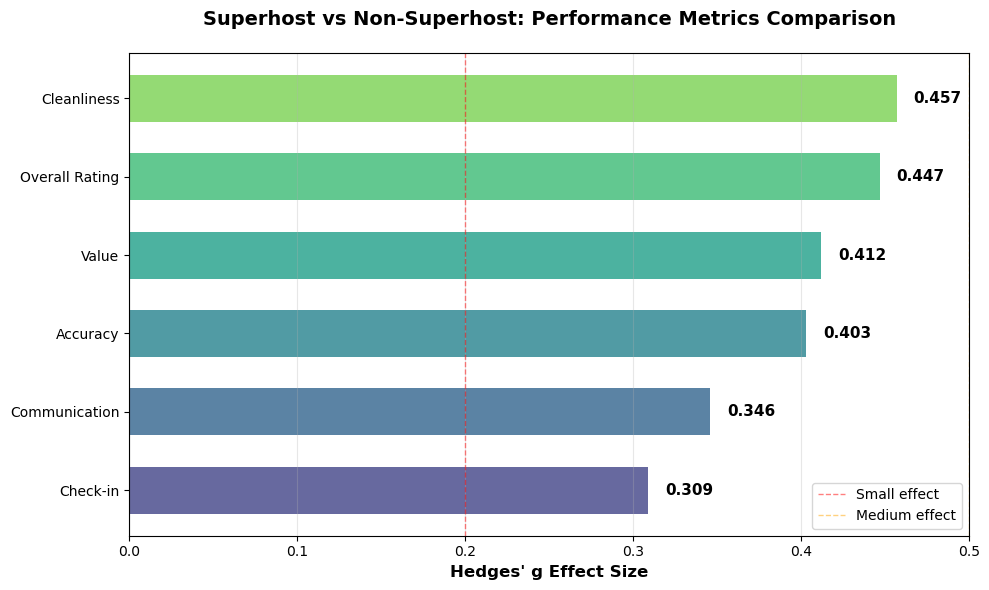

In [412]:
def create_clean_effect_size_plot():
  
    plt.rcParams['font.family'] = 'DejaVu Sans'
    plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
    
    
    data = {
        'Metric': ['Check-in', 'Communication', 'Accuracy', 'Value', 'Overall Rating', 'Cleanliness'],
        'Effect_Size': [0.309, 0.346, 0.403, 0.412, 0.447, 0.457]
    }
    df = pd.DataFrame(data)
    
   
    fig, ax = plt.subplots(figsize=(10, 6))
    
   
    df = df.sort_values('Effect_Size', ascending=True)
    
    
    colors = plt.cm.viridis(np.linspace(0.2, 0.8, len(df)))
    bars = ax.barh(df['Metric'], df['Effect_Size'], color=colors, alpha=0.8, height=0.6)
    
   
    for bar, value in zip(bars, df['Effect_Size']):
        ax.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height()/2, 
                f'{value:.3f}', ha='left', va='center', fontsize=11, fontweight='bold')
    
    
    ax.set_xlabel("Hedges' g Effect Size", fontsize=12, fontweight='bold')
    ax.set_title("Superhost vs Non-Superhost: Performance Metrics Comparison", 
                 fontsize=14, fontweight='bold', pad=20)
    
    
    ax.grid(True, alpha=0.3, axis='x')
    ax.axvline(x=0, color='black', linestyle='-', alpha=0.3)
    ax.axvline(x=0.2, color='red', linestyle='--', alpha=0.5, linewidth=1, label='Small effect')
    ax.axvline(x=0.5, color='orange', linestyle='--', alpha=0.5, linewidth=1, label='Medium effect')
    
   
    ax.set_xlim(0, 0.5)
    ax.set_xticks(np.arange(0, 0.51, 0.1))
    
    
    ax.legend(loc='lower right')
    
    
    plt.tight_layout()
    plt.show()
    
    return df
if __name__ == "__main__":
    results = create_clean_effect_size_plot()

In [413]:
report='''
We compare Superhosts vs Non-Superhosts using Welch’s t-tests on six review metrics. 
All differences remain statistically significant after Benjamini–Hochberg FDR correction (p < 0.001). 
We report the mean difference (Super − Non) with 95% CI and Hedges’ g (standardized effect size).

Results (ranked by effect size g):
Cleanliness:(95% CI 2.48–2.70), g = 0.457 → largest, medium effect.
Overall rating: (2.24–2.45), g = 0.447, medium.
Value: (2.40–2.65), g = 0.412, medium.
Accuracy: (1.98–2.19), g = 0.403, medium.
Communication: (1.53–1.72), g = 0.346, small–medium.
Check-in: (1.37–1.56), g = 0.309, small–medium.
Location :(0.89–1.05), g = 0.238, small and less controllable.


All six metrics are significantly higher for Superhosts; four of them reach medium effects (Cleanliness, Overall, Value, Accuracy).

Cleanliness shows the largest practical gap (g≈0.46): standardizing cleaning SOPs is the most actionable lever.

Overall/Accuracy reflect expectation alignment; Value indicates better price-to-experience perception—all with medium effects.

Communication/Check-in remain significant but with smaller effects; they are still worth fixing but come after cleanliness/accuracy/value.

Location differs statistically yet has small effect and low controllability → treat mainly as a control variable when benchmarking.
'''
print(report)



We compare Superhosts vs Non-Superhosts using Welch’s t-tests on six review metrics. 
All differences remain statistically significant after Benjamini–Hochberg FDR correction (p < 0.001). 
We report the mean difference (Super − Non) with 95% CI and Hedges’ g (standardized effect size).

Results (ranked by effect size g):
Cleanliness:(95% CI 2.48–2.70), g = 0.457 → largest, medium effect.
Overall rating: (2.24–2.45), g = 0.447, medium.
Value: (2.40–2.65), g = 0.412, medium.
Accuracy: (1.98–2.19), g = 0.403, medium.
Communication: (1.53–1.72), g = 0.346, small–medium.
Check-in: (1.37–1.56), g = 0.309, small–medium.
Location :(0.89–1.05), g = 0.238, small and less controllable.


All six metrics are significantly higher for Superhosts; four of them reach medium effects (Cleanliness, Overall, Value, Accuracy).

Cleanliness shows the largest practical gap (g≈0.46): standardizing cleaning SOPs is the most actionable lever.

Overall/Accuracy reflect expectation alignment; Value indicates bet

In [414]:
#host_listing count
d = df.copy()
if 'is_super' not in d.columns:
    d['is_super'] = (
        d['host_is_superhost']
          .astype(str).str.strip().str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

# Function to detect columns
def _detect_col(columns, candidates):
    lower = {c.lower(): c for c in columns}
    for cand in candidates:
        if cand.lower() in lower:
            return lower[cand.lower()]
    for c in columns:  # fallback
        cl = c.lower().replace("_","")
        for cand in candidates:
            if cand.lower().replace("_","") in cl:
                return c
    return None

HOST    = _detect_col(d.columns, ["host_id","hostid","host_id_str"])
LISTING = _detect_col(d.columns, ["id","listing_id","listingid"])

assert HOST is not None, "no find host id"
assert LISTING is not None, "no find listing id"

# Marking superhosts
host_flag = (
    d.groupby(HOST)['is_super'].max()
      .rename('host_is_super').astype('Int8')
)

# Count the unique listings per host
host_listings = (
    d.groupby(HOST)[LISTING].nunique()
      .rename('n_listings').astype(int)
)

host_df = pd.concat([host_flag, host_listings], axis=1).reset_index()

# Bucketize listing counts into 1, 2–3, 4–5, 6–10, 10+
def bucketize(n: int) -> str:
    if pd.isna(n):
        return "NA"
    n = int(n)
    if n <= 1:   return "1"
    if n == 2:   return "2"
    if n == 3:   return "3"
    if n == 4:   return "4"
    if n == 5:   return "5"
    if n == 6:   return "6"
    if n == 7:   return "7"
    if n == 8:   return "8"
    if n == 9:   return "9"
    if n == 10:  return "10"
    return "10+"

order = ["1","2","3","4","5","6","7","8","9","10","10+"]  # 用于 reindex/作图刻度一致

host_df['bucket'] = host_df['n_listings'].map(bucketize)


# Function to count the frequency of each bucket
def bucket_table(g, gname):
    ct = (g['bucket'].value_counts()
          .reindex(order, fill_value=0)
          .rename_axis('bucket')
          .to_frame(name='count')
          .reset_index())
    total = ct['count'].sum()
    ct['share'] = ct['count'] / total if total > 0 else 0
    ct['group'] = gname
    return ct

# Superhost and Non-Superhost bucket counts
sup_bucket = bucket_table(host_df[host_df['host_is_super'] == 1], 'Superhost')
non_bucket = bucket_table(host_df[host_df['host_is_super'] == 0], 'Non-Superhost')

# Display tables for Superhost and Non-Superhost bucket counts
print("\nHost listing count buckets — Superhost (per host):")
display(sup_bucket[['bucket', 'count', 'share']].style.format({'count': '{:,.0f}', 'share': '{:.2%}'}))

print("\nHost listing count buckets — Non-Superhost (per host):")
display(non_bucket[['bucket', 'count', 'share']].style.format({'count': '{:,.0f}', 'share': '{:.2%}'}))


Host listing count buckets — Superhost (per host):


,bucket,count,share
0,1,"9,474",76.56%
1,2,"1,705",13.78%
2,3,538,4.35%
3,4,213,1.72%
4,5,108,0.87%
5,6,76,0.61%
6,7,41,0.33%
7,8,34,0.27%
8,9,18,0.15%
9,10,15,0.12%



Host listing count buckets — Non-Superhost (per host):


,bucket,count,share
0,1,"12,713",84.06%
1,2,"1,398",9.24%
2,3,439,2.90%
3,4,188,1.24%
4,5,106,0.70%
5,6,69,0.46%
6,7,46,0.30%
7,8,19,0.13%
8,9,25,0.17%
9,10,16,0.11%



Share of hosts in each listing-count bucket (Superhost vs Non-Superhost):


,Superhost,Non-Superhost
1,76.56%,84.06%
2–3,18.13%,12.15%
4–5,2.59%,1.94%
6–10+,2.72%,1.85%


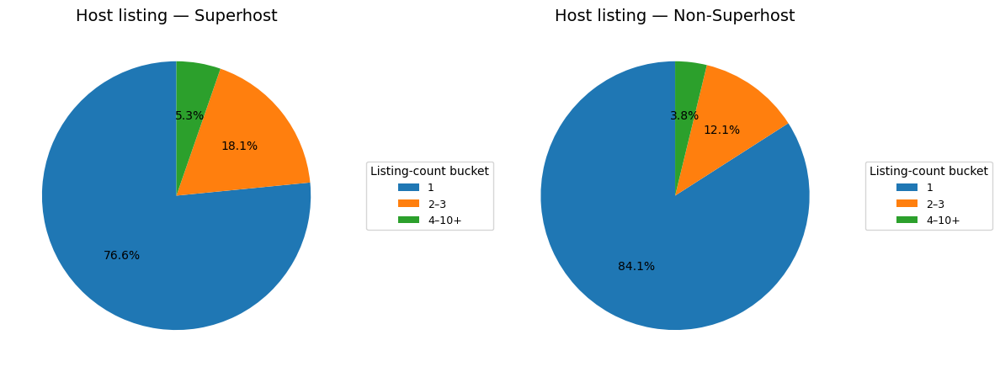

In [415]:
#share table
host_flag = d.groupby(HOST)['is_super'].max().rename('host_is_super').astype('Int8')
host_n    = d.groupby(HOST)[LISTING].nunique().rename('n_listings').astype(int)
host_df   = pd.concat([host_flag, host_n], axis=1).reset_index()


def bucketize_full(n):
    if n == 1: return "1"
    if 2 <= n <= 3: return "2–3"
    if 4 <= n <= 5: return "4–5"
    if 6 <= n <= 10: return "6–10"
    return "10+"

order_full = ["1","2–3","4–5","6–10","10+"]
host_df['bucket_full'] = host_df['n_listings'].map(bucketize_full)

def bucket_table(g):
    ct = (g['bucket_full'].value_counts()
          .reindex(order_full, fill_value=0)
          .rename_axis('bucket_full').to_frame('count').reset_index())
    total = ct['count'].sum()
    ct['share'] = ct['count'] / total if total > 0 else 0.0
    return ct

sup_tab  = bucket_table(host_df[host_df['host_is_super']==1]).assign(group='Superhost')
non_tab  = bucket_table(host_df[host_df['host_is_super']==0]).assign(group='Non-Superhost')
both_tab = pd.concat([sup_tab, non_tab], ignore_index=True)


share_full = (
    both_tab.pivot(index='bucket_full', columns='group', values='share')
            .reindex(order_full)
)


collapsed = pd.DataFrame(index=['1','2–3','4–5','6–10+'],
                         columns=['Superhost','Non-Superhost'], dtype=float)
collapsed.loc['1']     = share_full.loc['1']
collapsed.loc['2–3']   = share_full.loc['2–3']
collapsed.loc['4–5']   = share_full.loc['4–5']
collapsed.loc['6–10+'] = share_full.loc[['6–10','10+']].sum(skipna=True)

print("\nShare of hosts in each listing-count bucket (Superhost vs Non-Superhost):")
display(collapsed.style.format('{:.2%}'))



#pie chart
def get_collapsed_3():
    if 'collapsed' in globals():
        c = collapsed.copy()
        out = pd.DataFrame(index=['1','2–3','4–10+'], columns=c.columns, dtype=float)
        out.loc['1']     = c.loc['1']
        out.loc['2–3']   = c.loc['2–3']
        out.loc['4–10+'] = c.loc[['4–5','6–10+']].sum(skipna=True)
        return out.fillna(0.0)

    assert 'share_full' in globals(), "lack share_full"
    sf = share_full.copy() 
    out = pd.DataFrame(index=['1','2–3','4–10+'], columns=sf.columns, dtype=float)
    out.loc['1']     = sf.loc['1']
    out.loc['2–3']   = sf.loc['2–3']
    out.loc['4–10+'] = sf.loc[['4–5','6–10','10+']].sum(skipna=True)
    return out.fillna(0.0)

pie_share = get_collapsed_3()


labels_3    = ['1','2–3','4–10+']
sizes_super = pie_share['Superhost'].values
sizes_non   = pie_share['Non-Superhost'].values

def make_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_3,
        title='Listing-count bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(12, 6))
make_pie(axes[0], sizes_super, 'Host listing — Superhost')
make_pie(axes[1], sizes_non,   'Host listing — Non-Superhost')
plt.tight_layout()
plt.show()

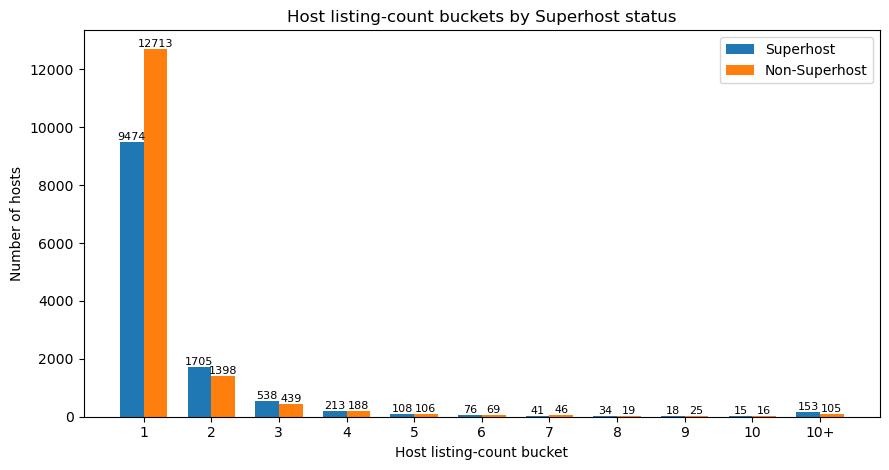

In [416]:
# bar chart
order_full = [str(i) for i in range(1, 11)] + ['10+']

if 'host_df_full' not in globals():
    assert 'host_df' in globals(), "need host _df"
    def bucket_full(n):
        return str(int(n)) if n <= 10 else '10+'
    host_df_full = host_df.copy()
    host_df_full['bucket_full'] = host_df_full['n_listings'].map(bucket_full)

def _bucket_table_full(g, gname):
    ct = (g['bucket_full'].value_counts()
          .reindex(order_full, fill_value=0)
          .rename_axis('bucket').to_frame('count').reset_index())
    ct['group'] = gname
    return ct

sup_full = _bucket_table_full(host_df_full[host_df_full['host_is_super'] == 1], 'Superhost')
non_full = _bucket_table_full(host_df_full[host_df_full['host_is_super'] == 0], 'Non-Superhost')
full_bucket_compare = pd.concat([sup_full, non_full], ignore_index=True)


pivot_counts = (full_bucket_compare
                .pivot(index='bucket', columns='group', values='count')
                .reindex(order_full)
                .fillna(0))

x = np.arange(len(order_full))
width = 0.35

sup_vals = pivot_counts['Superhost'].values
non_vals = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(9, 4.8))
bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Host listing-count bucket')
plt.ylabel('Number of hosts')
plt.title('Host listing-count buckets by Superhost status')
plt.xticks(x, order_full)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h > 0:
        plt.text(bar.get_x() + bar.get_width()/2, h, f'{int(h)}',
                 ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()

In [417]:
#number of review
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


reviews_raw = pd.to_numeric(df['number_of_reviews'], errors='coerce')
df['n_reviews'] = reviews_raw


summary_reviews = (
    df.groupby('is_super')['n_reviews']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of number_of_reviews:")
display(summary_reviews.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 1, 6, 21, 51, np.inf]
labels = ['0', '1–5', '6–20', '21–50', '50+']

def bucket_n_reviews(group_df, group_name):
    r = group_df['n_reviews'].dropna()
    rv_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=False   # left-closed, so [0,1), [1,6), ...
    )

    bucket_counts = (
        rv_bucket.value_counts()
                 .reindex(labels, fill_value=0)
                 .rename_axis('bucket')
                 .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_n_reviews(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_n_reviews(df[df['is_super'] == 0], 'Non-Superhost')

print("\nNumber_of_reviews buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nNumber_of_reviews buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of number_of_reviews:


,count,mean,median
is_super,,,
Non-Superhost,"23,900",30.51,7.00
Superhost,"22,091",99.23,50.00



Number_of_reviews buckets among Superhosts:


,bucket,count,share
0,0,792,3.59%
1,1–5,"1,792",8.11%
2,6–20,"3,858",17.46%
3,21–50,"4,680",21.19%
4,50+,"10,969",49.65%



Number_of_reviews buckets among Non-Superhosts:


,bucket,count,share
0,0,"4,294",17.97%
1,1–5,"6,770",28.33%
2,6–20,"5,625",23.54%
3,21–50,"3,328",13.92%
4,50+,"3,883",16.25%



Share of listings in each number_of_reviews bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0,17.97%,3.59%
1–5,28.33%,8.11%
6–20,23.54%,17.46%
21–50,13.92%,21.19%
50+,16.25%,49.65%


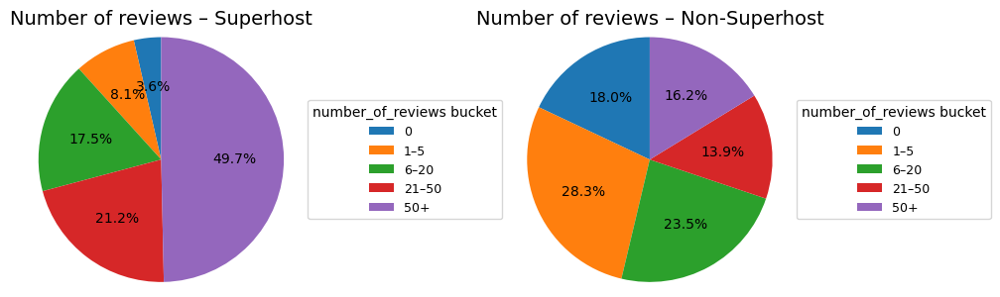

In [418]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each number_of_reviews bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))


#Pie chart

labels_pie = sup_bucket['bucket'].tolist()  

sizes_super = sup_bucket['share'].values
sizes_non   = non_bucket['share'].values

def make_reviews_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',          
        startangle=90,
        textprops={'fontsize': 10},
        radius=1.2
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_pie,
        title='number_of_reviews bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_reviews_pie(axes[0], sizes_super, 'Number of reviews – Superhost')
make_reviews_pie(axes[1], sizes_non,   'Number of reviews – Non-Superhost')

plt.tight_layout()
plt.show()

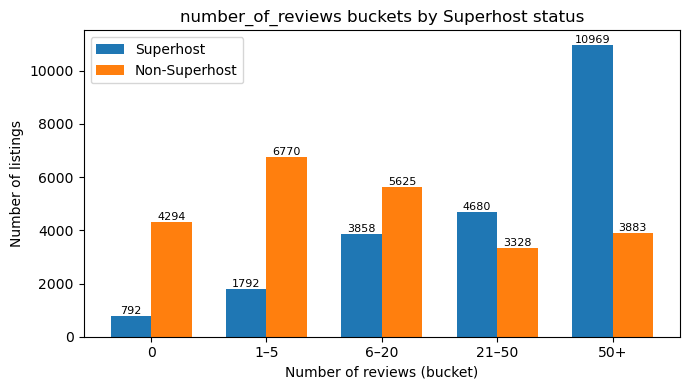

In [419]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Number of reviews (bucket)')
plt.ylabel('Number of listings')
plt.title('number_of_reviews buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [420]:
report='''
Sample Size: Superhost 22,091; Non-Superhost 23,900.

Central Trend:
Superhost: Mean 99.23, Median 50;
Non-Superhost: Mean 30.51, Median 7.

Therefore, Superhost has a significantly higher total number of reviews, both in terms of mean and median (median 50 vs 7).

Distribution (Percentage):
Superhost: 0 (3.59%) | 1–5 (8.11%) | 6–20 (17.46%) | 21–50 (21.19%) | 50+ (49.65%). Nearly half (49.65%) of Superhost listings have ≥50 reviews.
Non-Superhost: 0 (17.97%) | 1–5 (28.33%) | 6–20 (23.54%) | 21–50 (13.92%) | 50+ (16.25%). 
The percentage of hosts with low review counts (≤5) is 46.30% (0 plus 1–5), while hosts with ≥50 reviews account for only 16.25%.

Conclusion: A structural divergence exists between Superhosts and Non-Superhosts in terms of reviews: 
Superhosts are significantly concentrated in the high review count segment (≥50), 
while Non-Superhosts are largely concentrated in the low review count segment (≤5). 
This means that Superhosts have accumulated more social validation and reputation, resulting in a higher recommendation rate.
'''
print(report)


Sample Size: Superhost 22,091; Non-Superhost 23,900.

Central Trend:
Superhost: Mean 99.23, Median 50;
Non-Superhost: Mean 30.51, Median 7.

Therefore, Superhost has a significantly higher total number of reviews, both in terms of mean and median (median 50 vs 7).

Distribution (Percentage):
Superhost: 0 (3.59%) | 1–5 (8.11%) | 6–20 (17.46%) | 21–50 (21.19%) | 50+ (49.65%). Nearly half (49.65%) of Superhost listings have ≥50 reviews.
Non-Superhost: 0 (17.97%) | 1–5 (28.33%) | 6–20 (23.54%) | 21–50 (13.92%) | 50+ (16.25%). 
The percentage of hosts with low review counts (≤5) is 46.30% (0 plus 1–5), while hosts with ≥50 reviews account for only 16.25%.

Conclusion: A structural divergence exists between Superhosts and Non-Superhosts in terms of reviews: 
Superhosts are significantly concentrated in the high review count segment (≥50), 
while Non-Superhosts are largely concentrated in the low review count segment (≤5). 
This means that Superhosts have accumulated more social validation a

In [421]:
#reviews_per_month
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


rpm_raw = pd.to_numeric(df['reviews_per_month'], errors='coerce')
df['rpm'] = rpm_raw


summary_rpm = (
    df.groupby('is_super')['rpm']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of reviews_per_month:")
display(summary_rpm.style.format({
    'count': '{:,.0f}',
    'mean': '{:.3f}',
    'median': '{:.3f}'
}))


bins = [0, 1e-9, 0.2, 0.5, 1.0, np.inf]
labels = ['0', '0–0.2', '0.2–0.5', '0.5–1', '1+']

def bucket_rpm(group_df, group_name):
    r = group_df['rpm'].dropna()
    rpm_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=False
    )

    bucket_counts = (
        rpm_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_rpm(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_rpm(df[df['is_super'] == 0], 'Non-Superhost')

print("\nreviews_per_month buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nreviews_per_month buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of reviews_per_month:


,count,mean,median
is_super,,,
Non-Superhost,"19,606",0.998,0.540
Superhost,"21,299",2.349,1.780



reviews_per_month buckets among Superhosts:


,bucket,count,share
0,0,0,0.00%
1,0–0.2,858,4.03%
2,0.2–0.5,"1,714",8.05%
3,0.5–1,"3,276",15.38%
4,1+,"15,451",72.54%



reviews_per_month buckets among Non-Superhosts:


,bucket,count,share
0,0,0,0.00%
1,0–0.2,"4,281",21.84%
2,0.2–0.5,"5,031",25.66%
3,0.5–1,"4,110",20.96%
4,1+,"6,184",31.54%



Share of listings in each reviews_per_month bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0,0.00%,0.00%
0–0.2,21.84%,4.03%
0.2–0.5,25.66%,8.05%
0.5–1,20.96%,15.38%
1+,31.54%,72.54%


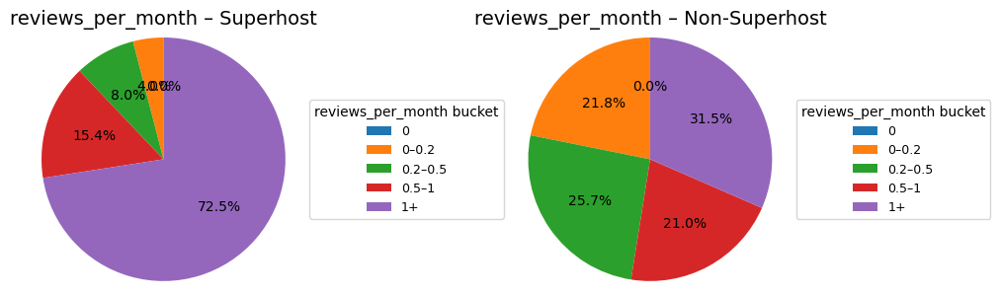

In [422]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each reviews_per_month bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))

# Pie charts

labels_pie = sup_bucket['bucket'].tolist()   

sizes_super = sup_bucket['share'].values
sizes_non   = non_bucket['share'].values

def make_rpm_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',        
        startangle=90,
        textprops={'fontsize': 10},
        radius=1.2
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_pie,
        title='reviews_per_month bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_rpm_pie(axes[0], sizes_super, 'reviews_per_month – Superhost')
make_rpm_pie(axes[1], sizes_non,   'reviews_per_month – Non-Superhost')

plt.tight_layout()
plt.show()

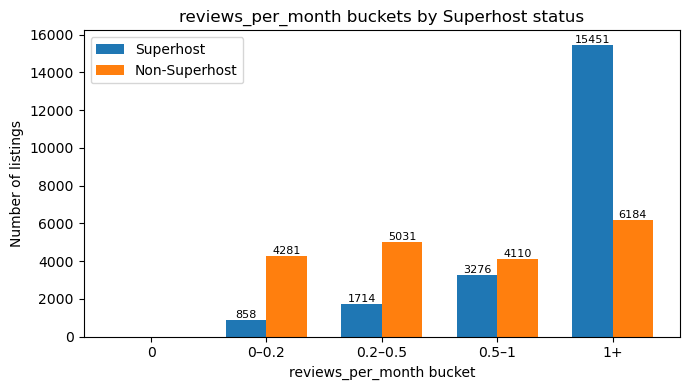

In [423]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('reviews_per_month bucket')
plt.ylabel('Number of listings')
plt.title('reviews_per_month buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [424]:
report='''
`reviews_per_month` represents the average number of reviews per month for a listing over the past year.

Key Findings:
Mean/Median: Superhost 2.349 / 1.780; Non-Superhost 0.998 / 0.540.

Superhost averages 1.351 reviews per month.

High Activity Percentage (≥1 review/month): Superhost 72.54% vs Non-Superhost 31.54%.
Low Activity Percentage (≤0.5 reviews/month): Superhost 12.08% (4.03% + 8.05%) vs Non-Superhost 47.50% (21.84% + 25.66%).

Number of Buckets:
Superhost: 0–0.2 858, 0.2–0.5 1,714, 0.5–1 3,276, 1+ 15,451.
Non-Superhost: 0–0.2 4,281, 0.2–0.5 5,031, 0.5–1 4,110, 1+ 6,184.

Reviews per month is a direct quantitative indicator of host interaction intensity/demand momentum: Comparing 100 listings, 
Superhost is expected to receive approximately 235 reviews per month, while Non-Superhost is expected to receive approximately 100.
This indicator is heavily influenced by Superhost.
'''
print(report)


`reviews_per_month` represents the average number of reviews per month for a listing over the past year.

Key Findings:
Mean/Median: Superhost 2.349 / 1.780; Non-Superhost 0.998 / 0.540.

Superhost averages 1.351 reviews per month.

High Activity Percentage (≥1 review/month): Superhost 72.54% vs Non-Superhost 31.54%.
Low Activity Percentage (≤0.5 reviews/month): Superhost 12.08% (4.03% + 8.05%) vs Non-Superhost 47.50% (21.84% + 25.66%).

Number of Buckets:
Superhost: 0–0.2 858, 0.2–0.5 1,714, 0.5–1 3,276, 1+ 15,451.
Non-Superhost: 0–0.2 4,281, 0.2–0.5 5,031, 0.5–1 4,110, 1+ 6,184.

Reviews per month is a direct quantitative indicator of host interaction intensity/demand momentum: Comparing 100 listings, 
Superhost is expected to receive approximately 235 reviews per month, while Non-Superhost is expected to receive approximately 100.
This indicator is heavily influenced by Superhost.



In [425]:
#number_of_reviews_ltm
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")



ltm_raw = pd.to_numeric(df['number_of_reviews_ltm'], errors='coerce')
df['n_reviews_ltm'] = ltm_raw



summary_ltm = (
    df.groupby('is_super')['n_reviews_ltm']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of number_of_reviews_ltm (last 12 months):")
display(summary_ltm.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins = [0, 1, 6, 16, 31, np.inf]
labels = ['0', '1–5', '6–15', '16–30', '30+']

def bucket_n_reviews_ltm(group_df, group_name):
    r = group_df['n_reviews_ltm'].dropna()
    ltm_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=False   # [0,1), [1,6), [6,16) ...
    )

    bucket_counts = (
        ltm_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_n_reviews_ltm(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_n_reviews_ltm(df[df['is_super'] == 0], 'Non-Superhost')

print("\nnumber_of_reviews_ltm buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nnumber_of_reviews_ltm buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of number_of_reviews_ltm (last 12 months):


,count,mean,median
is_super,,,
Non-Superhost,"23,900",6.21,2.00
Superhost,"22,091",24.00,16.00



number_of_reviews_ltm buckets among Superhosts:


,bucket,count,share
0,0,"1,350",6.11%
1,1–5,"3,260",14.76%
2,6–15,"6,047",27.37%
3,16–30,"5,270",23.86%
4,30+,"6,164",27.90%



number_of_reviews_ltm buckets among Non-Superhosts:


,bucket,count,share
0,0,"7,645",31.99%
1,1–5,"9,568",40.03%
2,6–15,"4,058",16.98%
3,16–30,"1,564",6.54%
4,30+,"1,065",4.46%



Share of listings in each number_of_reviews_ltm bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0,31.99%,6.11%
1–5,40.03%,14.76%
6–15,16.98%,27.37%
16–30,6.54%,23.86%
30+,4.46%,27.90%


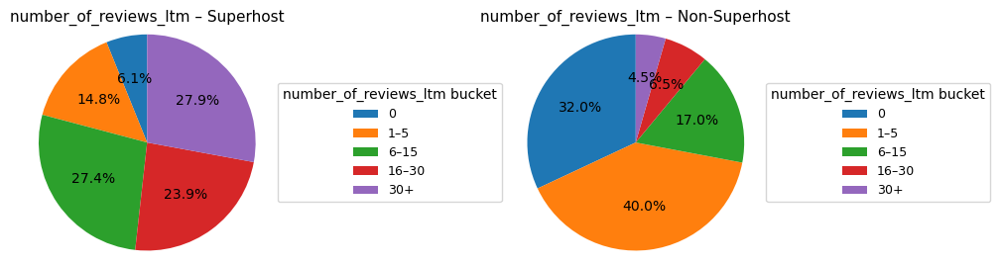

In [426]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each number_of_reviews_ltm bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))


#Pie charts

labels_pie = sup_bucket['bucket'].tolist()

sizes_super = sup_bucket['share'].values
sizes_non   = non_bucket['share'].values

def make_ltm_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',       
        startangle=90,
        textprops={'fontsize': 10},
        radius=1.2
    )
    ax.set_title(title, fontsize=11)
    ax.legend(
        wedges,
        labels_pie,
        title='number_of_reviews_ltm bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_ltm_pie(axes[0], sizes_super, 'number_of_reviews_ltm – Superhost')
make_ltm_pie(axes[1], sizes_non,   'number_of_reviews_ltm – Non-Superhost')

plt.tight_layout()
plt.show()


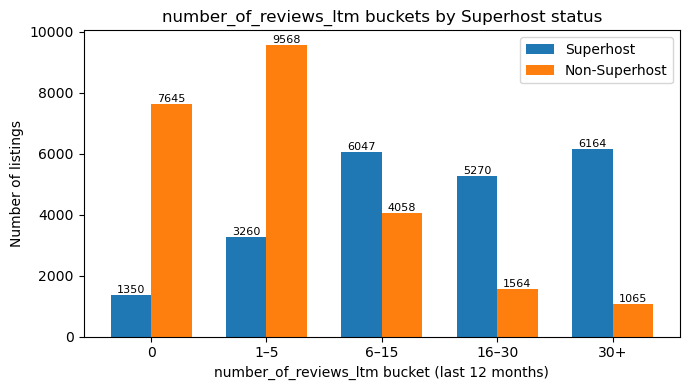

In [427]:
#bar chart
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('number_of_reviews_ltm bucket (last 12 months)')
plt.ylabel('Number of listings')
plt.title('number_of_reviews_ltm buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [428]:
report='''
The following three charts (LTM = number of reviews in the past 12 months) provide a data summary:

1) Basic Statistics
Superhosts: Mean 24.00, Median 16.00 (sample 22,091).Non-Superhosts: Mean 6.21, Median 2.00 (sample 23,900).

2) Distribution Comparison
Superhost:
0: 6.11% (≈1,350)
1–5: 14.76% (≈3,260)
6–15: 27.37% (≈6,047)
16–30: 23.86% (≈5,270)
30+: 27.90% (≈6,164)

Non-Superhost:
0: 31.99% (≈7,645)
1–5: 40.03% (≈9,568)
6–15: 16.98% (≈4,058)
16–30: 6.54% (≈1,564)
30+: 4.46% (≈1,065)

3) Key Comparison Metrics
At least one review in the past 12 months: Superhost 93.89% vs Non-Superhost 68.01%
Active segment (≥6 reviews/12 months): Superhost 79.13% (=27.37+23.86+27.90) vs Non-Superhost 27.98% (=16.98+6.54+4.46).
Highly active segment (30+ reviews/12 months): Superhost 27.90% ≈ 6.3 × Non-Superhost 4.46%.
Inactive (0 reviews/12 months): Superhost 6.11% vs Non-Superhost 31.99%

Conclusion: "Number of reviews (LTM)" is a highly discriminating indicator of activity:
Superhosts have a significantly higher percentage of reviews in the medium-to-high activity range (≥6 reviews) than Non-Superhosts (79% vs 28%), 
and are significantly concentrated in the 30+ extremely high activity range (27.9% vs 4.5%).

A higher LTM number of reviews generally means more stable bookings and more experience, which is strongly correlated with being rated as a Superhost.
'''
print(report)


The following three charts (LTM = number of reviews in the past 12 months) provide a data summary:

1) Basic Statistics
Superhosts: Mean 24.00, Median 16.00 (sample 22,091).Non-Superhosts: Mean 6.21, Median 2.00 (sample 23,900).

2) Distribution Comparison
Superhost:
0: 6.11% (≈1,350)
1–5: 14.76% (≈3,260)
6–15: 27.37% (≈6,047)
16–30: 23.86% (≈5,270)
30+: 27.90% (≈6,164)

Non-Superhost:
0: 31.99% (≈7,645)
1–5: 40.03% (≈9,568)
6–15: 16.98% (≈4,058)
16–30: 6.54% (≈1,564)
30+: 4.46% (≈1,065)

3) Key Comparison Metrics
At least one review in the past 12 months: Superhost 93.89% vs Non-Superhost 68.01%
Active segment (≥6 reviews/12 months): Superhost 79.13% (=27.37+23.86+27.90) vs Non-Superhost 27.98% (=16.98+6.54+4.46).
Highly active segment (30+ reviews/12 months): Superhost 27.90% ≈ 6.3 × Non-Superhost 4.46%.
Inactive (0 reviews/12 months): Superhost 6.11% vs Non-Superhost 31.99%

Conclusion: "Number of reviews (LTM)" is a highly discriminating indicator of activity:
Superhosts have a si

In [429]:
#number_of_reviews_l30d
df = df.copy()
if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


l30_raw = pd.to_numeric(df['number_of_reviews_l30d'], errors='coerce')
df['n_reviews_l30d'] = l30_raw


summary_l30 = (
    df.groupby('is_super')['n_reviews_l30d']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of number_of_reviews_l30d (last 30 days):")
display(summary_l30.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))

bins = [0, 1, 3, 6, 11, np.inf]
labels = ['0', '1–2', '3–5', '6–10', '10+']

def bucket_n_reviews_l30d(group_df, group_name):
    r = group_df['n_reviews_l30d'].dropna()
    l30_bucket = pd.cut(
        r,
        bins=bins,
        labels=labels,
        include_lowest=True,
        right=False   # [0,1), [1,3), [3,6) ...
    )

    bucket_counts = (
        l30_bucket.value_counts()
                  .reindex(labels, fill_value=0)
                  .rename_axis('bucket')
                  .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket  = bucket_n_reviews_l30d(df[df['is_super'] == 1], 'Superhost')
non_bucket  = bucket_n_reviews_l30d(df[df['is_super'] == 0], 'Non-Superhost')

print("\nnumber_of_reviews_l30d buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nnumber_of_reviews_l30d buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of number_of_reviews_l30d (last 30 days):


,count,mean,median
is_super,,,
Non-Superhost,"23,900",0.37,0.00
Superhost,"22,091",1.19,0.00



number_of_reviews_l30d buckets among Superhosts:


,bucket,count,share
0,0,"11,550",52.28%
1,1–2,"6,727",30.45%
2,3–5,"2,976",13.47%
3,6–10,782,3.54%
4,10+,56,0.25%



number_of_reviews_l30d buckets among Non-Superhosts:


,bucket,count,share
0,0,"19,316",80.82%
1,1–2,"3,556",14.88%
2,3–5,866,3.62%
3,6–10,144,0.60%
4,10+,18,0.08%



Share of listings in each number_of_reviews_l30d bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
0,80.82%,52.28%
1–2,14.88%,30.45%
3–5,3.62%,13.47%
6–10,0.60%,3.54%
10+,0.08%,0.25%


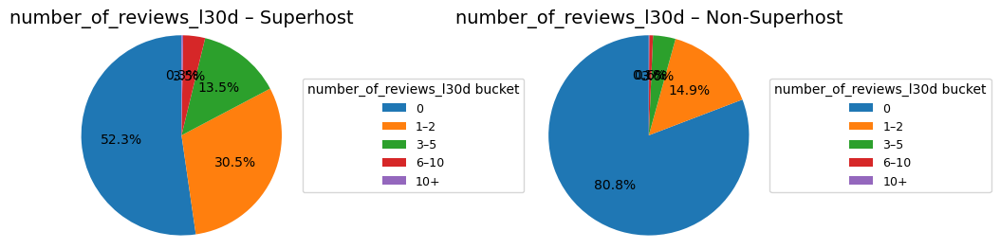

In [430]:
#table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='share')
        .reindex(labels)
)
share_table.columns.name = None

print("\nShare of listings in each number_of_reviews_l30d bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))

#Pie charts

labels_pie = sup_bucket['bucket'].tolist() 

sizes_super = sup_bucket['share'].values
sizes_non   = non_bucket['share'].values

def make_l30_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',      
        startangle=90,
        textprops={'fontsize': 10},
        radius=1.2
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_pie,
        title='number_of_reviews_l30d bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_l30_pie(axes[0], sizes_super, 'number_of_reviews_l30d – Superhost')
make_l30_pie(axes[1], sizes_non,   'number_of_reviews_l30d – Non-Superhost')

plt.tight_layout()
plt.show()

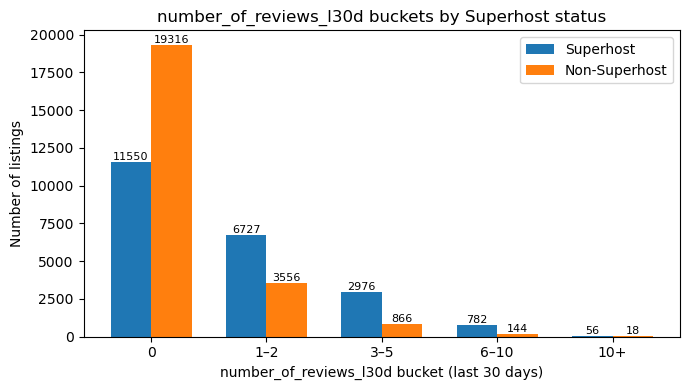

In [431]:
#bar chart 
pivot_counts = (
    bucket_compare
        .pivot(index='bucket', columns='group', values='count')
        .reindex(labels)
        .fillna(0)
)

x = np.arange(len(labels))
width = 0.35

sup_vals  = pivot_counts['Superhost'].values
non_vals  = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('number_of_reviews_l30d bucket (last 30 days)')
plt.ylabel('Number of listings')
plt.title('number_of_reviews_l30d buckets by Superhost status')
plt.xticks(x, labels)
plt.legend()


for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [432]:
report='''
Superhosts are more likely to get new reviews in the past 30 days: 47.7% have reviews compared to 19.2%, 
and the probability of getting more than 3 reviews is about 4 times that of non-Superhosts—this is a strong signal of recent activity and demand,
and should be a key operational metric for new hosts.
'''
print(report)


Superhosts are more likely to get new reviews in the past 30 days: 47.7% have reviews compared to 19.2%, 
and the probability of getting more than 3 reviews is about 4 times that of non-Superhosts—this is a strong signal of recent activity and demand,
and should be a key operational metric for new hosts.



In [433]:
d = df.copy()

if 'is_super' not in d.columns:
    d['is_super'] = (
        d['host_is_superhost'].astype(str).str.strip().str.lower()
          .map({'t':1,'true':1,'1':1,'f':0,'false':0,'0':0})
          .astype('Int8')
    )


def pick(cols, cands):
    low = {c.lower(): c for c in cols}
    for c in cands:
        if c.lower() in low: return low[c.lower()]
    for c in cols:  
        if any(cc.lower().replace('_','') in c.lower().replace('_','') for cc in cands):
            return c
    return None

HOST    = pick(d.columns, ['host_id','hostid'])
LISTING = pick(d.columns, ['id','listing_id','listingid'])
REV_ALL = pick(d.columns, ['number_of_reviews','reviews_count'])
RPM     = pick(d.columns, ['reviews_per_month','rpm'])
REV_LTM = pick(d.columns, ['number_of_reviews_ltm','reviews_ltm'])
REV_L30 = pick(d.columns, ['number_of_reviews_l30d','reviews_30d','reviews_last_30d'])

assert HOST and LISTING and REV_ALL, "需要 host_id / listing_id / number_of_reviews 列。"


agg = {LISTING:'nunique', REV_ALL:'sum'}
if RPM:     agg[RPM]     = 'sum'
if REV_LTM: agg[REV_LTM] = 'sum'
if REV_L30: agg[REV_L30] = 'sum'

host = (d.groupby(HOST, as_index=False)
          .agg(agg)
          .rename(columns={LISTING:'n_listings',
                           REV_ALL:'reviews_all',
                           (RPM or 'rpm'):'reviews_per_month',
                           (REV_LTM or 'ltm'):'reviews_ltm',
                           (REV_L30 or 'l30'):'reviews_30d'}))

flag = d.groupby(HOST)['is_super'].max().rename('is_super').reset_index()
host = host.merge(flag, on=HOST, how='left')


def bucket_1_10plus(n):
    return str(int(n)) if n<=10 else '10+'
host['bucket'] = host['n_listings'].apply(bucket_1_10plus)
ORDER = ['1','2','3','4','5','6','7','8','9','10','10+']


def build_summary(host_df, value_col, pretty_name):
    if value_col not in host_df.columns:
        return None, f"⚠️ Skipped {pretty_name} (column `{value_col}` not found)"

    tmp = host_df.copy()
    tmp['per_listing'] = tmp[value_col] / tmp['n_listings'].clip(lower=1)

    
    g = (tmp.groupby(['is_super','bucket'], observed=False)
            .agg(
                n_hosts=('is_super','size'),
                mean=(value_col,'mean'),
                median=(value_col,'median'),
                sum=(value_col,'sum'),
                per_listing_mean=('per_listing','mean'),
                per_listing_median=('per_listing','median'),
            ).reset_index())

    g['group']  = g['is_super'].map({1:'Superhost',0:'Non-Superhost'})
    g['bucket'] = pd.Categorical(g['bucket'], categories=ORDER, ordered=True)
    g = g.sort_values(['group','bucket']).drop(columns='is_super')

    
    g = g.rename(columns={
        'mean'               : f'{pretty_name}_mean',
        'median'             : f'{pretty_name}_median',
        'sum'                : f'{pretty_name}_sum',
        'per_listing_mean'   : f'{pretty_name}_per_listing_mean',
        'per_listing_median' : f'{pretty_name}_per_listing_median',
    })

 
    cols = ['group','bucket','n_hosts',
            f'{pretty_name}_mean', f'{pretty_name}_median', f'{pretty_name}_sum',
            f'{pretty_name}_per_listing_mean', f'{pretty_name}_per_listing_median']
    g = g[cols]
    g.name = pretty_name
    return g, None


tbl_all,  msg1 = build_summary(host, 'reviews_all',       'all_reviews')
tbl_rpm,  msg2 = build_summary(host, 'reviews_per_month', 'reviews_per_month')
tbl_ltm,  msg3 = build_summary(host, 'reviews_ltm',       'ltm_reviews')
tbl_l30,  msg4 = build_summary(host, 'reviews_30d',       'l30d_reviews')


def show_tbl(t):
    if t is None: return
    print(f"\n===== {t.name} (by group × listing-count bucket) =====")
    display(
        t.style.format({
            'n_hosts':'{:,.0f}',
            f'{t.name}_mean':'{:.2f}',
            f'{t.name}_median':'{:.2f}',
            f'{t.name}_sum':'{:,.0f}',
            f'{t.name}_per_listing_mean':'{:.2f}',
            f'{t.name}_per_listing_median':'{:.2f}',
        })
    )

for t, msg in [(tbl_all,msg1),(tbl_rpm,msg2),(tbl_ltm,msg3),(tbl_l30,msg4)]:
    show_tbl(t)
    if msg: print(msg)


===== all_reviews (by group × listing-count bucket) =====


,group,bucket,n_hosts,all_reviews_mean,all_reviews_median,all_reviews_sum,all_reviews_per_listing_mean,all_reviews_per_listing_median
0,Non-Superhost,1,"12,713",31.15,7.00,"396,072",31.15,7.00
3,Non-Superhost,2,"1,398",70.60,22.00,"98,692",35.30,11.00
4,Non-Superhost,3,439,132.85,41.00,"58,320",44.28,13.67
5,Non-Superhost,4,188,141.33,40.50,"26,570",35.33,10.12
6,Non-Superhost,5,106,174.46,82.50,"18,493",34.89,16.50
7,Non-Superhost,6,69,167.86,62.00,"11,582",27.98,10.33
8,Non-Superhost,7,46,216.50,84.50,"9,959",30.93,12.07
9,Non-Superhost,8,19,233.95,137.00,"4,445",29.24,17.12
10,Non-Superhost,9,25,271.12,180.00,"6,778",30.12,20.00
1,Non-Superhost,10,16,204.88,91.00,"3,278",20.49,9.10



===== reviews_per_month (by group × listing-count bucket) =====


,group,bucket,n_hosts,reviews_per_month_mean,reviews_per_month_median,reviews_per_month_sum,reviews_per_month_per_listing_mean,reviews_per_month_per_listing_median
0,Non-Superhost,1,"12,713",0.85,0.43,"10,758",0.85,0.43
3,Non-Superhost,2,"1,398",1.61,0.83,"2,258",0.81,0.41
4,Non-Superhost,3,439,2.78,1.31,"1,221",0.93,0.44
5,Non-Superhost,4,188,2.92,1.56,549,0.73,0.39
6,Non-Superhost,5,106,4.11,2.28,436,0.82,0.46
7,Non-Superhost,6,69,4.05,2.61,279,0.67,0.43
8,Non-Superhost,7,46,5.14,3.12,236,0.73,0.45
9,Non-Superhost,8,19,9.66,5.18,183,1.21,0.65
10,Non-Superhost,9,25,8.22,4.32,205,0.91,0.48
1,Non-Superhost,10,16,4.74,2.87,76,0.47,0.29



===== ltm_reviews (by group × listing-count bucket) =====


,group,bucket,n_hosts,ltm_reviews_mean,ltm_reviews_median,ltm_reviews_sum,ltm_reviews_per_listing_mean,ltm_reviews_per_listing_median
0,Non-Superhost,1,"12,713",5.94,2.00,"75,452",5.94,2.00
3,Non-Superhost,2,"1,398",12.58,4.00,"17,583",6.29,2.00
4,Non-Superhost,3,439,23.55,6.00,"10,337",7.85,2.00
5,Non-Superhost,4,188,23.61,7.00,"4,438",5.90,1.75
6,Non-Superhost,5,106,36.38,15.00,"3,856",7.28,3.00
7,Non-Superhost,6,69,33.64,15.00,"2,321",5.61,2.50
8,Non-Superhost,7,46,38.67,17.00,"1,779",5.52,2.43
9,Non-Superhost,8,19,79.21,35.00,"1,505",9.90,4.38
10,Non-Superhost,9,25,70.64,34.00,"1,766",7.85,3.78
1,Non-Superhost,10,16,40.94,19.50,655,4.09,1.95



===== l30d_reviews (by group × listing-count bucket) =====


,group,bucket,n_hosts,l30d_reviews_mean,l30d_reviews_median,l30d_reviews_sum,l30d_reviews_per_listing_mean,l30d_reviews_per_listing_median
0,Non-Superhost,1,"12,713",0.39,0.00,"4,986",0.39,0.00
3,Non-Superhost,2,"1,398",0.62,0.00,862,0.31,0.00
4,Non-Superhost,3,439,1.10,0.00,485,0.37,0.00
5,Non-Superhost,4,188,1.29,0.00,242,0.32,0.00
6,Non-Superhost,5,106,1.67,0.00,177,0.33,0.00
7,Non-Superhost,6,69,1.86,0.00,128,0.31,0.00
8,Non-Superhost,7,46,2.17,0.00,100,0.31,0.00
9,Non-Superhost,8,19,4.16,1.00,79,0.52,0.12
10,Non-Superhost,9,25,3.84,1.00,96,0.43,0.11
1,Non-Superhost,10,16,1.88,0.50,30,0.19,0.05


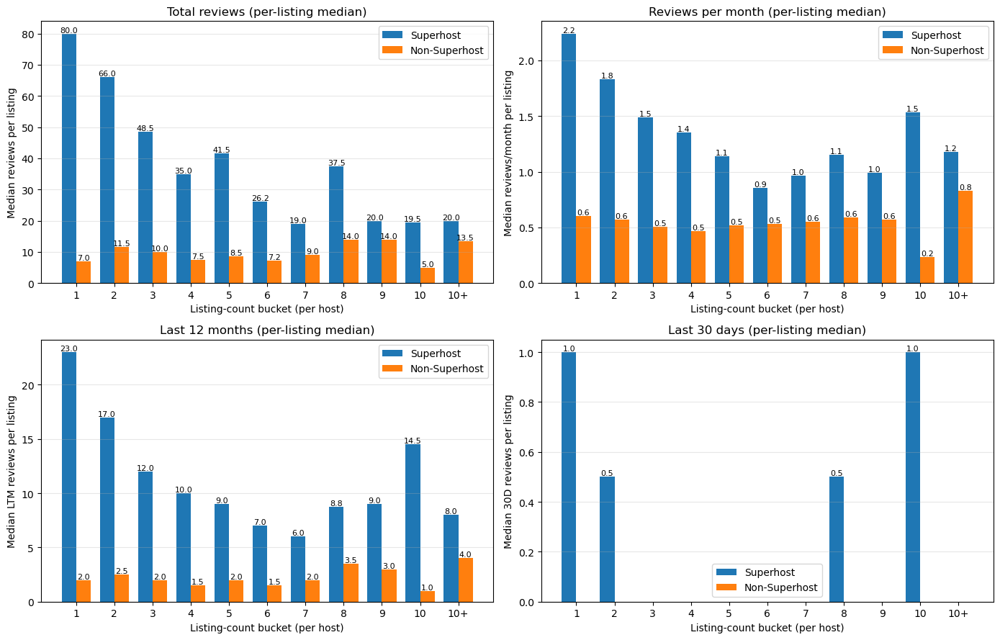

In [434]:
def _bool01(s):
    return (s.astype(str).str.strip().str.lower()
             .map({'t':1,'true':1,'1':1,'y':1,'yes':1,
                   'f':0,'false':0,'0':0,'n':0,'no':0})
             .fillna(0).astype('int8'))

def _detect_col(columns, candidates):
    lower = {c.lower(): c for c in columns}
    for cand in candidates:
        if cand.lower() in lower: return lower[cand.lower()]
    for c in columns:
        cl = c.lower().replace('_','')
        for cand in candidates:
            if cand.lower().replace('_','') in cl: return c
    return None

def _bucket_n_listings(n):
    n = int(n)
    return str(n) if n <= 10 else '10+'

BUCKET_ORDER = [str(i) for i in range(1,11)] + ['10+']



super_col_guess = _detect_col(d.columns, ['is_super', 'host_is_superhost', 'is_superhost'])
if super_col_guess is None:
    raise ValueError("Could not find a superhost flag column.")
d['is_super'] = _bool01(d[super_col_guess])

HOST    = _detect_col(d.columns, ['host_id','hostid','host_id_str'])
LISTING = _detect_col(d.columns, ['id','listing_id','listingid'])
assert HOST and LISTING, "Missing HOST or LISTING identifier."

# review columns 
ALL_COL = _detect_col(d.columns, ['number_of_reviews','reviews_total','all_reviews'])
RPM_COL = _detect_col(d.columns, ['reviews_per_month','review_per_month'])
LTM_COL = _detect_col(d.columns, ['number_of_reviews_ltm','reviews_ltm','reviews_12m'])
L30_COL = _detect_col(d.columns, ['number_of_reviews_l30d','reviews_30d','reviews_last_30d'])
for c in [ALL_COL, RPM_COL, LTM_COL, L30_COL]:
    d[c] = pd.to_numeric(d[c], errors='coerce')



n_listings = (d.groupby(HOST)[LISTING].nunique()
                .astype('int64')
                .rename('n_listings'))

def host_agg_for_metric(col):
    g = d.groupby(HOST)[col].agg(all_reviews_sum='sum',
                                 all_reviews_median='median')
    g = g.join(n_listings, how='left')
    g['all_reviews_per_listing_mean'] = g['all_reviews_sum'] / g['n_listings']
    # (optional) a host-level median of listing-level values (already computed):
    g['all_reviews_per_listing_median'] = g['all_reviews_median']
    return g

host_all  = host_agg_for_metric(ALL_COL)
host_rpm  = host_agg_for_metric(RPM_COL)
host_ltm  = host_agg_for_metric(LTM_COL)
host_l30  = host_agg_for_metric(L30_COL)

# build clean group labels 
host_meta = (d.groupby(HOST)['is_super'].max()
               .fillna(0).astype('int8')           
               .rename('is_super'))
host_meta = pd.DataFrame({'group': np.where(host_meta.values == 1,
                                            'Superhost', 'Non-Superhost')},
                         index=host_meta.index)

def prepare_for_plot(host_tbl, pretty_name):
    z = host_tbl.join(host_meta, how='inner').reset_index()
    z['bucket'] = z['n_listings'].map(_bucket_n_listings)
    z['pretty'] = pretty_name
    return z

A = prepare_for_plot(host_all, 'Total reviews')
B = prepare_for_plot(host_rpm, 'Reviews / month')
C = prepare_for_plot(host_ltm, 'Reviews (last 12 months)')
D = prepare_for_plot(host_l30, 'Reviews (last 30 days)')

# summaries

def summarize_for_bars(df_part, ycol='all_reviews_per_listing_median'):
    m = (df_part.groupby(['group', 'bucket'])[ycol]
                 .median()                  
                 .rename('median_val')
                 .reset_index())
    pv = (m.pivot(index='bucket', columns='group', values='median_val')
            .reindex(BUCKET_ORDER)
            .reindex(columns=['Superhost','Non-Superhost'], fill_value=0))
    return pv

pv_A = summarize_for_bars(A)  
pv_B = summarize_for_bars(B)
pv_C = summarize_for_bars(C)
pv_D = summarize_for_bars(D)


fig, axes = plt.subplots(2, 2, figsize=(14, 9))

plot_grouped_bar(axes[0,0], pv_A,
                 'Total reviews (per-listing median)',
                 'Median reviews per listing')

plot_grouped_bar(axes[0,1], pv_B,
                 'Reviews per month (per-listing median)',
                 'Median reviews/month per listing')

plot_grouped_bar(axes[1,0], pv_C,
                 'Last 12 months (per-listing median)',
                 'Median LTM reviews per listing')

plot_grouped_bar(axes[1,1], pv_D,
                 'Last 30 days (per-listing median)',
                 'Median 30D reviews per listing')

plt.tight_layout(); plt.show()

In [435]:
report='''
Superhost outperforms all listing sizes: 
Superhost’s median reviews per listing are higher than Non-Superhost’s for total reviews, reviews/month, last-12-months (LTM), 
and last-30-days, in every listing-count bucket.

Scale effect (medians): as hosts manage more listings, the median reviews per listing generally decline for both groups,
but Superhost keeps a consistent edge.

Edge is strongest at small scale:
1 listing (median): total 80 vs 7 (~11×), reviews/month 2.2 vs 0.6 (~3.7×), LTM 23 vs 2 (~11.5×).
10+ listings (median):20 vs ≈13.5, reviews/month ≈1.2 vs ≈0.8, LTM ≈8 vs ≈4.

Recency signal: in the last 30 days, Superhost medians are often ~0.5–1.0 per listing,
while Non-Superhost medians are frequently near 0, indicating lapsed demand.

Chart Interpretation:
Total reviews — per-listing median
Captures long-run reputation of a typical listing within each bucket. Superhosts dominate at every size (80 vs 7 at 1 listing; still higher at 10+).

Reviews per month — per-listing median
Measures steady-state demand velocity. Superhosts maintain ~1.1–2.2 reviews/month per listing across sizes, while Non-Superhosts sit around 0.5–0.8.

Last 12 months — per-listing median
Shows sustained momentum. Superhosts remain several multiples higher at small sizes ( 23 vs 2 at 1 listing) and keep an edge at larger sizes.

Last 30 days — per-listing median
Short-term recency. Superhost medians frequently fall between 0.5–1.0; Non-Superhost medians are often 0,
especially in mid/high buckets—evidence of lapsed demand.

Recommendations:
For new/small-scale hosts (1-3 properties):
Target: ≥1.0 reviews/property/month, ≥12 reviews received in the past year/property, average reviews received in the past 30 days ≥0.5/property.
Quick Strategy: Proactive care after check-in, follow up with reviews 6-12 hours after check-out; 
improve the stability of cleaning/communication experiences, initially aiming to raise ratings to 95+ and increase monthly review frequency.

For growing hosts (4-9 properties):
Establish standardized SOPs (self-checklist, automated messaging, restocking and inspection frequency); 
conduct "various diagnostics" for properties below the threshold ( monthly reviews <0.8/property) 
(title image, pricing, customizable strategies, cleaning timeliness, check-in friction).

For landlords with 10+ properties:
the natural decline in reviews per property is acceptable: Monthly reviews ≥ 0.9/property, LTM ≥ 12/property, 30-day reviews ≥ 0.5/property.
'''
print(report)


Superhost outperforms all listing sizes: 
Superhost’s median reviews per listing are higher than Non-Superhost’s for total reviews, reviews/month, last-12-months (LTM), 
and last-30-days, in every listing-count bucket.

Scale effect (medians): as hosts manage more listings, the median reviews per listing generally decline for both groups,
but Superhost keeps a consistent edge.

Edge is strongest at small scale:
1 listing (median): total 80 vs 7 (~11×), reviews/month 2.2 vs 0.6 (~3.7×), LTM 23 vs 2 (~11.5×).
10+ listings (median):20 vs ≈13.5, reviews/month ≈1.2 vs ≈0.8, LTM ≈8 vs ≈4.

Recency signal: in the last 30 days, Superhost medians are often ~0.5–1.0 per listing,
while Non-Superhost medians are frequently near 0, indicating lapsed demand.

Chart Interpretation:
Total reviews — per-listing median
Captures long-run reputation of a typical listing within each bucket. Superhosts dominate at every size (80 vs 7 at 1 listing; still higher at 10+).

Reviews per month — per-listing medi

In [436]:
report='''
1) Ratings Gap & Practical Importance

We conducted a t-test and ranked factors by hedges' g effect size: 
Cleanliness g≈0.457 (largest effect) → Overall Rating g≈0.447 → Value g≈0.412 → Accuracy g≈0.403 → Communication g≈0.346 → Check-in g≈0.309;
Location g≈0.238 (small effect).

The factors with the largest and controllable interaction gaps among actual hosts are, 
in order of priority: Cleanliness → Overall Rating Experience/Accuracy/Value → Communication/Check-in; 
Location is mainly used for grouping/control rather than as a routine operational factor.

2) High-Score Concentration：
Overall Rating: Superhost 89.68% vs Non-superhost 66.61% (+23.07 pct).
Cleanliness: 86.96% vs 65.32% (+21.64 pct).
Accuracy: 92.22% vs 72.24% (+19.98 pct).
Communication: 96.18% vs 83.19% (+12.99 pct).
Check-in: 95.35% vs 82.88% (+12.47 pct).
Value: 74.27% vs 53.02% (+21.25 pct).
Location: 90.90% vs 78.53% (+12.37 pct);( weak controllability, recommended for grouping and controlling variables).

3) Review activity
Reviews per month: Superhost Mean/Median 2.349 / 1.780; Non-superhost 0.998 / 0.540.
≥1 review/month: Superhost 72.54% vs Non-superhost 31.54%.
LTM (Number of reviews in the last 12 months): Active periods (≥6): Superhost ≈79% vs Non-superhost ≈28%; 30+ highly active: Superhost 27.9% vs 4.5%.
New reviews i the last 30 days: Superhost 47.7% vs Non-superhost 19.2%.
Total historical reviews: Average/Median: Superhost 99.23 / 50; Non-superhost 30.51 / 7; ≥50 reviews: 49.65% vs 16.25%.

4) What new hosts should do:
First: Achieve and maintain a cleanliness rating of ≥95.

Second: Improve accuracy/overall experience/value ratings—perfect the matching of information with listings/prices, 
and reduce the "description-experience discrepancy".

Third: Standardize communication/check-in processes, such as automated messages, arrival guidance, and contactless self-check-in.

Maintain "activity": Ensure at least 1 review per month, LTM at least 6, and ideally, new reviews within 30 days.
'''
print(report)


1) Ratings Gap & Practical Importance

We conducted a t-test and ranked factors by hedges' g effect size: 
Cleanliness g≈0.457 (largest effect) → Overall Rating g≈0.447 → Value g≈0.412 → Accuracy g≈0.403 → Communication g≈0.346 → Check-in g≈0.309;
Location g≈0.238 (small effect).

The factors with the largest and controllable interaction gaps among actual hosts are, 
in order of priority: Cleanliness → Overall Rating Experience/Accuracy/Value → Communication/Check-in; 
Location is mainly used for grouping/control rather than as a routine operational factor.

2) High-Score Concentration：
Overall Rating: Superhost 89.68% vs Non-superhost 66.61% (+23.07 pct).
Cleanliness: 86.96% vs 65.32% (+21.64 pct).
Accuracy: 92.22% vs 72.24% (+19.98 pct).
Communication: 96.18% vs 83.19% (+12.99 pct).
Check-in: 95.35% vs 82.88% (+12.47 pct).
Value: 74.27% vs 53.02% (+21.25 pct).
Location: 90.90% vs 78.53% (+12.37 pct);( weak controllability, recommended for grouping and controlling variables).

3) Rev

In [437]:
report='''
Branch A- Host experience
On Airbnb, trust is not only built through good reviews, 
but also through how long a host has been on the platform and how complete and verified their profile.
These “trust signals” affect both guest confidence and the platform’s confidence when evaluating Superhost eligibility.

Therefore, this section focuses on host tenure and verification completeness, comparing Superhosts and non-Superhosts on:
- host_since → derived host_tenure_years (how long they have been hosting),
- host_identity_verified (whether the host’s identity is verified),
- host_has_profile_pic and host_verifications (profile photo and verification methods).

We will first check missingness for these fields, then analyse how tenure and verification patterns differ between Superhosts and non-Superhosts.
'''
print(report)


Branch A- Host experience
On Airbnb, trust is not only built through good reviews, 
but also through how long a host has been on the platform and how complete and verified their profile.
These “trust signals” affect both guest confidence and the platform’s confidence when evaluating Superhost eligibility.

Therefore, this section focuses on host tenure and verification completeness, comparing Superhosts and non-Superhosts on:
- host_since → derived host_tenure_years (how long they have been hosting),
- host_identity_verified (whether the host’s identity is verified),
- host_has_profile_pic and host_verifications (profile photo and verification methods).

We will first check missingness for these fields, then analyse how tenure and verification patterns differ between Superhosts and non-Superhosts.



In [438]:
cols_C = [
    'host_since',
    'host_identity_verified',
    'host_has_profile_pic',
    'host_verifications',
]

cols_C = [c for c in cols_C if c in df.columns]

missing_C = (
    df[cols_C]
      .isna()
      .sum()
      .rename('missing_count')
      .to_frame()
)

missing_C['missing_share'] = missing_C['missing_count'] / len(df)

print("Missing values for Branch A – Host tenure & trust features:")
display(
    missing_C.style.format({
        'missing_count': '{:,.0f}',
        'missing_share': '{:.2%}'
    })
)

missing_cols_C = missing_C[missing_C['missing_count'] > 0].index.tolist()
print("\nColumns with missing values in Branch A:")
print(missing_cols_C)

Missing values for Branch A – Host tenure & trust features:


,missing_count,missing_share
host_since,19,0.04%
host_identity_verified,19,0.04%
host_has_profile_pic,19,0.04%
host_verifications,19,0.04%



Columns with missing values in Branch A:
['host_since', 'host_identity_verified', 'host_has_profile_pic', 'host_verifications']


In [439]:
#host since
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str)
          .str.strip()
          .str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")

#  translate host_since into years
host_since_dt = pd.to_datetime(df['host_since'], errors='coerce')


if 'last_scraped' in df.columns:
    snapshot_date = pd.to_datetime(df['last_scraped'], errors='coerce').max()
else:
    snapshot_date = host_since_dt.max()

tenure_days = (snapshot_date - host_since_dt).dt.days
df['host_tenure_years'] = tenure_days / 365.25

# Superhost vs Non-Superhost
summary_tenure = (
    df.groupby('is_super')['host_tenure_years']
      .agg(['count', 'mean', 'median'])
      .rename(index={1: 'Superhost', 0: 'Non-Superhost'})
)

print("\nBasic stats of host tenure (years, derived from host_since):")
display(summary_tenure.style.format({
    'count': '{:,.0f}',
    'mean': '{:.2f}',
    'median': '{:.2f}'
}))


bins_years   = [0, 1, 3, 5, 10, np.inf]
labels_years = ['<1y', '1–3y', '3–5y', '5–10y', '10y+']

def bucket_tenure(group_df, group_name):
    r = group_df['host_tenure_years'].dropna()
    tenure_bucket = pd.cut(
        r,
        bins=bins_years,
        labels=labels_years,
        include_lowest=True,
        right=False    
    )

    bucket_counts = (
        tenure_bucket.value_counts()
                     .reindex(labels_years, fill_value=0)
                     .rename_axis('bucket')
                     .reset_index(name='count')
    )

    total_valid = len(r)
    bucket_counts['share'] = (
        bucket_counts['count'] / total_valid if total_valid > 0 else 0
    )
    bucket_counts['group'] = group_name
    return bucket_counts

sup_bucket = bucket_tenure(df[df['is_super'] == 1], 'Superhost')
non_bucket = bucket_tenure(df[df['is_super'] == 0], 'Non-Superhost')

print("\nHost tenure buckets among Superhosts:")
display(
    sup_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

print("\nHost tenure buckets among Non-Superhosts:")
display(
    non_bucket[['bucket', 'count', 'share']]
        .style.format({'count': '{:,.0f}', 'share': '{:.2%}'})
)

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Basic stats of host tenure (years, derived from host_since):


,count,mean,median
is_super,,,
Non-Superhost,"23,887",7.05,7.92
Superhost,"22,085",7.82,8.45



Host tenure buckets among Superhosts:


,bucket,count,share
0,<1y,440,1.99%
1,1–3y,"2,131",9.65%
2,3–5y,"1,560",7.06%
3,5–10y,"12,895",58.39%
4,10y+,"5,059",22.91%



Host tenure buckets among Non-Superhosts:


,bucket,count,share
0,<1y,"1,425",5.97%
1,1–3y,"2,840",11.89%
2,3–5y,"2,105",8.81%
3,5–10y,"13,469",56.39%
4,10y+,"4,048",16.95%



Share of listings in each host-tenure bucket (Superhost vs Non-Superhost):


,Non-Superhost,Superhost
bucket,,
<1y,5.97%,1.99%
1–3y,11.89%,9.65%
3–5y,8.81%,7.06%
5–10y,56.39%,58.39%
10y+,16.95%,22.91%


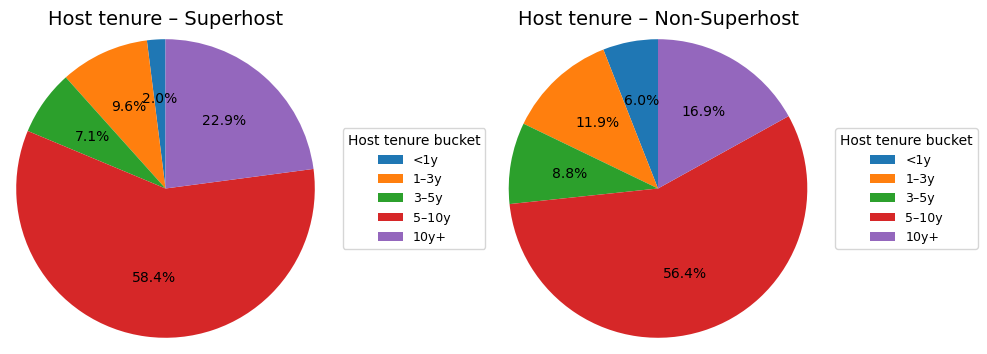

In [440]:
#Table
bucket_compare = pd.concat([sup_bucket, non_bucket], ignore_index=True)

share_table = (
    bucket_compare
      .pivot(index='bucket', columns='group', values='share')
      .reindex(labels_years)
)
share_table.columns.name = None

print("\nShare of listings in each host-tenure bucket (Superhost vs Non-Superhost):")
display(share_table.style.format('{:.2%}'))


# Pie charts
labels_pie = labels_years
sizes_super = sup_bucket['share'].values
sizes_non   = non_bucket['share'].values

def make_tenure_pie(ax, sizes, title):
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize': 10},
        radius=1.2
    )
    ax.set_title(title, fontsize=14)
    ax.legend(
        wedges,
        labels_pie,
        title='Host tenure bucket',
        loc='center left',
        bbox_to_anchor=(1.05, 0.5),
        fontsize=9
    )

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

make_tenure_pie(axes[0], sizes_super, 'Host tenure – Superhost')
make_tenure_pie(axes[1], sizes_non,   'Host tenure – Non-Superhost')

plt.tight_layout()
plt.show()

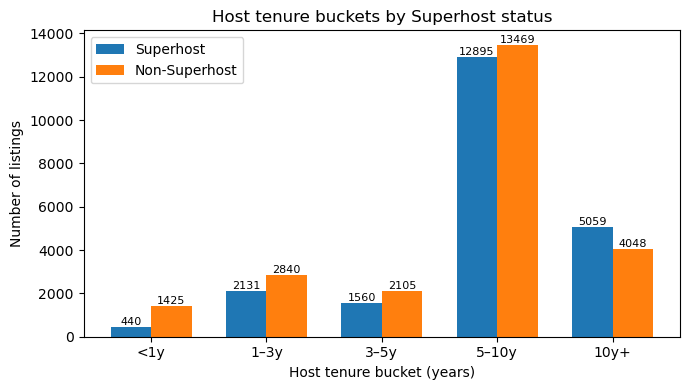

In [441]:
#bar chart
pivot_counts = (
    bucket_compare
      .pivot(index='bucket', columns='group', values='count')
      .reindex(labels_years)
      .fillna(0)
)

x = np.arange(len(labels_years))
width = 0.35

sup_vals = pivot_counts['Superhost'].values
non_vals = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7, 4))

bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')

plt.xlabel('Host tenure bucket (years)')
plt.ylabel('Number of listings')
plt.title('Host tenure buckets by Superhost status')
plt.xticks(x, labels_years)
plt.legend()

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h == 0:
        continue
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        h,
        f'{int(h)}',
        ha='center',
        va='bottom',
        fontsize=8
    )

plt.tight_layout()
plt.show()

In [442]:
report='''
Superhosts tend to have slightly longer hosting tenure than Non-Superhosts.
The average tenure for Superhosts is about 7.8 years (median 8.5y), compared with 7.0 years (median 7.9y) for Non-Superhosts.
Looking at tenure buckets, only 18.7% of Superhost listings are hosted by “newer” hosts with less than 5 years’ experience, 
compared with 26.7% among Non-Superhosts.

In contrast, Superhosts are more concentrated in the 10+ years bucket (22.9% vs 16.9%).
This pattern suggests that time on the platform helps: long-tenure hosts are more likely to become Superhosts, 
while many newer hosts are still Non-Superhosts.

However, the fact that both groups peak in the 5–10 year bucket also indicates that tenure alone does not guarantee Superhost status .
'''
print(report)


Superhosts tend to have slightly longer hosting tenure than Non-Superhosts.
The average tenure for Superhosts is about 7.8 years (median 8.5y), compared with 7.0 years (median 7.9y) for Non-Superhosts.
Looking at tenure buckets, only 18.7% of Superhost listings are hosted by “newer” hosts with less than 5 years’ experience, 
compared with 26.7% among Non-Superhosts.

In contrast, Superhosts are more concentrated in the 10+ years bucket (22.9% vs 16.9%).
This pattern suggests that time on the platform helps: long-tenure hosts are more likely to become Superhosts, 
while many newer hosts are still Non-Superhosts.

However, the fact that both groups peak in the 5–10 year bucket also indicates that tenure alone does not guarantee Superhost status .



In [443]:
#host_identity_verified
df = df.copy()

if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str).str.strip().str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")

raw = df['host_identity_verified']

norm = raw.astype('string').str.strip().str.lower()
truthy = {'t','true','1','y','yes','verified'}
falsy  = {'f','false','0','n','no','unverified'}

idv_flag = pd.Series(pd.NA, index=df.index)
idv_flag = np.where(norm.isna(), pd.NA,
             np.where(norm.isin(truthy), 1,
               np.where(norm.isin(falsy), 0, pd.NA)))
df['idv_flag'] = pd.Series(idv_flag).astype('Int8')

df['idv_label'] = pd.Series(idv_flag).map({1: 'Verified', 0: 'Not verified'}).astype('string')
df.loc[df['idv_label'].isna(), 'idv_label'] = 'NaN'  

counts = (
    df.groupby(['is_super','idv_label'])
      .size()
      .rename('count')
      .reset_index()
)


totals = counts.groupby('is_super')['count'].transform('sum')
counts['share'] = counts['count'] / totals


order_labels = ['Verified','Not verified','NaN']
share_table = (
    counts.pivot(index='idv_label', columns='is_super', values='share')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
)
share_table.index.name = 'host_identity_verified'

print("\nHost identity verified – share by group:")
display(share_table.style.format('{:.2%}'))

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Host identity verified – share by group:


is_super,Non-Superhost,Superhost
host_identity_verified,,
Verified,94.24%,97.07%
Not verified,5.71%,2.91%
NaN,0.05%,0.03%



Host identity verified – counts by group:


is_super,Non-Superhost,Superhost
idv_label,,
Verified,"22,523","21,443"
Not verified,"1,364",642
NaN,13,6


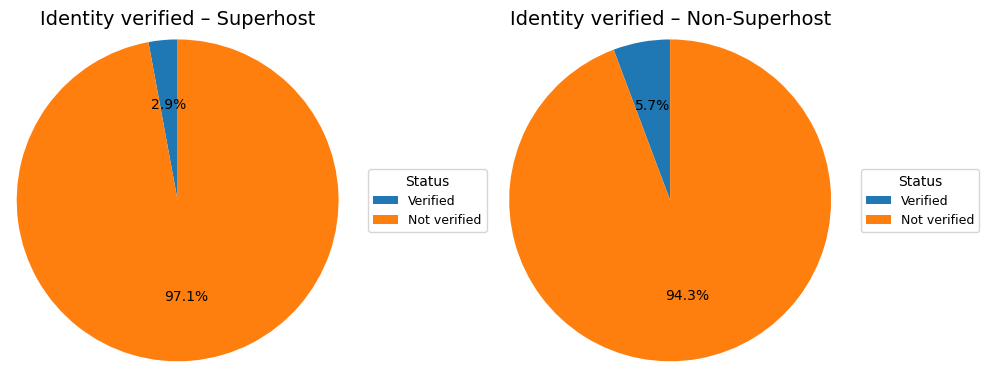

In [444]:
#table
count_table = (
    counts.pivot(index='idv_label', columns='is_super', values='count')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
)
print("\nHost identity verified – counts by group:")
display(count_table.style.format('{:,.0f}'))

#Pie charts
def make_idv_pie(ax, group_name):
    sub = counts[(counts['is_super'] == (1 if group_name=='Superhost' else 0)) &
                 (counts['idv_label'].isin(['Verified','Not verified']))]
    sizes = sub.sort_values('idv_label')['share'].values
    labels = ['Verified','Not verified']
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize':10},
        radius=1.2
    )
    ax.set_title(f'Identity verified – {group_name}', fontsize=14)
    ax.legend(wedges, labels, title='Status', loc='center left',
              bbox_to_anchor=(1.05, 0.5), fontsize=9)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
make_idv_pie(axes[0], 'Superhost')
make_idv_pie(axes[1], 'Non-Superhost')
plt.tight_layout()
plt.show()

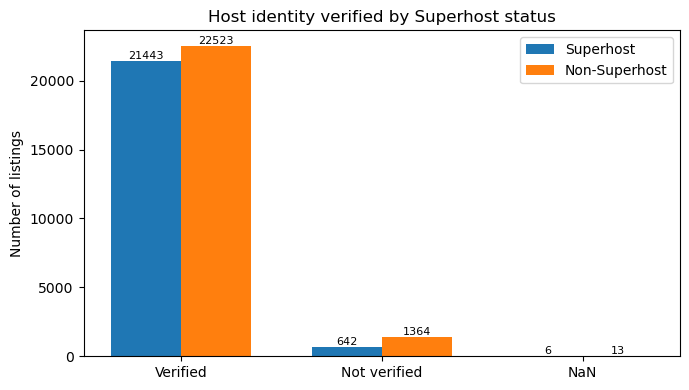

In [445]:
#Bar chart
pivot_counts = (
    counts.pivot(index='idv_label', columns='is_super', values='count')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
          .fillna(0)
)

x = np.arange(len(order_labels))
width = 0.35
sup_vals = pivot_counts['Superhost'].values
non_vals = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7,4))
bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')
plt.xticks(x, order_labels)
plt.ylabel('Number of listings')
plt.title('Host identity verified by Superhost status')

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h > 0:
        plt.text(bar.get_x()+bar.get_width()/2, h, f'{int(h)}',
                 ha='center', va='bottom', fontsize=8)

plt.legend()
plt.tight_layout()
plt.show()

In [446]:
report='''
Superhosts are slightly more likely to have their identity verified (97% vs 94%).
The share of “Not verified” hosts is roughly twice as high among Non-Superhosts (5.7% vs 2.9%), 
suggesting that skipping identity verification reduces the chance of becoming a Superhost.

However, since more than 94% of both groups are verified, identity verification is more of a hygiene factor: 
almost necessary, but far from sufficient to explain Superhost status on its own.
'''
print(report)


Superhosts are slightly more likely to have their identity verified (97% vs 94%).
The share of “Not verified” hosts is roughly twice as high among Non-Superhosts (5.7% vs 2.9%), 
suggesting that skipping identity verification reduces the chance of becoming a Superhost.

However, since more than 94% of both groups are verified, identity verification is more of a hygiene factor: 
almost necessary, but far from sufficient to explain Superhost status on its own.



In [447]:
#host_has_profile_pic	
df = df.copy()
if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str).str.strip().str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


raw = df['host_has_profile_pic'].astype('string').str.strip().str.lower()
truthy = {'t','true','1','y','yes'}
falsy  = {'f','false','0','n','no'}

pp_flag = np.where(raw.isna(), pd.NA,
            np.where(raw.isin(truthy), 1,
              np.where(raw.isin(falsy), 0, pd.NA)))
df['pp_flag'] = pd.Series(pp_flag, index=df.index).astype('Int8')


df['pp_label'] = df['pp_flag'].map({1:'Has profile pic', 0:'No profile pic'}).astype('string')
df.loc[df['pp_label'].isna(), 'pp_label'] = 'NaN'  


counts = (
    df.groupby(['is_super','pp_label'])
      .size().rename('count').reset_index()
)

totals = counts.groupby('is_super')['count'].transform('sum')
counts['share'] = counts['count'] / totals

order_labels = ['Has profile pic', 'No profile pic', 'NaN']

share_table = (
    counts.pivot(index='pp_label', columns='is_super', values='share')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
)
share_table.index.name = 'host_has_profile_pic'

print("\nHost has profile pic – share by group:")
display(share_table.style.format('{:.2%}'))

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Host has profile pic – share by group:


is_super,Non-Superhost,Superhost
host_has_profile_pic,,
Has profile pic,93.76%,97.83%
No profile pic,6.19%,2.15%
NaN,0.05%,0.03%



Host has profile pic – counts by group:


is_super,Non-Superhost,Superhost
pp_label,,
Has profile pic,"22,408","21,611"
No profile pic,"1,479",474
NaN,13,6


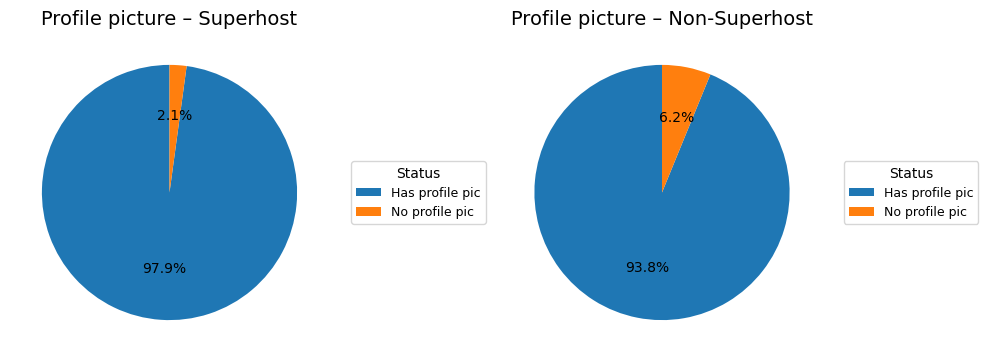

In [448]:
#table
count_table = (
    counts.pivot(index='pp_label', columns='is_super', values='count')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
)
print("\nHost has profile pic – counts by group:")
display(count_table.style.format('{:,.0f}'))

#Pie charts
def make_pp_pie(ax, group_name):
    sub = counts[(counts['is_super'] == (1 if group_name=='Superhost' else 0)) &
                 (counts['pp_label'].isin(['Has profile pic','No profile pic']))]
    sizes = sub.sort_values('pp_label')['share'].values
    labels = ['Has profile pic','No profile pic']
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct='%1.1f%%',
        startangle=90,
        textprops={'fontsize':10},
        radius=1
    )
    ax.set_title(f'Profile picture – {group_name}', fontsize=14)
    ax.legend(wedges, labels, title='Status', loc='center left',
              bbox_to_anchor=(1.05, 0.5), fontsize=9)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
make_pp_pie(axes[0], 'Superhost')
make_pp_pie(axes[1], 'Non-Superhost')
plt.tight_layout()
plt.show()

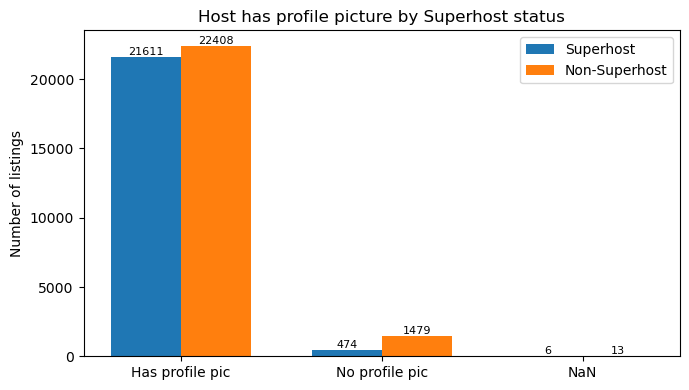

In [449]:
#Bar chart
pivot_counts = (
    counts.pivot(index='pp_label', columns='is_super', values='count')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
          .fillna(0)
)

x = np.arange(len(order_labels))
width = 0.35
sup_vals = pivot_counts['Superhost'].values
non_vals = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7,4))
bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')
plt.xticks(x, order_labels)
plt.ylabel('Number of listings')
plt.title('Host has profile picture by Superhost status')

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h > 0:
        plt.text(bar.get_x()+bar.get_width()/2, h, f'{int(h)}',
                 ha='center', va='bottom', fontsize=8)

plt.legend()
plt.tight_layout()
plt.show()


In [450]:
report='''
Superhosts are slightly more likely to have a profile photo (97.8% vs 93.8%),
and the share of “No profile pic” hosts is almost three times higher among Non-Superhosts (6.2% vs 2.1%).

This suggests that not showing a face on the profile reduces trust and is more common in the Non-Superhost group.

However, since more than 93% of both groups already have a photo, a profile picture functions more as a signal factor – 
almost mandatory for trust, but not sufficient on its own to guarantee Superhost status.
'''
print(report)


Superhosts are slightly more likely to have a profile photo (97.8% vs 93.8%),
and the share of “No profile pic” hosts is almost three times higher among Non-Superhosts (6.2% vs 2.1%).

This suggests that not showing a face on the profile reduces trust and is more common in the Non-Superhost group.

However, since more than 93% of both groups already have a photo, a profile picture functions more as a signal factor – 
almost mandatory for trust, but not sufficient on its own to guarantee Superhost status.



In [451]:
#host_verifications
df = df.copy()
if 'is_super' not in df.columns:
    df['is_super'] = (
        df['host_is_superhost']
          .astype(str).str.strip().str.lower()
          .map({'t': 1, 'true': 1, '1': 1,
                'f': 0, 'false': 0, '0': 0})
          .astype('Int8')
    )

print(f"Total hosts: {len(df)}")
print(f"Superhosts: {(df['is_super'] == 1).sum()}")
print(f"Non-Superhosts: {(df['is_super'] == 0).sum()}")


import ast, re

def _to_list(x):
    if pd.isna(x):
        return pd.NA
    s = str(x).strip()
    if s.startswith('[') or s.startswith('(') or s.startswith('{'):
        try:
            v = ast.literal_eval(s)
            if isinstance(v, (list, tuple, set)):
                return [str(i).strip().lower() for i in list(v)]
        except Exception:
            pass
    parts = [p.strip().lower() for p in re.split(r'[,\|;/]+', s) if p.strip()!='']
    return parts if parts else pd.NA

ver_list = df['host_verifications'].apply(_to_list)

def _count_safe(v):
    if v is pd.NA:
        return pd.NA
    return len(v)

df['verif_count'] = ver_list.apply(_count_safe).astype('Int64')


def _has_govid(v):
    if v is pd.NA:
        return pd.NA
    tokens = set(v)
    joined = ' '.join(tokens)
    return 1 if re.search(r'government|identity|id_card|id\-card|gov', joined) else 0

df['has_govid'] = ver_list.apply(_has_govid).astype('Int8')

bins = [-0.1, 0.9, 1.9, 3.9, np.inf]   
labels = ['0', '1', '2–3', '4+']

df['verif_bucket'] = pd.cut(
    df['verif_count'].astype('float'),
    bins=bins, labels=labels, include_lowest=True, right=True
)

counts = (
    df.groupby(['is_super', 'verif_bucket'], observed=False)
      .size().rename('count').reset_index()
)
totals = counts.groupby('is_super')['count'].transform('sum')
counts['share'] = counts['count'] / totals

order_labels = labels

share_table = (
    counts.pivot(index='verif_bucket', columns='is_super', values='share')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
)
share_table.index.name = 'verif_count_bucket'

print("\nHost verifications – share by bucket:")
display(share_table.style.format('{:.2%}'))

Total hosts: 47097
Superhosts: 22091
Non-Superhosts: 23900

Host verifications – share by bucket:


is_super,Non-Superhost,Superhost
verif_count_bucket,,
0,0.05%,0.00%
1,17.57%,7.16%
2–3,82.37%,92.83%
4+,0.00%,0.00%



Host verifications – counts by bucket:


is_super,Non-Superhost,Superhost
verif_bucket,,
0,13,1
1,"4,198","1,582"
2–3,"19,676","20,501"
4+,0,1


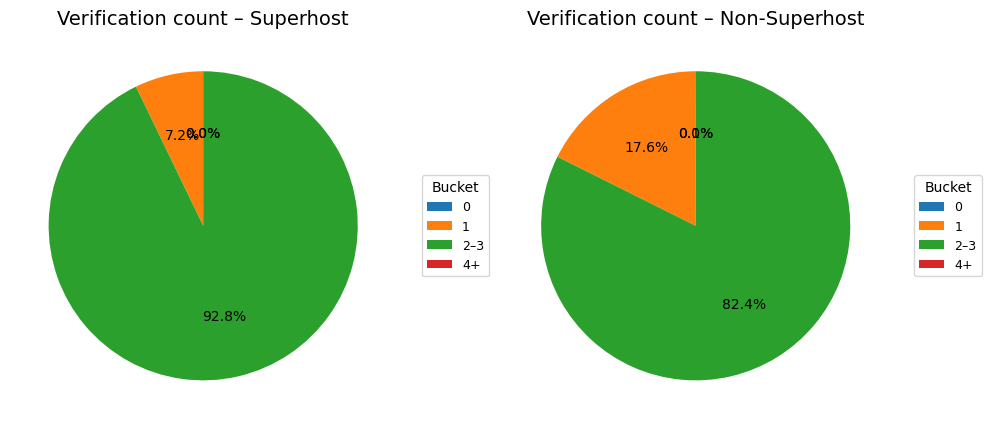

In [452]:
#table
count_table = (
    counts.pivot(index='verif_bucket', columns='is_super', values='count')
          .reindex(order_labels)
          .rename(columns={1:'Superhost', 0:'Non-Superhost'})
)
print("\nHost verifications – counts by bucket:")
display(count_table.style.format('{:,.0f}'))

#pie charts
def make_bucket_pie(ax, group_name):
    g = 1 if group_name=='Superhost' else 0
    sub = counts[counts['is_super']==g].sort_values('verif_bucket')
    sizes = sub['share'].values
    labs  = sub['verif_bucket'].astype(str).tolist()
    wedges, texts, autotexts = ax.pie(
        sizes, autopct='%1.1f%%', startangle=90,
        textprops={'fontsize':10}, radius=1
    )
    ax.set_title(f'Verification count – {group_name}', fontsize=14)
    ax.legend(wedges, labs, title='Bucket', loc='center left',
              bbox_to_anchor=(1.05, 0.5), fontsize=9)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
make_bucket_pie(axes[0], 'Superhost')
make_bucket_pie(axes[1], 'Non-Superhost')
plt.tight_layout()
plt.show()

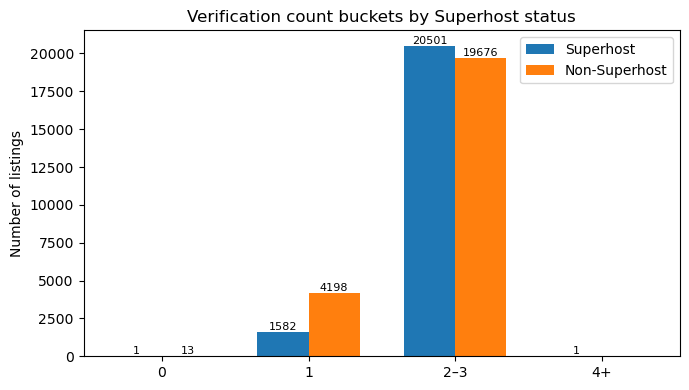

In [453]:
#Bar chart
pivot_counts = count_table.fillna(0)
x = np.arange(len(order_labels))
width = 0.35
sup_vals = pivot_counts['Superhost'].values
non_vals = pivot_counts['Non-Superhost'].values

plt.figure(figsize=(7,4))
bars_sup = plt.bar(x - width/2, sup_vals, width, label='Superhost')
bars_non = plt.bar(x + width/2, non_vals, width, label='Non-Superhost')
plt.xticks(x, order_labels)
plt.ylabel('Number of listings')
plt.title('Verification count buckets by Superhost status')

for bar in list(bars_sup) + list(bars_non):
    h = bar.get_height()
    if h>0:
        plt.text(bar.get_x()+bar.get_width()/2, h, f'{int(h)}',
                 ha='center', va='bottom', fontsize=8)
plt.legend(); plt.tight_layout(); plt.show()



Branch A - Host Factor Analysis

In addition to response behavior, host profile completeness, verification status, and hosting experience are also important factors influencing Superhost designation.

Superhost count: 22091
Non-Superhost count: 25006

Host Factor Comparison (Means):


,Factor,Superhost_Mean,NonSuperhost_Mean,Difference
0,Hosting_Years,7.98,7.19,0.79
1,Verification_Count,2.06,1.91,0.15
2,Identity_Verified,0.97,0.94,0.03
3,Has_Profile_Pic,0.98,0.94,0.04


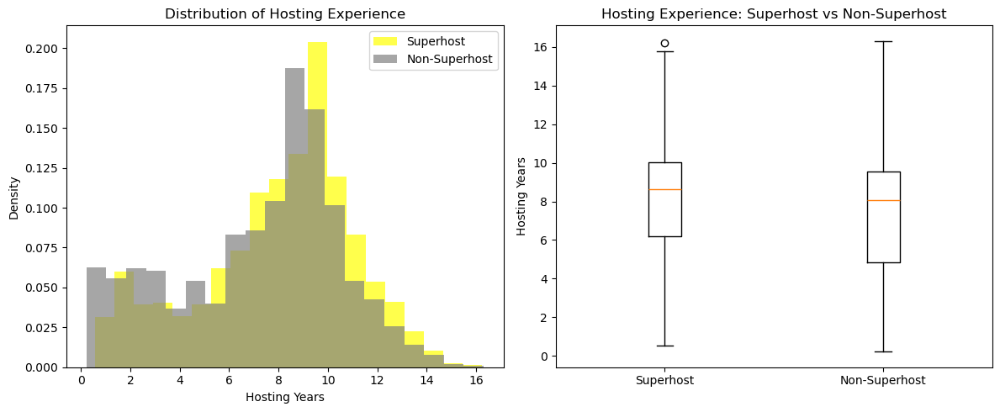


Verification Methods Distribution:


,Verification_Count,Superhost_Count,NonSuperhost_Count,Superhost_Pct,NonSuperhost_Pct
0,1,1583,4260,7.2%,17.0%
1,2,17486,18625,79.2%,74.5%
2,3,3015,2108,13.6%,8.4%
3,4,1,0,0.0%,0.0%


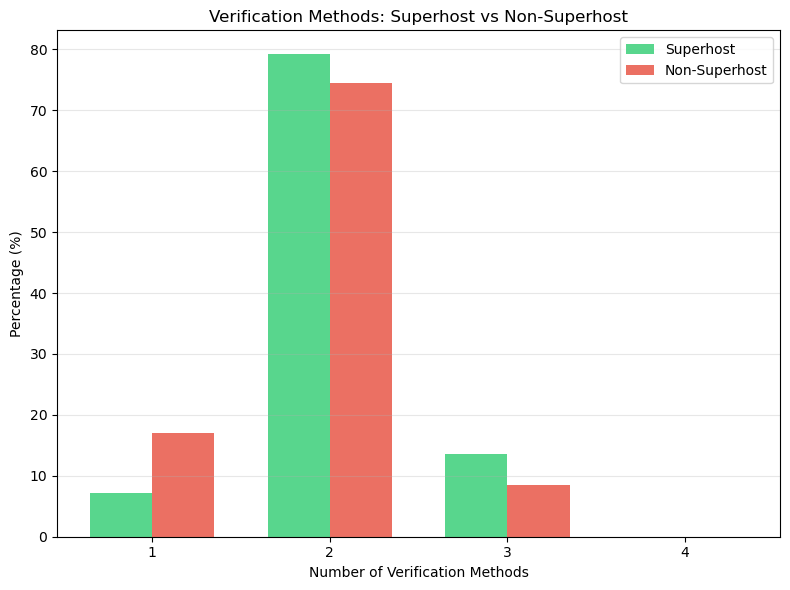

In [454]:
print("\nBranch A - Host Factor Analysis\n")
print("In addition to response behavior, host profile completeness, verification status, and hosting experience are also important factors influencing Superhost designation.\n")

cols = {c.lower(): c for c in df.columns}
SUPER_COL = (
    cols.get("is_super") or
    cols.get("host_is_superhost") or
    cols.get("is_superhost")
)

if SUPER_COL is None:
    raise ValueError("cannot find Superhost column")

# is_super
df["is_super"] = (
    df[SUPER_COL]
      .astype(str)
      .str.strip()
      .str.lower()
      .map({'t':1,'true':1,'1':1,'y':1,'yes':1,
            'f':0,'false':0,'0':0,'n':0,'no':0})
      .fillna(0)
      .astype("int8")
)
# (host_since)
df['host_since'] = pd.to_datetime(df['host_since'], errors='coerce')
df['hosting_years'] = (pd.Timestamp.now() - df['host_since']).dt.days / 365.25

# Number of verification 
df['verification_count'] = df['host_verifications'].str.split(',').str.len()

# Identity verification 
df['identity_verified'] = (
    df['host_identity_verified']
    .astype(str)
    .str.strip()
    .str.lower()
    .map({'t': 1, 'true': 1, '1': 1, 'f': 0, 'false': 0, '0': 0})
    .astype('Int8')
)

# Profile picture availability
df['has_profile_pic'] = (
    df['host_has_profile_pic']
    .astype(str)
    .str.strip()
    .str.lower()
    .map({'t': 1, 'true': 1, '1': 1, 'f': 0, 'false': 0, '0': 0})
    .astype('Int8')
)


# Extract Superhost vs Non-Superhost
super_host = df[df['is_super'] == 1].copy()
non_super_host = df[df['is_super'] == 0].copy()

print(f"Superhost count: {len(super_host)}")
print(f"Non-Superhost count: {len(non_super_host)}")

#  Comparison Analysis

host_factors = [
    'hosting_years',
    'verification_count',
    'identity_verified',
    'has_profile_pic'
]

factor_names = [
    'Hosting_Years',
    'Verification_Count',
    'Identity_Verified',
    'Has_Profile_Pic'
]

host_summary = pd.DataFrame({
    'Factor': factor_names,
    'Superhost_Mean': [super_host[col].mean() for col in host_factors],
    'NonSuperhost_Mean': [non_super_host[col].mean() for col in host_factors],
    'Difference': [super_host[col].mean() - non_super_host[col].mean() for col in host_factors]
})

print("\nHost Factor Comparison (Means):")
display(host_summary.style.format({
    'Superhost_Mean': '{:.2f}',
    'NonSuperhost_Mean': '{:.2f}',
    'Difference': '{:.2f}'
}).bar(subset=['Difference'], align='mid', color=['#d65f5f', '#5fba7d']))

# Visualization

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(super_host['hosting_years'].dropna(), bins=20, alpha=0.7, label='Superhost', color='yellow', density=True)
plt.hist(non_super_host['hosting_years'].dropna(), bins=20, alpha=0.7, label='Non-Superhost', color='grey', density=True)
plt.xlabel('Hosting Years')
plt.ylabel('Density')
plt.title('Distribution of Hosting Experience')
plt.legend()

plt.subplot(1, 2, 2)
host_exp_data = [super_host['hosting_years'].dropna(), non_super_host['hosting_years'].dropna()]
box_plot = plt.boxplot(host_exp_data, tick_labels=['Superhost', 'Non-Superhost'])
plt.ylabel('Hosting Years')
plt.title('Hosting Experience: Superhost vs Non-Superhost')

plt.tight_layout()
plt.show()

# Verification Methods Count Comparison
print("\nVerification Methods Distribution:")
# Fix: Ensure max_verifications is integer
max_verifications = int(min(df['verification_count'].max(), 15))  # Convert to integer
verification_range = range(1, max_verifications + 1)

verification_summary = pd.DataFrame({
    'Verification_Count': verification_range,
    'Superhost_Count': [super_host['verification_count'].eq(i).sum() for i in verification_range],
    'NonSuperhost_Count': [non_super_host['verification_count'].eq(i).sum() for i in verification_range],
    'Superhost_Pct': [super_host['verification_count'].eq(i).sum() / len(super_host) * 100 for i in verification_range],
    'NonSuperhost_Pct': [non_super_host['verification_count'].eq(i).sum() / len(non_super_host) * 100 for i in verification_range]
})

display(verification_summary.style.format({
    'Superhost_Pct': '{:.1f}%',
    'NonSuperhost_Pct': '{:.1f}%'
}))

# Verification methods count visualization
plt.figure(figsize=(8, 6))
x = np.arange(len(verification_range))
width = 0.35

plt.bar(x - width/2, verification_summary['Superhost_Pct'], width, label='Superhost', alpha=0.8, color='#2ecc71')
plt.bar(x + width/2, verification_summary['NonSuperhost_Pct'], width, label='Non-Superhost', alpha=0.8, color='#e74c3c')

plt.xlabel('Number of Verification Methods')
plt.ylabel('Percentage (%)')
plt.title('Verification Methods: Superhost vs Non-Superhost')
plt.legend()
plt.xticks(x, verification_range)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()


Combined Factor Analysis (without host_about):
Profile Completeness (pic + identity + ≥3 verifications) vs Superhost Rate:


,Completeness_Score,Superhost_Rate,Count,Superhost_Rate_Pct
0,0,18.99%,237,19.0%
1,1,27.15%,"3,238",27.1%
2,2,47.17%,"38,819",47.2%
3,3,59.48%,"4,803",59.5%



Hosting Experience vs Superhost Rate:


,Hosting_Experience,Superhost_Rate,Count,Superhost_Rate_Pct
0,<1yr,17.32%,"1,484",17.3%
1,1-3yr,42.14%,"4,981",42.1%
2,3-5yr,39.79%,"3,978",39.8%
3,5-10yr,47.43%,"26,356",47.4%
4,10+yr,54.93%,"10,279",54.9%


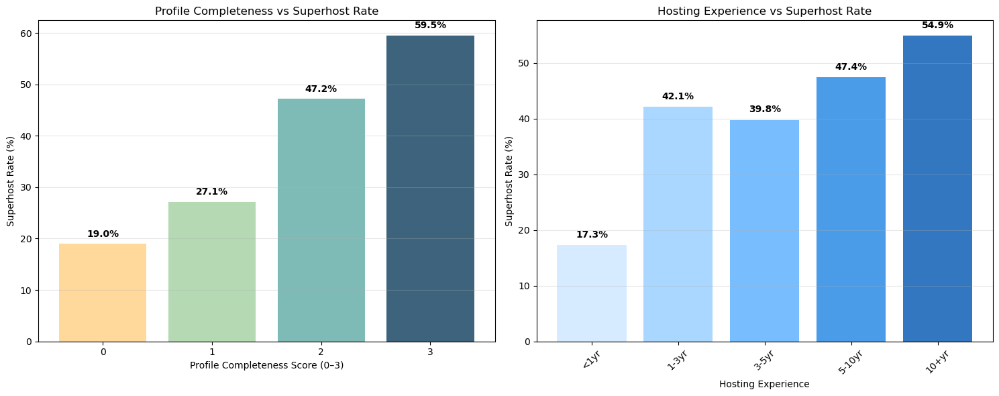


Multi-Factor Cross Analysis: Experience + Profile Completeness
Top 10 Combinations (Sorted by Superhost Rate):


,Group,Superhost_Rate,Count
7,10+yr + Score:3,63.71%,"1,918"
15,5-10yr + Score:3,57.49%,"2,684"
6,10+yr + Score:2,53.34%,"8,087"
11,3-5yr + Score:3,50.00%,156
14,5-10yr + Score:2,47.60%,"22,366"
2,1-3yr + Score:2,44.97%,"3,996"
5,10+yr + Score:1,40.59%,271
10,3-5yr + Score:2,39.99%,"3,436"
9,3-5yr + Score:1,34.64%,358
3,1-3yr + Score:3,34.21%,38


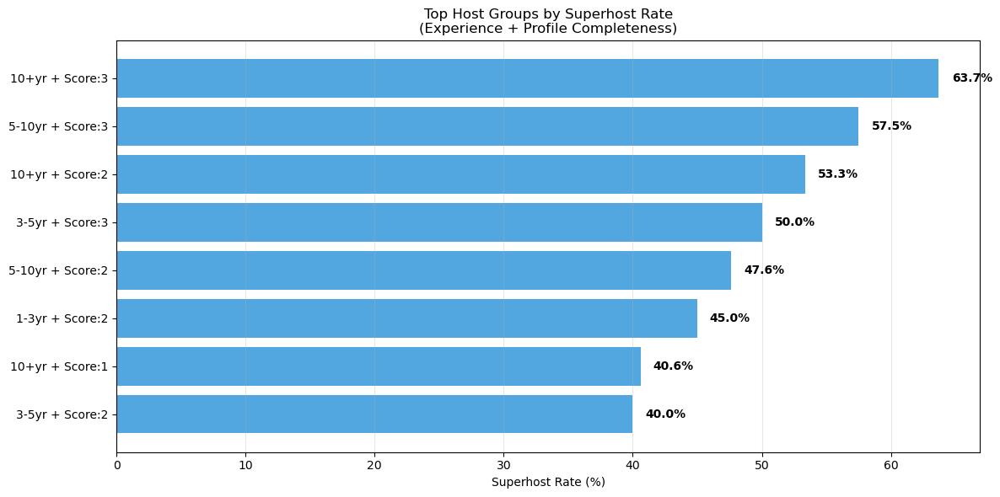

Verification & Profile Picture Combination Analysis:


,Group,Superhost_Rate,Count
0,"High_Verif:0.0, Profile_Pic:0.0",24.09%,"1,955"
1,"High_Verif:0.0, Profile_Pic:1.0",46.50%,"39,999"
2,"High_Verif:1.0, Profile_Pic:0.0",25.00%,12
3,"High_Verif:1.0, Profile_Pic:1.0",58.94%,"5,112"


In [455]:
# Combined Factor Analysis

print("\nCombined Factor Analysis (without host_about):")

# hosting years
if 'hosting_years' not in df.columns:
    df['host_since'] = pd.to_datetime(df['host_since'], errors='coerce')
    df['hosting_years'] = (pd.Timestamp.now() - df['host_since']).dt.days / 365.25

# verification count
if 'verification_count' not in df.columns:
    df['verification_count'] = df['host_verifications'].astype(str).str.split(',').str.len()

# identity verified -
if 'identity_verified' not in df.columns:
    df['identity_verified'] = (
        df['host_identity_verified'].astype(str).str.strip().str.lower()
          .map({'t':1,'true':1,'1':1,'f':0,'false':0,'0':0})
          .astype('Int8')
    )

# has profile pic 
if 'has_profile_pic' not in df.columns:
    df['has_profile_pic'] = (
        df['host_has_profile_pic'].astype(str).str.strip().str.lower()
          .map({'t':1,'true':1,'1':1,'f':0,'false':0,'0':0})
          .astype('Int8')
    )

#  Profile completeness score (0–3)
# components: has_profile_pic  + identity_verified + (verification_count>=3) 
df['profile_completeness'] = (
    df['has_profile_pic'].fillna(0).astype(int) +
    df['identity_verified'].fillna(0).astype(int) +
    (df['verification_count'].fillna(0) >= 3).astype(int)
)

# Hosting experience 
bins   = [0, 1, 3, 5, 10, 50]
labels = ['<1yr', '1-3yr', '3-5yr', '5-10yr', '10+yr']
df['hosting_exp_group'] = pd.cut(df['hosting_years'], bins=bins, labels=labels, right=False)

# Profile completeness vs Superhost rate 
completeness_summary = (
    df.groupby('profile_completeness', observed=False)['is_super']
      .agg(['mean','count'])
      .reset_index()
      .rename(columns={'mean':'Superhost_Rate','count':'Count',
                       'profile_completeness':'Completeness_Score'})
)
completeness_summary['Superhost_Rate_Pct'] = completeness_summary['Superhost_Rate'] * 100

print("Profile Completeness (pic + identity + ≥3 verifications) vs Superhost Rate:")
display(completeness_summary.style.format({
    'Superhost_Rate': '{:.2%}',
    'Superhost_Rate_Pct': '{:.1f}%',
    'Count': '{:,}'
}))

# Hosting experience vs Superhost rate 
exp_summary = (
    df.groupby('hosting_exp_group', observed=False)['is_super']
      .agg(['mean','count'])
      .reset_index()
      .rename(columns={'mean':'Superhost_Rate','count':'Count',
                       'hosting_exp_group':'Hosting_Experience'})
)
exp_summary['Superhost_Rate_Pct'] = exp_summary['Superhost_Rate'] * 100

print("\nHosting Experience vs Superhost Rate:")
display(exp_summary.style.format({
    'Superhost_Rate': '{:.2%}',
    'Superhost_Rate_Pct': '{:.1f}%',
    'Count': '{:,}'
}))

# Visualizations 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# profile completeness (0–3)
colors1 = ['#ffd28a', '#a7d3a6', '#68b0ab', '#1b4965']  
ax1.bar(completeness_summary['Completeness_Score'].astype(str),
        completeness_summary['Superhost_Rate_Pct'],
        color=colors1[:len(completeness_summary)], alpha=0.85)
ax1.set_xlabel('Profile Completeness Score (0–3)')
ax1.set_ylabel('Superhost Rate (%)')
ax1.set_title('Profile Completeness vs Superhost Rate')
ax1.grid(axis='y', alpha=0.3)
for i, v in enumerate(completeness_summary['Superhost_Rate_Pct']):
    ax1.text(i, v + 1, f'{v:.1f}%', ha='center', va='bottom', fontweight='bold')

# experience buckets
colors2 = ['#cfe8ff', '#9bd1ff', '#61b3ff', '#2a8be6', '#0f5fb5']
ax2.bar(exp_summary['Hosting_Experience'].astype(str),
        exp_summary['Superhost_Rate_Pct'],
        color=colors2[:len(exp_summary)], alpha=0.85)
ax2.set_xlabel('Hosting Experience')
ax2.set_ylabel('Superhost Rate (%)')
ax2.set_title('Hosting Experience vs Superhost Rate')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(axis='y', alpha=0.3)
for i, v in enumerate(exp_summary['Superhost_Rate_Pct']):
    ax2.text(i, v + 1, f'{v:.1f}%', ha='center', va='bottom', fontweight='bold')

plt.tight_layout()
plt.show()

#Multi-Factor Cross Analysis
print("\nMulti-Factor Cross Analysis: Experience + Profile Completeness")
df['exp_completeness_group'] = (
    df['hosting_exp_group'].astype(str) + ' + Score:' + df['profile_completeness'].astype(str)
)

cross_summary = (
    df.groupby('exp_completeness_group', observed=False)['is_super']
      .agg(['mean','count'])
      .reset_index()
      .rename(columns={'mean':'Superhost_Rate','count':'Count',
                       'exp_completeness_group':'Group'})
      .sort_values('Superhost_Rate', ascending=False)
)

print("Top 10 Combinations (Sorted by Superhost Rate):")
display(cross_summary.head(10).style.format({
    'Superhost_Rate': '{:.2%}',
    'Count': '{:,}'
}))

plt.figure(figsize=(12, 6))
top_groups = cross_summary.head(8)
plt.barh(top_groups['Group'], top_groups['Superhost_Rate'] * 100, color='#3498db', alpha=0.85)
plt.xlabel('Superhost Rate (%)')
plt.title('Top Host Groups by Superhost Rate\n(Experience + Profile Completeness)')
plt.gca().invert_yaxis()
plt.grid(axis='x', alpha=0.3)
for i, v in enumerate(top_groups['Superhost_Rate'] * 100):
    plt.text(v + 1, i, f'{v:.1f}%', va='center', fontweight='bold')
plt.tight_layout()
plt.show()

# Verification × Profile Pic combo 
df['high_verification'] = (df['verification_count'] >= 3).astype(int)
verification_profile_summary = (
    df.groupby(['high_verification', 'has_profile_pic'], observed=False)['is_super']
      .agg(['mean','count'])
      .reset_index()
      .rename(columns={'mean':'Superhost_Rate','count':'Count',
                       'high_verification':'High_Verification',
                       'has_profile_pic':'Has_Profile_Pic'})
)
verification_profile_summary['Group'] = verification_profile_summary.apply(
    lambda x: f"High_Verif:{x['High_Verification']}, Profile_Pic:{x['Has_Profile_Pic']}", axis=1
)
print("Verification & Profile Picture Combination Analysis:")
display(verification_profile_summary[['Group','Superhost_Rate','Count']].style.format({
    'Superhost_Rate': '{:.2%}', 'Count': '{:,}'
}))

In [456]:
# Conclusions 
print("COMPLETE HOST FACTOR ANALYSIS CONCLUSIONS ")
report='''
Across all hosts (≈47k listings), Superhosts and Non-Superhosts differ on several host-side factors:

1.Hosting experience:

Superhosts: 7.98 years on average; Non-Superhosts: 7.19 years; Gap ≈ 0.8 years

Verification methods:
Superhosts use on average 2.06 verification methods; Non-Superhosts: 1.91

Identity verified:
Superhosts: 97%; Non-superhosts: 94%

Profile picture:
Superhosts: 98%; Non-Superhosts: 94%

These differences are smallest for identity verification and profile photo, and largest for hosting years.

2.Hosting Experience vs Superhost Rate table:

<1 year: Superhost rate 17.8%（very low）; 1–3 years: 43.4%; 3–5 years: 42.6%（similar to 1–3y; 5–10 years: 48.3%; 10+ years: 56.3% (highest)

Histogram and boxplots show distributions are overlapping but Superhosts are slightly shifted to the right,
with more hosts in the 8–12 year range and fewer in the very new segment.

Interpretation:
Hosting experience is a strong driver of Superhost status.
Very new hosts (<1 year) have a much lower chance (~18%).
Once hosts accumulate 1–5 years, the Superhost rate jumps to ~43%.
Long-tenure hosts (5–10+ years) reach ~48–56% Superhost rate, 
indicating that staying on the platform and surviving over time is positively associated with becoming Superhost.

3.Profile Completeness vs Superhost Rate  table:

Score 0 (none of the three): Superhost rate 19.1%
Score 1: 27.4%
Score 2: 48.3%
Score 3 (fully complete): 61.3%

This is a clear step-change pattern: going from score 0 → 1 gives a small lift, 
but moving to 2 or 3 nearly doubles or triples the Superhost rate compared with the lowest group.

4.Superhosts tend to use slightly more verification methods, and are less likely to stay at the “minimum one verification” level.

However, because both groups already cluster around 2 verifications, method count is more of a hygiene factor: doing too little (only one method) is a negative signal,
but just adding more methods on top gives diminishing marginal gains.

5.“Multi-Factor Cross Analysis”:

Top groups by Superhost rate:
10+ years + score 3 → 64.7% Superhost rate (n ≈ 1,873)
5–10 years + score 3 → 59.9% (n ≈ 2,592)
10+ years + score 2 → 54.8% (n ≈ 7,818)
3–5 years + score 3 → 50.3%,.

Key patterns:
Within the same experience band, raising completeness score from 1 → 2 → 3 consistently pushes the Superhost rate up.

Within the same completeness score, moving from short to long tenure (1–3y → 5–10y → 10+ y) also raises the Superhost rate.

The best-performing cluster is “10+ years + fully complete profile”, with about 65% of listings being Superhosts.

6.A profile picture alone (even without high verification) already doubles the Superhost rate (24% → 48%).

High verification without a photo does not improve much over the lowest group (24% → 25%, but sample is tiny).

The best combination is high verification + profile photo, reaching ~61% Superhost rate.

Interpretation:
For guests, seeing the host’s face is more immediately impactful than just having extra verification badges.
High verification acts as a reinforcing signal on top of a good profile, rather than replacing the need for a photo.

Conclusion:In summary, host-side factors matter for becoming a Superhost. Hosting experience is the strongest driver: 
Superhost rates rise from about 18% for <1-year hosts to more than 56% for 10+-year hosts. 

Profile completeness—having identity verified, a clear profile photo, 
and at least three verification methods—shows a clear step-change from 19% to 61% Superhost rate as the score increases from 0 to 3.
Verification count, identity verification and profile photos behave as hygiene factors: most hosts already have them,
but missing them sharply reduces the chance of being a Superhost. 

The highest Superhost rates (around 60–65%) are achieved by experienced hosts (5–10+ years) 
with fully complete profiles and strong trust signals (photo + multiple verifications).
'''
print(report)

COMPLETE HOST FACTOR ANALYSIS CONCLUSIONS 

Across all hosts (≈47k listings), Superhosts and Non-Superhosts differ on several host-side factors:

1.Hosting experience:

Superhosts: 7.98 years on average; Non-Superhosts: 7.19 years; Gap ≈ 0.8 years

Verification methods:
Superhosts use on average 2.06 verification methods; Non-Superhosts: 1.91

Identity verified:
Superhosts: 97%; Non-superhosts: 94%

Profile picture:
Superhosts: 98%; Non-Superhosts: 94%

These differences are smallest for identity verification and profile photo, and largest for hosting years.

2.Hosting Experience vs Superhost Rate table:

<1 year: Superhost rate 17.8%（very low）; 1–3 years: 43.4%; 3–5 years: 42.6%（similar to 1–3y; 5–10 years: 48.3%; 10+ years: 56.3% (highest)

Histogram and boxplots show distributions are overlapping but Superhosts are slightly shifted to the right,
with more hosts in the 8–12 year range and fewer in the very new segment.

Interpretation:
Hosting experience is a strong driver of Superho

In [552]:
report='''
This section extends the analysis beyond the characteristics of hosts to the attributes of the properties themselves. 

First, it compares the differences between Superhosts and non-Superhosts in terms of property type and configuration, 
including occupancy, number of bedrooms, number of beds, and number of bathrooms. 

Second, it links these configuration characteristics to geographical location (region, city, and neighborhood) and price (average nightly rate) 
to examine hosts' pricing and configuration strategies in different markets. 

Finally, it cross-compares two perspectives to differentiate the impact of location and configuration on price: 
one is the pricing difference for the same configuration in different locations, 
and the other is the pricing difference for the same location in different configurations, 
thus more systematically depicting the price formation mechanism in the Airbnb market.
'''
print(report)


This section extends the analysis beyond the characteristics of hosts to the attributes of the properties themselves. 

First, it compares the differences between Superhosts and non-Superhosts in terms of property type and configuration, 
including occupancy, number of bedrooms, number of beds, and number of bathrooms. 

Second, it links these configuration characteristics to geographical location (region, city, and neighborhood) and price (average nightly rate) 
to examine hosts' pricing and configuration strategies in different markets. 

Finally, it cross-compares two perspectives to differentiate the impact of location and configuration on price: 
one is the pricing difference for the same configuration in different locations, 
and the other is the pricing difference for the same location in different configurations, 
thus more systematically depicting the price formation mechanism in the Airbnb market.



In [553]:
print('price Comparsion')

price Comparsion


In [457]:
# Superhost vs Non-Superhost: Price analysis

def detect_col(columns, candidates):
    norm = {c.lower().replace("_", ""): c for c in columns}

    for cand in candidates:
        key = cand.lower().replace("_", "")
        if key in norm:
            return norm[key]

    for cand in candidates:
        key = cand.lower().replace("_", "")
        for k, c in norm.items():
            if key in k:
                return c

    return None


def bool01(s):
    mapping = {
        "t": 1, "true": 1, "1": 1, "y": 1, "yes": 1,
        "f": 0, "false": 0, "0": 0, "n": 0, "no": 0,
    }
    return (
        s.astype(str)
         .str.strip()
         .str.lower()
         .map(mapping)
         .fillna(0)
         .astype("int8")
    )


def get_or_raise(df, candidates, err_msg):
    col = detect_col(df.columns, candidates)
    if col is None:
        raise ValueError(err_msg)
    return col


# Load data 
df = pd.read_csv("listings.csv", encoding="cp1252")

PRICE  = get_or_raise(
    df,
    ["price", "nightly_price", "listing_price"],
    " Could not find a price column ( price / nightly_price).",
)
SUPER  = get_or_raise(
    df,
    ["is_super", "host_is_superhost", "is_superhost"],
    " Could not find a Superhost flag column (e.g. host_is_superhost / is_super).",
)
ID_COL = detect_col(df.columns, ["id", "listing_id", "listingid"])
if ID_COL is None:                 
    ID_COL = df.columns[0]

d = df.copy()
d["is_super"] = bool01(d[SUPER])

# Clean price
d[PRICE] = pd.to_numeric(
    d[PRICE]
     .astype(str)
     .str.replace(r"[\$,]", "", regex=True)
     .str.replace(" ", "", regex=False),
    errors="coerce",
)

# Keep only valid positive prices
d = d[d[PRICE].gt(0)].copy()
if d.empty:
    raise ValueError("No valid price data after cleaning. Please check the source file.")

#  IQR filter
q1, q3 = d[PRICE].quantile([0.25, 0.75])
iqr = q3 - q1
lower = max(q1 - 1.5 * iqr, 0)
upper = q3 + 1.5 * iqr

d_iqr = d[d[PRICE].between(lower, upper)].copy()
if d_iqr.empty:   # if filtering is too aggressive, fall back to full data
    d_iqr = d.copy()

#Price summary
summary = (
    d_iqr
    .assign(group=lambda x: x["is_super"].map({1: "Superhost", 0: "Non-Superhost"}))
    .groupby("group")[PRICE]
    .agg(count="count", mean="mean", median="median")
    .reset_index()
)

print("Price Summary By Group (IQR-Filtered):")
display(
    summary.style.format({
        "count": "{:,.0f}",
        "mean": "{:.2f}",
        "median": "{:.1f}",
    })
)

# Price buckets
fixed_edges = [105, 155, 215, 310, 480, 610]
data_min, data_max = d_iqr[PRICE].agg(["min", "max"]).astype(float)

edges = np.unique(np.r_[data_min, fixed_edges, data_max])
edges.sort()
if edges.size == 1:   
    v = edges[0]
    edges = np.array([0.9 * v, v, 1.1 * v])

# Build labels
labels = []
for i in range(len(edges) - 1):
    a, b = edges[i], edges[i + 1]
    if i < len(edges) - 2:
        labels.append(f"{int(round(a))}-{int(round(b))}")
    else:
        # if last edge is clearly above the previous segment, use ≥
        if b > edges[-2] * 1.05:
            labels.append(f"≥{int(round(edges[-2]))}")
        else:
            labels.append(f"{int(round(a))}-{int(round(b))}")

d_iqr["price_bucket"] = pd.cut(
    d_iqr[PRICE],
    bins=edges,
    labels=labels,
    include_lowest=True,
    right=False,
)

d_iqr = d_iqr[d_iqr["price_bucket"].notna()].copy()
if d_iqr.empty:
    raise ValueError(" No data left after price bucketing. Check bucket edges.")
    
#share bucket table
def price_bucket_share(df_sub, group_name):
    tab = (
        df_sub["price_bucket"]
        .value_counts()
        .sort_index()                
        .rename_axis("bucket")
        .reset_index(name="count")
    )
    total = tab["count"].sum()
    tab["share"] = tab["count"] / total

    print(f"Price buckets among {group_name}:")
    display(
        tab.style.format({
            "count": "{:,.0f}",
            "share": "{:.2%}",
        })
    )
    print()  


# Superhost price buckets
price_bucket_share(
    d_iqr[d_iqr["is_super"] == 1],
    "Superhosts"
)

# Non-Superhost price buckets 
price_bucket_share(
    d_iqr[d_iqr["is_super"] == 0],
    "Non-Superhosts"
)

Price Summary By Group (IQR-Filtered):


,group,count,mean,median
0,Non-Superhost,"21,660",225.43,195.0
1,Superhost,"19,840",204.85,173.0


Price buckets among Superhosts:


,bucket,count,share
0,14-105,"3,561",17.95%
1,105-155,"4,843",24.42%
2,155-215,"4,307",21.71%
3,215-310,"3,714",18.72%
4,310-480,"2,646",13.34%
5,≥480,765,3.86%



Price buckets among Non-Superhosts:


,bucket,count,share
0,14-105,"3,885",17.94%
1,105-155,"4,129",19.07%
2,155-215,"4,137",19.10%
3,215-310,"4,402",20.33%
4,310-480,"3,768",17.40%
5,≥480,"1,334",6.16%



Price Share By Bucket (Superhost Vs Non-Superhost):


group,Superhost,Non-Superhost
price_bucket,,
14-105,47.82%,52.18%
105-155,53.98%,46.02%
155-215,51.01%,48.99%
215-310,45.76%,54.24%
310-480,41.25%,58.75%
≥480,36.45%,63.55%


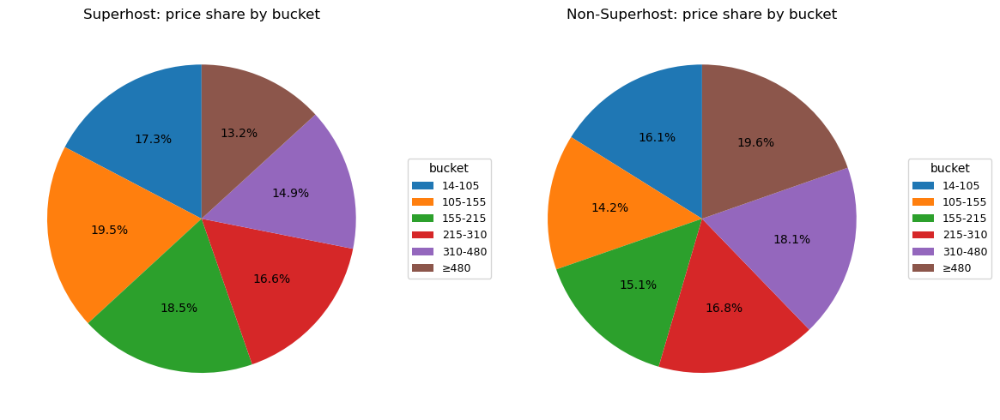

In [458]:
#Share table
d_iqr["price_bucket"] = pd.Categorical(d_iqr["price_bucket"], categories=labels, ordered=True)

pct = (d_iqr
       .groupby(["price_bucket", "is_super"], observed=False)[ID_COL]
       .count()
       .rename("cnt")
       .reset_index())

pct["group"] = pct["is_super"].map({1: "Superhost", 0: "Non-Superhost"})

share_table = (pct
               .pivot(index="price_bucket", columns="group", values="cnt")
               .reindex(labels)                  
               .reindex(columns=["Superhost","Non-Superhost"])  
               .fillna(0))


row_sum = share_table.sum(axis=1)
share_table = share_table.div(row_sum.replace(0, np.nan), axis=0).fillna(0)

print("\nPrice Share By Bucket (Superhost Vs Non-Superhost):")
display(share_table.style.format("{:.2%}"))

#pie chart
def plot_pie_for_group(pivot_share, group_name, ax):
    sizes = pivot_share[group_name].fillna(0).values
    if sizes.sum() == 0:
        ax.text(0.5, 0.5, "No data", ha="center", va="center")
        ax.axis('off')
        return
    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct="%1.1f%%",
        startangle=90
    )
    ax.set_title(f"{group_name}: price share by bucket")
    ax.legend(wedges, pivot_share.index.tolist(), title="bucket",
              loc="center left", bbox_to_anchor=(1.02, 0.5), fontsize=9)

fig, axes = plt.subplots(1, 2, figsize=(12, 5))
plot_pie_for_group(share_table, "Superhost", axes[0])
plot_pie_for_group(share_table, "Non-Superhost", axes[1])
plt.tight_layout()
plt.show()

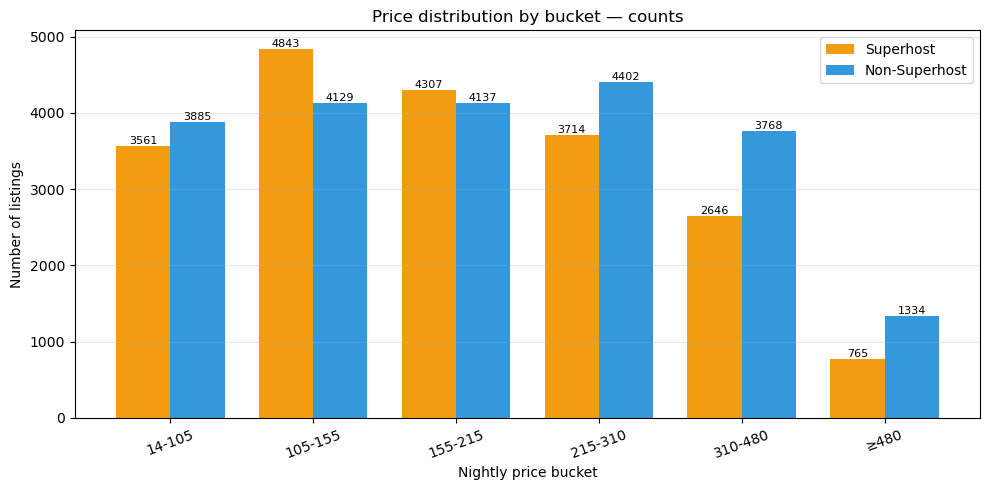

In [459]:
#bar chart
count_pivot = (
    d_iqr
        .groupby(["price_bucket", "is_super"], observed=False)[ID_COL]
        .count()
        .rename("cnt")
        .reset_index()
)

#labels
count_pivot["group"] = count_pivot["is_super"].map({1: "Superhost",
                                                    0: "Non-Superhost"})

#Pivot
bar_counts = (
    count_pivot
      .pivot(index="price_bucket", columns="group", values="cnt")
      .reindex(labels)          # keep bucket order
      .fillna(0)
)

#Plot
x = np.arange(len(bar_counts.index))
width = 0.38

plt.figure(figsize=(10, 5))

b1 = plt.bar(
    x - width/2,
    bar_counts["Superhost"].values,
    width,
    label="Superhost",
    color="#f39c12"        
)
b2 = plt.bar(
    x + width/2,
    bar_counts["Non-Superhost"].values,
    width,
    label="Non-Superhost",
    color="#3498db"        
)

plt.title("Price distribution by bucket — counts")
plt.xlabel("Nightly price bucket")
plt.ylabel("Number of listings")
plt.xticks(x, bar_counts.index, rotation=20)
plt.legend()
plt.grid(axis="y", alpha=0.3)

#Add value labels on top of bars
for bars in [b1, b2]:
    for r in bars:
        h = r.get_height()
        if h > 0:
            plt.text(
                r.get_x() + r.get_width()/2,
                h,
                f"{int(h)}",
                ha="center",
                va="bottom",
                fontsize=8
            )

plt.tight_layout()
plt.show()

In [460]:
report='''
After IQR filtering, we have:

Non-Superhosts:
count = 21,660 mean price ≈ NZD 225 median price ≈ NZD 195

Superhosts:
count = 19,840 mean price ≈ NZD 205 median price ≈ NZD 173

So Non-Superhosts charge about NZD 20–22 more per night on average, roughly 10–13% higher than Superhosts in both mean and median terms. 
This suggests that Superhost status is not associated with charging higher prices; instead, Superhosts tend to price slightly lower.

Looking at the bucket shares within each group:

Superhosts (share by bucket):
14–105: 18%
105–155: 24% ← largest
155–215: 22%
215–310: 19%
310–480: 13%
≥480: 4%

Non-Superhosts:
14–105: 18% 
105–155: 19%
155–215: 19%
215–310: 20% ← largest
310–480: 17%
≥480: 6%

The pie charts and count bars show:
Superhosts are more concentrated in the mid-range (105–215), especially 105–155, where their share is clearly higher than Non-Superhosts.
Non-Superhosts have heavier tails in the higher price buckets: 310–480 and ≥480 both take a larger share of their portfolio.
Within each price bucket, the share of Superhosts is:

14–105: 47.8% Superhost / 52.2% Non-Superhost
105–155: 54.0% Superhost / 46.0% Non-Superhost
155–215: 51.0% Superhost / 49.0% Non-Superhost
215–310: 45.8% Superhost / 54.2% Non-Superhost
310–480: 41.3% Superhost / 58.8% Non-Superhost
≥480: 36.5% Superhost / 63.6% Non-Superhost

Patterns:
In the lower mid-range (105–215), Superhosts are the majority: more than half of listings in these price bands are Superhosts.

From 215+, the Superhost share drops below 50%, and in the very high segment (≥480), only about 1/3 of listings are Superhosts.

So, very high nightly prices are associated with a lower probability of being a Superhost, 
while moderate pricing (105–215) is the most Superhost-dense zone.


Superhosts do not win by over-pricing; they tend to charge slightly lower prices than Non-Superhosts.

The “sweet spot” for Superhosts in this dataset is roughly NZD 105–215 per night:These bands contain the largest number of Superhost listings,
and within the band, Superhosts make up more than half of the market.
Very high prices (≥310, especially ≥480) are dominated by Non-Superhosts and show lower Superhost shares.

For a new host aiming to become a Superhost,
a reasonable strategy is to position prices in the competitive mid-range instead of starting at the very top of the market, 
and then rely on service quality to stand out.
'''
print(report)


After IQR filtering, we have:

Non-Superhosts:
count = 21,660 mean price ≈ NZD 225 median price ≈ NZD 195

Superhosts:
count = 19,840 mean price ≈ NZD 205 median price ≈ NZD 173

So Non-Superhosts charge about NZD 20–22 more per night on average, roughly 10–13% higher than Superhosts in both mean and median terms. 
This suggests that Superhost status is not associated with charging higher prices; instead, Superhosts tend to price slightly lower.

Looking at the bucket shares within each group:

Superhosts (share by bucket):
14–105: 18%
105–155: 24% ← largest
155–215: 22%
215–310: 19%
310–480: 13%
≥480: 4%

Non-Superhosts:
14–105: 18% 
105–155: 19%
155–215: 19%
215–310: 20% ← largest
310–480: 17%
≥480: 6%

The pie charts and count bars show:
Superhosts are more concentrated in the mid-range (105–215), especially 105–155, where their share is clearly higher than Non-Superhosts.
Non-Superhosts have heavier tails in the higher price buckets: 310–480 and ≥480 both take a larger share of th

In [542]:
print('Property type comparsion')

Property type comparsion


In [461]:
def bool01(s):
    mapping = {
        "t": 1, "true": 1, "1": 1, "y": 1, "yes": 1,
        "f": 0, "false": 0, "0": 0, "n": 0, "no": 0,
    }
    return (
        s.astype(str)
         .str.strip()
         .str.lower()
         .map(mapping)
         .astype("float")          
    )


df = pd.read_csv("listings.csv", encoding="cp1252")
df["is_super"] = bool01(df["host_is_superhost"])

#price clean
df["price_clean"] = (
    df["price"]
      .astype(str)
      .str.replace(r"[^\d\.]", "", regex=True)  
)
df["price_clean"] = pd.to_numeric(df["price_clean"], errors="coerce")

PRICE = "price_clean"

# amenities
df["amenities_count"] = (
    df["amenities"]
      .fillna("[]")
      .astype(str)
      .str.strip()
      .apply(lambda x: 0 if x in ["", "[]"] else len(x.split(",")))
)

#Superhost property_type、room_type
base = df[
    df["is_super"].isin([0, 1]) &
    df[PRICE].notna() &
    df[PRICE].gt(0) &
    df["property_type"].notna() &
    df["room_type"].notna()
].copy()

#IQR
q1, q3 = base[PRICE].quantile([0.25, 0.75])
iqr = q3 - q1
lower = max(q1 - 1.5 * iqr, 0)
upper = q3 + 1.5 * iqr

d = base[base[PRICE].between(lower, upper)].copy()
if d.empty:
    raise ValueError("check data")

#
for col in ["accommodates", "beds", "bedrooms", "bathrooms"]:
    if col in d.columns:
        d[col] = pd.to_numeric(d[col], errors="coerce").fillna(0)

# id
ID_COL = "id"
d["group"] = d["is_super"].map({1: "Superhost", 0: "Non-Superhost"})


prop_summary = (
    d.groupby(["group", "property_type"])
     .agg(
         count        = (ID_COL, "size"),
         mean_price   = (PRICE, "mean"),
         median_price = (PRICE, "median"),
         acc_mean     = ("accommodates", "mean"),
         beds_mean    = ("beds", "mean"),
         bedrooms_mean= ("bedrooms", "mean"),
         baths_mean   = ("bathrooms", "mean"),
         amen_mean    = ("amenities_count", "mean"),
     )
     .reset_index()
)

# Superhost / Non-Superhost
prop_super = (
    prop_summary[prop_summary["group"] == "Superhost"]
      .sort_values("count", ascending=False)
)

prop_nonsuper = (
    prop_summary[prop_summary["group"] == "Non-Superhost"]
      .sort_values("count", ascending=False)
)

print("Property type comparison — Superhost:")
display(
    prop_super.style.format({
        "count": "{:,.0f}",
        "mean_price": "{:.2f}",
        "median_price": "{:.2f}",
        "acc_mean": "{:.2f}",
        "beds_mean": "{:.2f}",
        "bedrooms_mean": "{:.2f}",
        "baths_mean": "{:.2f}",
        "amen_mean": "{:.2f}",
    })
)

print("Property type comparison — Non-Superhost:")
display(
    prop_nonsuper.style.format({
        "count": "{:,.0f}",
        "mean_price": "{:.2f}",
        "median_price": "{:.2f}",
        "acc_mean": "{:.2f}",
        "beds_mean": "{:.2f}",
        "bedrooms_mean": "{:.2f}",
        "baths_mean": "{:.2f}",
        "amen_mean": "{:.2f}",
    })
)

Property type comparison — Superhost:


,group,property_type,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
110,Superhost,Entire home,"6,434",270.29,240.00,6.27,3.99,2.91,1.68,44.49
114,Superhost,Entire rental unit,"3,363",219.94,188.00,3.58,2.10,1.60,1.27,40.80
109,Superhost,Entire guesthouse,"1,951",145.41,130.00,2.76,1.60,1.09,1.02,38.48
108,Superhost,Entire guest suite,"1,540",142.60,129.00,2.78,1.64,1.14,1.04,40.82
142,Superhost,Private room in home,"1,462",91.39,80.00,2.26,1.34,1.17,1.11,35.04
107,Superhost,Entire cottage,718,204.91,180.50,4.23,2.77,1.89,1.13,44.16
116,Superhost,Entire townhouse,475,236.24,200.00,5.17,3.05,2.42,1.70,45.20
104,Superhost,Entire cabin,448,165.88,144.00,2.88,1.74,1.18,1.01,33.02
180,Superhost,Tiny home,350,153.37,143.00,2.60,1.54,1.10,1.03,38.19
119,Superhost,Farm stay,299,169.87,146.00,3.97,2.53,1.55,1.13,41.41


Property type comparison — Non-Superhost:


,group,property_type,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
17,Non-Superhost,Entire home,"8,609",300.75,281.00,6.31,3.97,2.98,1.65,34.46
50,Non-Superhost,Private room in home,"2,487",105.32,85.00,2.16,1.34,1.20,1.14,24.97
20,Non-Superhost,Entire rental unit,"2,346",200.16,175.00,3.59,2.08,1.59,1.22,33.48
16,Non-Superhost,Entire guesthouse,"1,185",160.34,140.00,3.01,1.83,1.22,1.04,32.19
15,Non-Superhost,Entire guest suite,821,151.67,135.00,2.98,1.79,1.19,1.04,35.75
34,Non-Superhost,Private room in bed and breakfast,573,168.15,145.00,2.29,1.45,1.18,1.25,26.28
14,Non-Superhost,Entire cottage,439,227.80,200.00,4.83,3.30,2.17,1.20,39.04
74,Non-Superhost,Room in hotel,372,188.27,163.00,3.05,2.05,1.50,1.19,22.07
11,Non-Superhost,Entire cabin,359,164.83,135.00,3.47,2.26,1.24,1.02,23.18
10,Non-Superhost,Entire bungalow,325,308.84,299.00,6.25,4.03,2.86,1.54,27.48


In [462]:
def plot_pie_for_group(share_table, group_name, bucket_label, ax):
    if group_name not in share_table.columns:
        ax.text(0.5, 0.5, "No data", ha="center", va="center")
        ax.axis("off")
        return

    sizes = share_table[group_name].fillna(0).values
    labels = share_table.index.astype(str).tolist()

    if sizes.sum() == 0:
        ax.text(0.5, 0.5, "No data", ha="center", va="center")
        ax.axis("off")
        return

    wedges, texts, autotexts = ax.pie(
        sizes,
        autopct="%1.1f%%",
        startangle=90,
    )

    ax.set_title(f"{group_name}: {bucket_label} share")
    ax.legend(
        wedges,
        labels,
        title=bucket_label,
        loc="center left",
        bbox_to_anchor=(1.02, 0.5),
        fontsize=9
    )


def compare_by_config(df, bucket_col, bucket_label):
    tmp = (
        df.groupby(["group", bucket_col], observed=False)
          .agg(
              count        = (ID_COL, "size"),
              mean_price   = (PRICE, "mean"),
              median_price = (PRICE, "median"),
              acc_mean     = ("accommodates", "mean"),
              beds_mean    = ("beds", "mean"),
              bedrooms_mean= ("bedrooms", "mean"),
              baths_mean   = ("bathrooms", "mean"),
              amen_mean    = ("amenities_count", "mean"),
          )
          .reset_index()
    )

    tmp = tmp.rename(columns={bucket_col: bucket_label})

    
    tmp = tmp.sort_values(["group", "count"], ascending=[True, False])

    print(f"\n=== Comparison by {bucket_label} (Superhost vs Non-Superhost) — detail table ===")
    display(
        tmp.style.format({
            "count": "{:,.0f}",
            "mean_price": "{:.2f}",
            "median_price": "{:.2f}",
            "acc_mean": "{:.2f}",
            "beds_mean": "{:.2f}",
            "bedrooms_mean": "{:.2f}",
            "baths_mean": "{:.2f}",
            "amen_mean": "{:.2f}",
        })
    )

    #share table
    pivot_counts = (
        tmp.pivot(index=bucket_label, columns="group", values="count")
           .fillna(0)
    )
    share = pivot_counts.div(pivot_counts.sum(axis=0), axis=1)

    # soft by share
    if "Superhost" in share.columns:
        order = share["Superhost"].sort_values(ascending=False).index
    else:
        order = share["Non-Superhost"].sort_values(ascending=False).index

    share = share.loc[order]
    pivot_counts = pivot_counts.loc[order]

    print(f"\n=== Share table by {bucket_label} (within each group) ===")
    display(
        share.style.format("{:.2%}")
             .set_caption(f"Share of listings in each {bucket_label} bucket (Superhost vs Non-Superhost)")
    )

    buckets = share.index.astype(str)
    super_count    = pivot_counts["Superhost"]      if "Superhost" in pivot_counts.columns      else np.zeros(len(buckets))
    nonsuper_count = pivot_counts["Non-Superhost"] if "Non-Superhost" in pivot_counts.columns else np.zeros(len(buckets))

    # pie chart
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    plot_pie_for_group(share, "Superhost",     bucket_label, axes[0])
    plot_pie_for_group(share, "Non-Superhost", bucket_label, axes[1])
    plt.tight_layout()
    plt.show()

    #bar chart
    x = np.arange(len(buckets))
    width = 0.35

    plt.figure(figsize=(8, 5))
    plt.bar(x - width/2, super_count,  width, label="Superhost")
    plt.bar(x + width/2, nonsuper_count, width, label="Non-Superhost")

    plt.xticks(x, buckets, rotation=45)
    plt.ylabel("Number of listings")
    plt.title(f"Counts by {bucket_label} and group")
    plt.legend()

    for i, v in enumerate(super_count):
        plt.text(x[i] - width/2, v, f"{int(v)}", ha="center", va="bottom", fontsize=9)
    for i, v in enumerate(nonsuper_count):
        plt.text(x[i] + width/2, v, f"{int(v)}", ha="center", va="bottom", fontsize=9)

    plt.tight_layout()
    plt.show()

In [543]:
print('Comparison by Room_type')

Comparison by Room_type



=== Comparison by Room_type (Superhost vs Non-Superhost) — detail table ===


,group,Room_type,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
0,Non-Superhost,Entire home/apt,"15,822",254.11,225.00,5.17,3.23,2.37,1.45,34.05
2,Non-Superhost,Private room,"4,728",129.97,104.00,2.32,1.48,1.21,1.16,25.30
1,Non-Superhost,Hotel room,102,227.12,221.00,2.71,1.87,1.17,1.27,26.69
3,Non-Superhost,Shared room,33,74.15,58.00,2.94,2.88,1.09,1.33,20.64
4,Superhost,Entire home/apt,"16,840",220.40,187.00,4.54,2.81,2.03,1.37,42.02
6,Superhost,Private room,"2,865",114.47,90.00,2.43,1.47,1.15,1.13,33.87
7,Superhost,Shared room,67,52.03,39.00,2.00,4.91,0.97,2.87,36.37
5,Superhost,Hotel room,59,270.08,259.00,3.07,1.81,1.03,1.11,31.20



=== Share table by Room_type (within each group) ===


group,Non-Superhost,Superhost
Room_type,,
Entire home/apt,76.49%,84.92%
Private room,22.86%,14.45%
Shared room,0.16%,0.34%
Hotel room,0.49%,0.30%


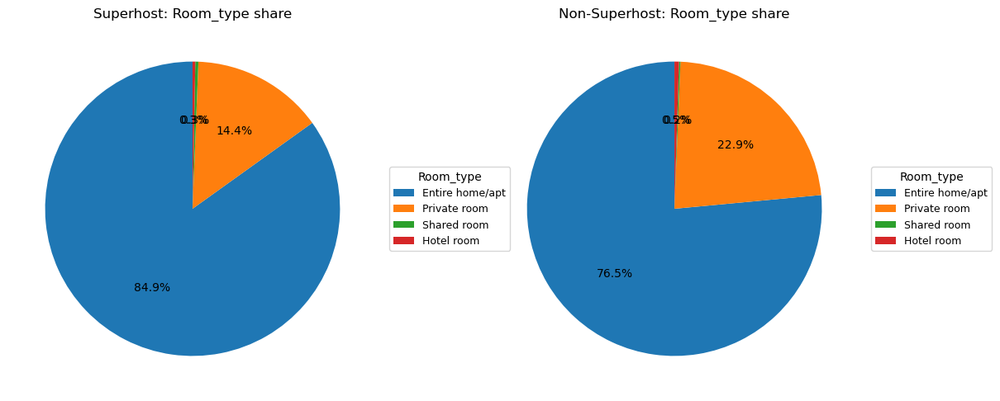

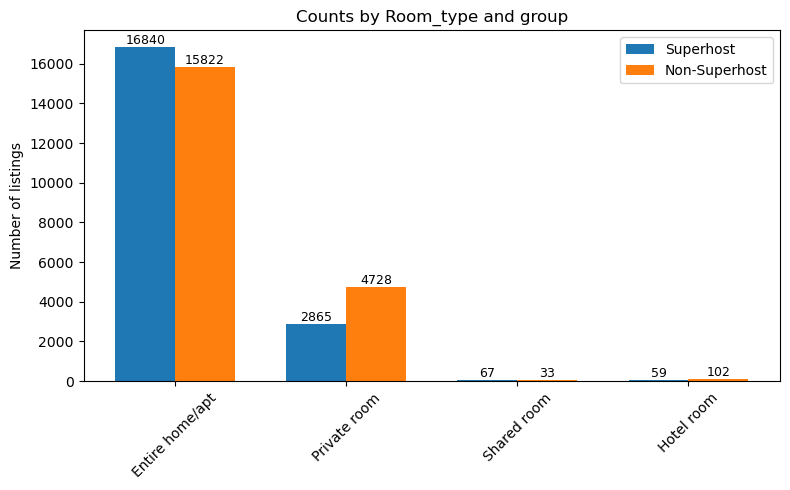

In [463]:
# room type
compare_by_config(d, "room_type", "Room_type")

In [544]:
print('Comparison by Room_type')

Comparison by Room_type



=== Comparison by Capacity (Superhost vs Non-Superhost) — detail table ===


,group,Capacity,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
0,Non-Superhost,1–2,"7,232",137.11,117.00,1.92,1.15,1.02,1.08,27.76
1,Non-Superhost,3–4,"4,891",202.46,180.00,3.79,2.32,1.72,1.19,32.40
2,Non-Superhost,5–6,"4,647",286.32,268.00,5.72,3.60,2.76,1.54,34.74
3,Non-Superhost,7+,"3,915",344.40,333.00,8.73,5.60,3.77,1.98,36.05
4,Superhost,1–2,"7,496",138.85,120.00,1.96,1.10,0.93,1.04,36.14
5,Superhost,3–4,"5,443",196.36,171.00,3.80,2.32,1.68,1.20,41.81
6,Superhost,5–6,"4,065",262.47,234.00,5.73,3.61,2.69,1.56,44.32
7,Superhost,7+,"2,827",312.10,291.00,8.85,5.80,3.77,2.06,46.05



=== Share table by Capacity (within each group) ===


group,Non-Superhost,Superhost
Capacity,,
1–2,34.96%,37.80%
3–4,23.65%,27.45%
5–6,22.47%,20.50%
7+,18.93%,14.26%


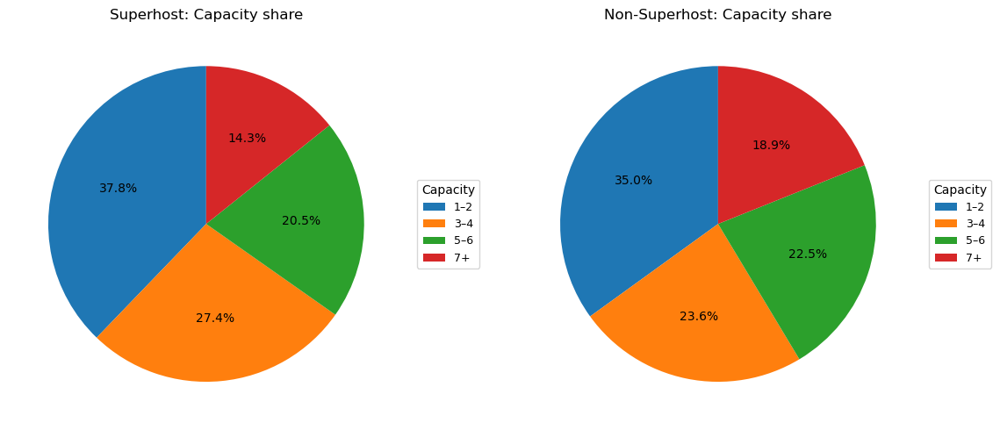

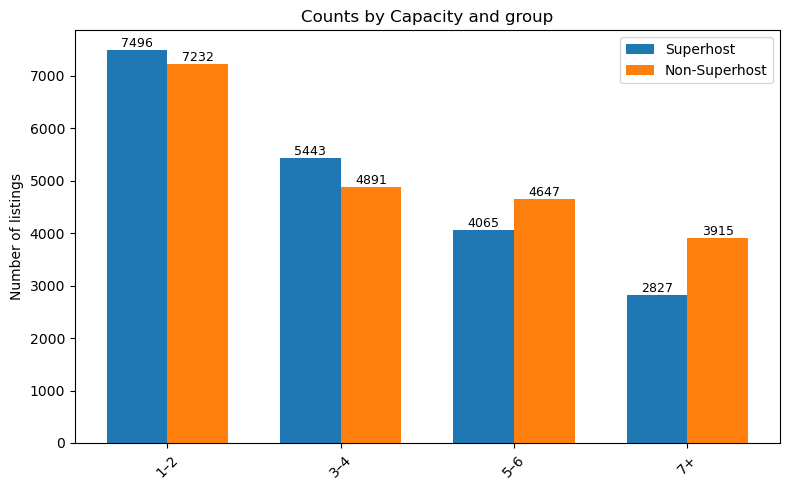

In [464]:
# 2)Capacity
bins_acc   = [0, 2, 4, 6, np.inf]
labels_acc = ["1–2", "3–4", "5–6", "7+"]
d["acc_bucket"] = pd.cut(d["accommodates"], bins=bins_acc, labels=labels_acc, right=True)
compare_by_config(d, "acc_bucket", "Capacity")

In [545]:
print('Comparison by Amenity_level')

Comparison by Amenity_level



=== Comparison by Amenity_level (Superhost vs Non-Superhost) — detail table ===


,group,Amenity_level,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
3,Non-Superhost,36+,"8,676",236.76,204.00,4.95,3.11,2.29,1.47,47.67
2,Non-Superhost,21–35,"6,302",225.99,196.00,4.41,2.75,2.03,1.35,28.07
1,Non-Superhost,11–20,"3,626",227.23,198.00,4.30,2.68,2.02,1.35,15.37
0,Non-Superhost,≤10,"2,081",172.23,138.00,3.30,2.04,1.59,1.20,7.47
7,Superhost,36+,"13,035",216.14,185.00,4.52,2.82,2.05,1.40,49.01
6,Superhost,21–35,"4,964",182.92,153.00,3.70,2.27,1.63,1.23,29.11
5,Superhost,11–20,"1,375",183.45,150.00,3.47,2.14,1.55,1.24,16.03
4,Superhost,≤10,457,177.78,150.00,3.41,2.04,1.45,1.13,7.58



=== Share table by Amenity_level (within each group) ===


group,Non-Superhost,Superhost
Amenity_level,,
36+,41.94%,65.73%
21–35,30.47%,25.03%
11–20,17.53%,6.93%
≤10,10.06%,2.30%


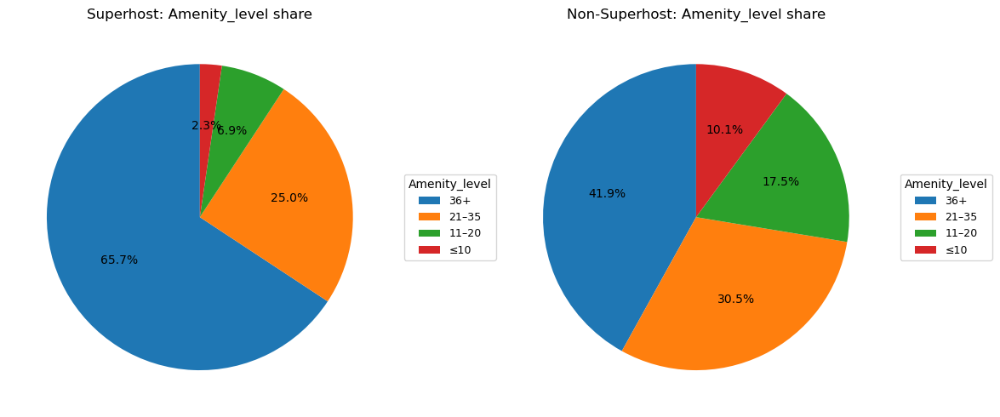

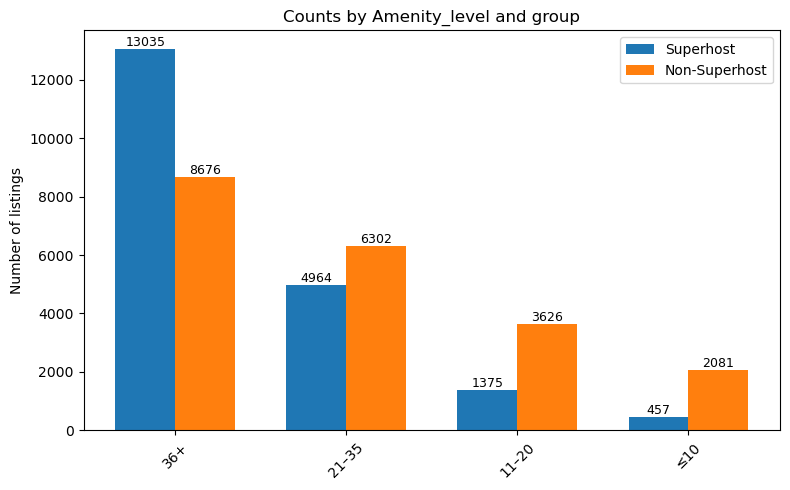

In [465]:
# Amenity_level
bins_amen   = [-0.1, 10, 20, 35, np.inf]
labels_amen = ["≤10", "11–20", "21–35", "36+"]
d["amen_bucket"] = pd.cut(d["amenities_count"], bins=bins_amen, labels=labels_amen, right=True)
compare_by_config(d, "amen_bucket", "Amenity_level")

In [546]:
print('Comparsion by location')

Comparsion by location


In [470]:
def compare_by_location(df, loc_col, loc_label, top_n=20):
    #top-n
    total_counts = (
        df.groupby(loc_col)[ID_COL]
          .size()
          .sort_values(ascending=False)
    )
    top_locations = total_counts.head(top_n).index

    #keep top-n loc
    df_top = df[df[loc_col].isin(top_locations)].copy()

    #detail table
    tmp = (
        df_top.groupby(["group", loc_col], observed=False)
              .agg(
                  count        = (ID_COL, "size"),
                  mean_price   = (PRICE, "mean"),
                  median_price = (PRICE, "median"),
                  acc_mean     = ("accommodates", "mean"),
                  beds_mean    = ("beds", "mean"),
                  bedrooms_mean= ("bedrooms", "mean"),
                  baths_mean   = ("bathrooms", "mean"),
                  amen_mean    = ("amenities_count", "mean"),
              )
              .reset_index()
    )

    tmp = tmp.rename(columns={loc_col: loc_label})
    tmp = tmp.sort_values(["group", "count"], ascending=[True, False])

    print(f"\n=== Location comparison by {loc_label} — detail table (top {top_n}) ===")
    display(
        tmp.style.format({
            "count": "{:,.0f}",
            "mean_price": "{:.2f}",
            "median_price": "{:.2f}",
            "acc_mean": "{:.2f}",
            "beds_mean": "{:.2f}",
            "bedrooms_mean": "{:.2f}",
            "baths_mean": "{:.2f}",
            "amen_mean": "{:.2f}",
        })
    )

    # 2) share table
    pivot_counts = (
        tmp.pivot(index=loc_label, columns="group", values="count")
           .fillna(0)
    )
    share = pivot_counts.div(pivot_counts.sum(axis=0), axis=1)

    if "Superhost" in share.columns:
        order = share["Superhost"].sort_values(ascending=False).index
    else:
        order = share["Non-Superhost"].sort_values(ascending=False).index

    share = share.loc[order]
    pivot_counts = pivot_counts.loc[order]

    print(f"\n=== Share table by {loc_label} (top {top_n}) ===")
    display(
        share.style.format("{:.2%}")
             .set_caption(f"Share of listings in each {loc_label} (Superhost vs Non-Superhost, top {top_n})")
    )

    buckets = share.index.astype(str)
    super_count    = pivot_counts["Superhost"]      if "Superhost" in pivot_counts.columns      else np.zeros(len(buckets))
    nonsuper_count = pivot_counts["Non-Superhost"] if "Non-Superhost" in pivot_counts.columns else np.zeros(len(buckets))

    #pie
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    plot_pie_for_group(share, "Superhost",     loc_label, axes[0])
    plot_pie_for_group(share, "Non-Superhost", loc_label, axes[1])
    plt.tight_layout()
    plt.show()

    #bar
    x = np.arange(len(buckets))
    width = 0.35

    plt.figure(figsize=(8, 5))
    plt.bar(x - width/2, super_count,  width, label="Superhost")
    plt.bar(x + width/2, nonsuper_count, width, label="Non-Superhost")

    plt.xticks(x, buckets, rotation=45)
    plt.ylabel("Number of listings")
    plt.title(f"Counts by {loc_label} and group (top {top_n})")
    plt.legend()

    for i, v in enumerate(super_count):
        plt.text(x[i] - width/2, v, f"{int(v)}", ha="center", va="bottom", fontsize=9)
    for i, v in enumerate(nonsuper_count):
        plt.text(x[i] + width/2, v, f"{int(v)}", ha="center", va="bottom", fontsize=9)

    plt.tight_layout()
    plt.show()


=== Location comparison by Region_parent:BIGGEST AREA — detail table (top 10) ===


,group,Region_parent:BIGGEST AREA,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
0,Non-Superhost,Auckland,"4,755",184.78,148.00,3.65,2.16,1.79,1.37,31.47
3,Non-Superhost,Queenstown-Lakes District,"1,413",314.49,304.00,4.54,2.84,2.16,1.51,35.47
1,Non-Superhost,Christchurch City,"1,119",176.49,150.00,3.99,2.34,1.86,1.34,32.51
7,Non-Superhost,Tauranga City,989,284.13,264.00,5.05,3.15,2.48,1.46,32.16
8,Non-Superhost,Thames-Coromandel District,973,305.74,288.00,6.13,3.99,2.70,1.51,31.23
6,Non-Superhost,Taupo District,744,262.69,251.50,5.81,3.75,2.65,1.52,32.44
2,Non-Superhost,Far North District,715,258.39,226.00,4.81,2.96,2.10,1.36,32.88
9,Non-Superhost,Wellington City,600,181.16,154.00,3.69,2.12,1.80,1.28,32.97
5,Non-Superhost,Tasman District,492,244.36,221.00,4.65,3.03,2.05,1.33,32.83
4,Non-Superhost,Rotorua District,411,202.75,170.00,5.12,3.21,2.17,1.34,32.11



=== Share table by Region_parent:BIGGEST AREA (top 10) ===


group,Non-Superhost,Superhost
Region_parent:BIGGEST AREA,,
Auckland,38.94%,25.51%
Queenstown-Lakes District,11.57%,21.90%
Christchurch City,9.16%,12.59%
Taupo District,6.09%,7.34%
Tauranga City,8.10%,6.09%
Thames-Coromandel District,7.97%,5.92%
Far North District,5.86%,5.76%
Wellington City,4.91%,5.42%
Rotorua District,3.37%,5.12%


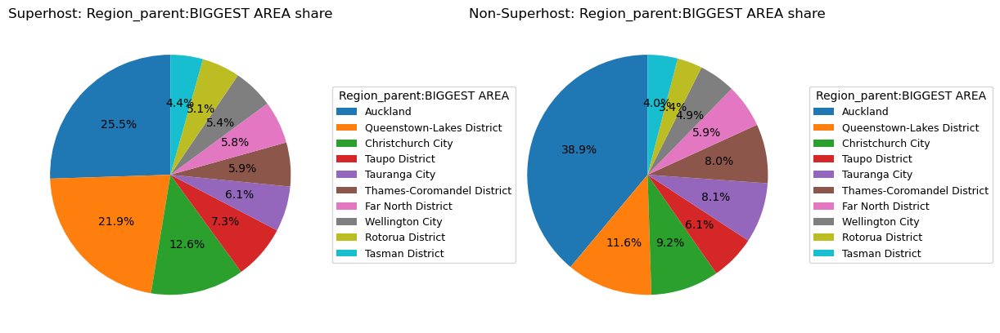

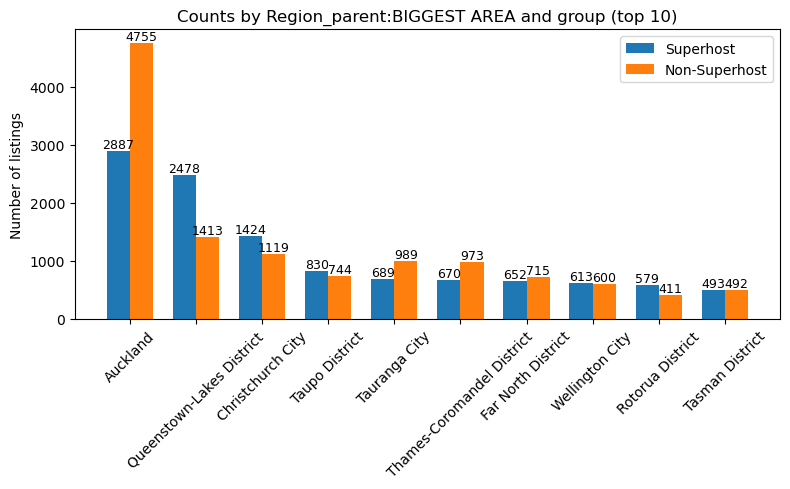

In [547]:
# THE biggest area
compare_by_location(d, "region_parent_name", "Region_parent:BIGGEST AREA", top_n=10)

In [ ]:
report='''
1. Region_parent:

Auckland: Non-Superhosts account for 38.9% of all non-Superhost listings, while Superhosts only account for 25.5%.

In the bar chart, the orange bars (Non-Superhosts) in Auckland are significantly taller than the blue bars (Superhosts).

This indicates that Auckland has the most listings, but the concentration of non-Superhosts is higher.

Queenstown-Lakes District:
Non-Superhosts 11.6%, Superhosts 21.9%.

That is, only about 1/9 of the listings are non-Superhosts here, but more than 1/5 are Superhost listings. 
This is a destination area where Superhosts are clearly concentrated.

Christchurch City, Taupo District, Wellington City, Rotorua District:
Superhost share > Non-Superhost share ( Christchurch 9.2% vs 12.6%, Rotorua 3.4% vs 5.1%). 
These cities have a relatively stronger presence of superhosts.

Tauranga City and Thames-Coromandel District: Non-superhost share is higher than superhost share (8.1% vs 6.1%, 8.0% vs 5.9%).

These resort areas have more regular hosts and relatively fewer superhosts.

In summary: At the regional level, Auckland dominates total supply but is relatively non-superhost-heavy, 
while Queenstown-Lakes, Christchurch, Taupo, and Rotorua are more superhost-intensive tourism regions.
'''
print(report)


=== Location comparison by Region — detail table (top 10) ===


,group,Region,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
1,Non-Superhost,Area Outside Ward,"1,624",198.75,166.00,4.36,2.75,2.01,1.30,31.70
8,Non-Superhost,Waitemat?? and Gulf Ward,"1,189",201.01,164.00,3.54,2.02,1.61,1.28,34.65
6,Non-Superhost,Queenstown-Wakatipu Ward,765,317.92,302.00,4.15,2.51,1.95,1.49,35.97
5,Non-Superhost,Mount Maunganui-Papamoa Ward,665,310.54,299.00,5.40,3.36,2.64,1.51,32.87
9,Non-Superhost,Wanaka Ward,584,304.16,298.50,4.99,3.19,2.37,1.54,35.19
0,Non-Superhost,Albany Ward,536,188.07,153.00,3.81,2.24,1.90,1.39,33.83
7,Non-Superhost,Taup?? Ward,507,273.55,260.00,5.53,3.50,2.61,1.55,33.20
4,Non-Superhost,Mercury Bay Ward,442,312.73,300.00,6.13,3.98,2.70,1.53,32.08
2,Non-Superhost,Bay of Islands-Whangaroa Ward,426,275.61,246.00,4.67,2.92,2.01,1.35,33.62
3,Non-Superhost,Central Ward,280,168.14,149.50,3.81,2.20,1.74,1.38,34.88



=== Share table by Region (top 10) ===


group,Non-Superhost,Superhost
Region,,
Area Outside Ward,23.14%,25.56%
Queenstown-Wakatipu Ward,10.90%,19.68%
Waitemat?? and Gulf Ward,16.94%,10.65%
Wanaka Ward,8.32%,9.52%
Central Ward,3.99%,8.02%
Taup?? Ward,7.22%,7.71%
Mount Maunganui-Papamoa Ward,9.48%,6.02%
Bay of Islands-Whangaroa Ward,6.07%,4.99%
Mercury Bay Ward,6.30%,4.38%


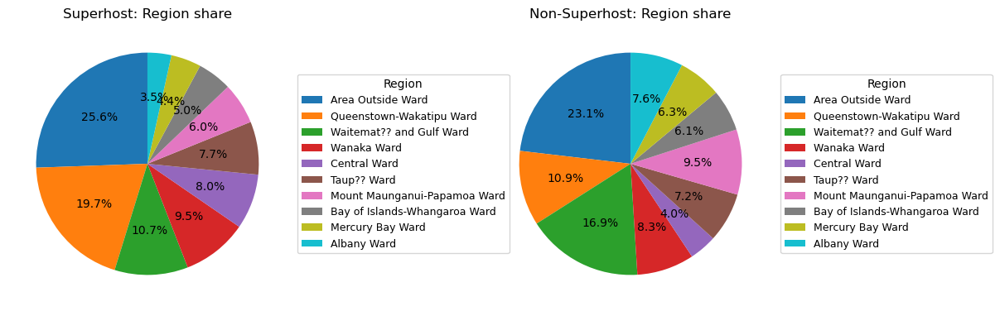

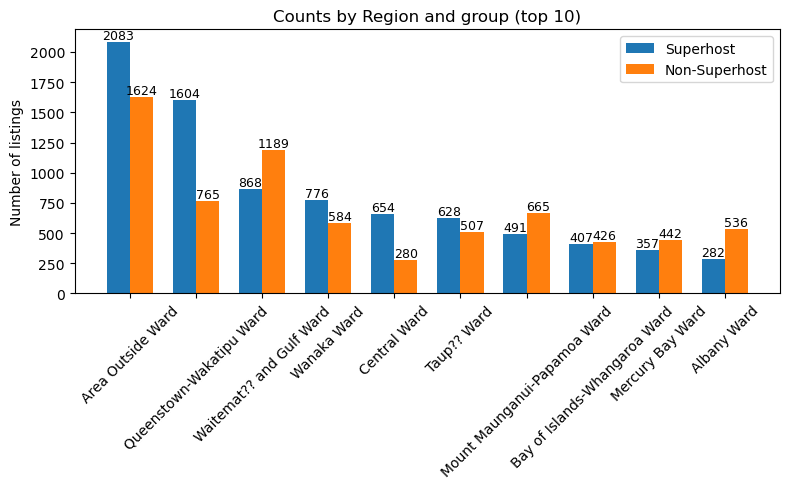

In [477]:
# city
compare_by_location(d, "region_name", "Region", top_n=10)

In [479]:
report='''
2. Region (ward): The Ward map further breaks down the regions, showing specific cities:

Area Outside Ward:
The proportion of Superhosts is slightly higher (25.6% vs 23.1%), and the blue bars (Superhost count) are slightly higher than the orange bars, 
indicating a higher proportion of Superhosts in the outer suburbs/rural areas.


Queenstown-Wakatipu Ward:
Non-Superhosts 10.9%, Superhosts 19.7%.
The blue bars (approximately 1600 listings) are significantly higher than the orange bars (approximately 760 listings).
Therefore, the core area of ​​Queenstown is almost a typical "Superhost territory."

Central Ward, Wanaka Ward, Taupō Ward:
The Superhost share is slightly higher than the Non-Superhost share, and the number of Superhosts is not low.
Therefore, the core business/tourist ward is also more Superhost-friendly.


Waitematā and Gulf Ward, Mount Maunganui-Papamoa, Mercury Bay, Albany Ward: 
Non-Superhosts have a higher share than Superhosts; in the bar chart, the orange bars are generally taller than the blue bars.
Therefore, in these beach/suburban holiday wards, non-Superhosts have a greater advantage, and Superhost penetration is relatively low.

In summary: At the ward level, Superhosts are clustered in core tourism wards such as Queenstown-Wakatipu, Central, Wanaka, and Taupō, 
whereas coastal holiday wards like Waitematā & Gulf or Mount Maunganui-Papamoa are relatively dominated by non-Superhosts.
'''
print(report)


2. Region (ward): The Ward map further breaks down the regions, showing specific cities:

Area Outside Ward:
The proportion of Superhosts is slightly higher (25.6% vs 23.1%), and the blue bars (Superhost count) are slightly higher than the orange bars, 
indicating a higher proportion of Superhosts in the outer suburbs/rural areas.


Queenstown-Wakatipu Ward:
Non-Superhosts 10.9%, Superhosts 19.7%.
The blue bars (approximately 1600 listings) are significantly higher than the orange bars (approximately 760 listings).
Therefore, the core area of ​​Queenstown is almost a typical "Superhost territory."

Central Ward, Wanaka Ward, Taupō Ward:
The Superhost share is slightly higher than the Non-Superhost share, and the number of Superhosts is not low.
Therefore, the core business/tourist ward is also more Superhost-friendly.


Waitematā and Gulf Ward, Mount Maunganui-Papamoa, Mercury Bay, Albany Ward: 
Non-Superhosts have a higher share than Superhosts; in the bar chart, the orange bars are 


=== Location comparison by Neighbourhood — detail table (top 10) ===


,group,Neighbourhood,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
0,Non-Superhost,"Auckland, New Zealand","1,436",180.65,143.50,3.63,2.14,1.77,1.36,39.01
1,Non-Superhost,"Christchurch, Canterbury, New Zealand",292,175.75,147.00,3.75,2.21,1.72,1.28,38.36
6,Non-Superhost,"Queenstown, Otago, New Zealand",209,347.75,338.00,4.19,2.62,1.94,1.45,37.81
9,Non-Superhost,"Wellington, New Zealand",206,170.26,145.00,3.49,2.07,1.70,1.25,38.61
5,Non-Superhost,"Nelson, New Zealand",113,216.54,190.00,4.02,2.73,1.92,1.30,42.81
2,Non-Superhost,"Dunedin, Otago, New Zealand",111,191.43,170.00,4.00,2.47,1.89,1.23,36.86
4,Non-Superhost,"Napier, Hawke's Bay, New Zealand",109,262.50,222.00,4.55,2.72,2.18,1.38,36.68
3,Non-Superhost,"Hamilton, Waikato, New Zealand",94,170.43,155.50,3.89,2.46,1.89,1.39,37.76
8,Non-Superhost,"Wanaka, Otago, New Zealand",93,329.62,334.00,5.71,3.84,2.70,1.67,39.98
7,Non-Superhost,"Rotorua, Bay of Plenty, New Zealand",82,229.26,196.50,5.17,3.15,2.20,1.28,36.49



=== Share table by Neighbourhood (top 10) ===


group,Non-Superhost,Superhost
Neighbourhood,,
"Auckland, New Zealand",52.31%,29.61%
"Christchurch, Canterbury, New Zealand",10.64%,17.47%
"Queenstown, Otago, New Zealand",7.61%,16.40%
"Wellington, New Zealand",7.50%,8.81%
"Dunedin, Otago, New Zealand",4.04%,6.04%
"Rotorua, Bay of Plenty, New Zealand",2.99%,4.66%
"Hamilton, Waikato, New Zealand",3.42%,4.37%
"Nelson, New Zealand",4.12%,4.31%
"Wanaka, Otago, New Zealand",3.39%,4.29%


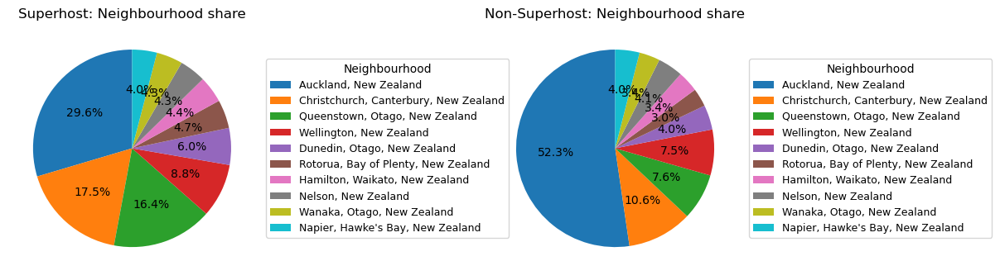

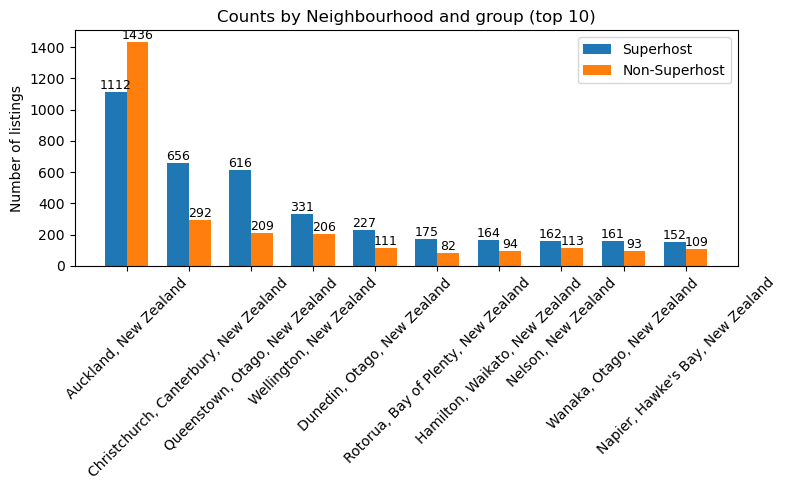

In [478]:
#neighbourhood
compare_by_location(d, "neighbourhood", "Neighbourhood", top_n=10)

In [480]:
report='''
3. Neighbourhood

Neighbourhood here is actually tagged with "City, New Zealand," equivalent to city level.

Auckland, New Zealand:
Non-Superhost 52.3%, Superhost 29.6%.
Orange bars (non-superhost) > Blue bars (superhost), and the difference is significant.
This further confirms that Auckland has the largest pool of listings in the country, but it is mainly composed of ordinary landlords.


In cities like Christchurch, Queenstown, Wellington, and Dunedin, the share of Superhosts is higher than that of Non-Superhosts 
( Queenstown 7.6% vs 16.4%). Therefore, the penetration rate of Superhosts is significantly higher in the South Island and some capital/tourist cities.

In second-tier cities like Rotorua, Hamilton, Nelson, Wanaka, and Napier:
The share of Superhosts is also slightly higher than that of Non-Superhosts, and the difference in numbers is not significant.
These second-tier cities generally have a "Superhost advantage," indicating more professional management.

Summary: At the city level, Auckland accounts for over half of non-Superhost listings but less than one-third of Superhosts, 
while cities such as Christchurch, Queenstown, Wellington and Dunedin are relatively more Superhost-oriented.
'''
print(report)


3. Neighbourhood

Neighbourhood here is actually tagged with "City, New Zealand," equivalent to city level.

Auckland, New Zealand:
Non-Superhost 52.3%, Superhost 29.6%.
Orange bars (non-superhost) > Blue bars (superhost), and the difference is significant.
This further confirms that Auckland has the largest pool of listings in the country, but it is mainly composed of ordinary landlords.


In cities like Christchurch, Queenstown, Wellington, and Dunedin, the share of Superhosts is higher than that of Non-Superhosts 
( Queenstown 7.6% vs 16.4%). Therefore, the penetration rate of Superhosts is significantly higher in the South Island and some capital/tourist cities.

In second-tier cities like Rotorua, Hamilton, Nelson, Wanaka, and Napier:
The share of Superhosts is also slightly higher than that of Non-Superhosts, and the difference in numbers is not significant.
These second-tier cities generally have a "Superhost advantage," indicating more professional management.

Summary: At the

In [481]:
report='''
Location effect – spatial concentration of Superhosts
At all three spatial levels (region_parent, region and neighbourhood), Auckland dominates the overall supply but is relatively non-Superhost heavy. 

In contrast, tourism-oriented destinations such as Queenstown-Lakes, Christchurch, Taupō, Wanaka and Rotorua show a higher concentration of Superhosts. 

This pattern suggests that professional and highly-rated hosts are more likely to operate in mature tourism markets,
while large metropolitan areas like Auckland still have a substantial share of casual or less-experienced hosts.
'''
print(report)


Location effect – spatial concentration of Superhosts
At all three spatial levels (region_parent, region and neighbourhood), Auckland dominates the overall supply but is relatively non-Superhost heavy. 

In contrast, tourism-oriented destinations such as Queenstown-Lakes, Christchurch, Taupō, Wanaka and Rotorua show a higher concentration of Superhosts. 

This pattern suggests that professional and highly-rated hosts are more likely to operate in mature tourism markets,
while large metropolitan areas like Auckland still have a substantial share of casual or less-experienced hosts.



In [489]:
import folium
from folium.plugins import MarkerCluster, HeatMap

geo = d.dropna(subset=["latitude", "longitude"]).copy()


max_points = 5000
if len(geo) > max_points:
    geo_sample = geo.sample(max_points, random_state=42)
else:
    geo_sample = geo

print(f"Used {len(geo_sample)} points on the map.")


center_lat = geo_sample["latitude"].mean()
center_lon = geo_sample["longitude"].mean()

m = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=6,         
    tiles="CartoDB positron"
)


color_map = {
    "Superhost": "red",
    "Non-Superhost": "blue"
}


for g, sub in geo_sample.groupby("group"):
    cluster = MarkerCluster(name=g).add_to(m)
    for _, row in sub.iterrows():
        price = row.get(PRICE, np.nan)
        city  = row.get("region_name", "")
        reg   = row.get("region_parent_name", "")
        nbhd  = row.get("neighbourhood", "")

        popup_txt = (
            f"<b>{g}</b><br>"
            f"Price: {price:.0f} NZD/night<br>"
            f"Region: {reg}<br>"
            f"City/Ward: {city}<br>"
            f"Neighbourhood: {nbhd}"
        )

        folium.CircleMarker(
            location=[row["latitude"], row["longitude"]],
            radius=3,
            color=color_map.get(g, "gray"),
            fill=True,
            fill_opacity=0.6,
            popup=folium.Popup(popup_txt, max_width=250)
        ).add_to(cluster)

# all heatmap
HeatMap(
    data=geo_sample[["latitude", "longitude"]].values.tolist(),
    radius=8,
    blur=6,
    name="All listings heatmap"
).add_to(m)

folium.LayerControl().add_to(m)


m.save("nz_airbnb_superhost_map.html")
m


Used 5000 points on the map.


In [490]:
report='''
Since Auckland, Queenstown-Lakes District, and Christchurch City accounted for the highest proportion of listings in the Region_parent analysis,
representing the platform's primary supply source, these three locations were further selected for GIS visualization. 
Firstly, they collectively contribute the majority of Superhost and Non-Superhost listings,
representing the overall landscape of the New Zealand Airbnb market. 

Secondly, these three locations correspond to two different scenarios:
a large urban market and a typical tourist destination, respectively, 
facilitating a comparative observation of the spatial distribution and price differences of Superhosts in different types of regions.

Therefore, the subsequent maps will focus on showcasing the spatial layout and price distribution characteristics of these three regions.
'''
print(report)


Since Auckland, Queenstown-Lakes District, and Christchurch City accounted for the highest proportion of listings in the Region_parent analysis,
representing the platform's primary supply source, these three locations were further selected for GIS visualization. 
Firstly, they collectively contribute the majority of Superhost and Non-Superhost listings,
representing the overall landscape of the New Zealand Airbnb market. 

Secondly, these three locations correspond to two different scenarios:
a large urban market and a typical tourist destination, respectively, 
facilitating a comparative observation of the spatial distribution and price differences of Superhosts in different types of regions.

Therefore, the subsequent maps will focus on showcasing the spatial layout and price distribution characteristics of these three regions.



In [491]:
def plot_region_map(df, region_parent=None, region=None, max_points=3000, zoom_start=11):
    sub = df.dropna(subset=["latitude", "longitude"]).copy()

    if region_parent is not None:
        sub = sub[sub["region_parent_name"] == region_parent]
    if region is not None:
        sub = sub[sub["region_name"] == region]

    if sub.empty:
        print("No data for this filter.")
        return None

    if len(sub) > max_points:
        sub = sub.sample(max_points, random_state=42)

    center_lat = sub["latitude"].mean()
    center_lon = sub["longitude"].mean()

    m_local = folium.Map(
        location=[center_lat, center_lon],
        zoom_start=zoom_start,
        tiles="CartoDB positron"
    )

    color_map = {"Superhost": "red", "Non-Superhost": "blue"}

    for g, gsub in sub.groupby("group"):
        cluster = MarkerCluster(name=g).add_to(m_local)
        for _, row in gsub.iterrows():
            price = row.get(PRICE, np.nan)
            popup_txt = (
                f"<b>{g}</b><br>"
                f"Price: {price:.0f} NZD/night<br>"
                f"{row.get('neighbourhood','')}"
            )
            folium.CircleMarker(
                location=[row["latitude"], row["longitude"]],
                radius=3,
                color=color_map.get(g, "gray"),
                fill=True,
                fill_opacity=0.6,
                popup=folium.Popup(popup_txt, max_width=250)
            ).add_to(cluster)

    HeatMap(
        data=sub[["latitude", "longitude"]].values.tolist(),
        radius=8,
        blur=6,
        name="Heatmap"
    ).add_to(m_local)

    folium.LayerControl().add_to(m_local)
    return m_local

In [548]:
print('Auckland_Superhost_map')

Auckland_Superhost_map


In [492]:
m_akl = plot_region_map(d, region_parent="Auckland", max_points=3000, zoom_start=10)
m_akl.save("auckland_superhost_map.html")
m_akl

In [549]:
print('Queenstown_Superhost_map')

Queenstown_Superhost_map


In [493]:
m_qt = plot_region_map(d, region_parent="Queenstown-Lakes District", max_points=2000, zoom_start=11)
m_qt.save("queenstown_superhost_map.html")
m_qt

In [550]:
print('Christchurch_Superhost_map')

Christchurch_Superhost_map


In [494]:
m_chch = plot_region_map(d,region_parent="Christchurch City", max_points=2000, zoom_start=11)
m_chch.save("christchurch_superhost_map.html")
m_chch

In [506]:
#bucket
if "acc_bucket" not in d.columns:
    bins_acc   = [0, 2, 4, 6, np.inf]
    labels_acc = ["1–2", "3–4", "5–6", "7+"]
    d["acc_bucket"] = pd.cut(d["accommodates"], bins=bins_acc,
                             labels=labels_acc, right=True)

if "amen_bucket" not in d.columns:
    bins_amen   = [-0.1, 10, 20, 35, np.inf]
    labels_amen = ["≤10", "11–20", "21–35", "36+"]
    d["amen_bucket"] = pd.cut(d["amenities_count"], bins=bins_amen,
                              labels=labels_amen, right=True)

    
def compare_by_config(df, bucket_col, bucket_label, top_n=None, others_label="Other"):
    df2 = df.copy()
    if top_n is not None:
        counts = df2[bucket_col].value_counts(dropna=False)
        top_vals = counts.index[:top_n]

        df2[bucket_col] = df2[bucket_col].where(
            df2[bucket_col].isin(top_vals),
            other=others_label
        )

   
    tmp = (
        df2.groupby(["group", bucket_col], observed=False)
           .agg(
               count        = (ID_COL, "size"),
               mean_price   = (PRICE, "mean"),
               median_price = (PRICE, "median"),
               acc_mean     = ("accommodates", "mean"),
               beds_mean    = ("beds", "mean"),
               bedrooms_mean= ("bedrooms", "mean"),
               baths_mean   = ("bathrooms", "mean"),
               amen_mean    = ("amenities_count", "mean"),
           )
           .reset_index()
    )

    tmp = tmp.rename(columns={bucket_col: bucket_label})

    
    tmp = tmp.sort_values(["group", "count"], ascending=[True, False])

    print(f"\n=== Comparison by {bucket_label} (Superhost vs Non-Superhost) — detail table ===")
    display(
        tmp.style.format({
            "count": "{:,.0f}",
            "mean_price": "{:.2f}",
            "median_price": "{:.2f}",
            "acc_mean": "{:.2f}",
            "beds_mean": "{:.2f}",
            "bedrooms_mean": "{:.2f}",
            "baths_mean": "{:.2f}",
            "amen_mean": "{:.2f}",
        })
    )

    # share table
    pivot_counts = (
        tmp.pivot(index=bucket_label, columns="group", values="count")
           .fillna(0)
    )
    share = pivot_counts.div(pivot_counts.sum(axis=0), axis=1)

    
    sort_col = "Non-Superhost" if "Non-Superhost" in share.columns else share.columns[0]
    share = share.sort_values(sort_col, ascending=False)
    pivot_counts = pivot_counts.loc[share.index]  

    print(f"\n=== Share table by {bucket_label} (within each group) ===")
    display(
        share.style.format("{:.2%}")
             .set_caption(f"Share of listings in each {bucket_label} bucket (Superhost vs Non-Superhost)")
    )

    buckets = share.index.astype(str)
    super_count    = pivot_counts["Superhost"]      if "Superhost" in pivot_counts.columns      else np.zeros(len(buckets))
    nonsuper_count = pivot_counts["Non-Superhost"] if "Non-Superhost" in pivot_counts.columns else np.zeros(len(buckets))

    #pie chart
    def plot_pie_for_group(pivot_share, group_name, bucket_label, ax):
        if group_name not in pivot_share.columns:
            ax.text(0.5, 0.5, "No data", ha="center", va="center")
            ax.axis("off")
            return
        sizes = pivot_share[group_name].fillna(0).values
        if sizes.sum() == 0:
            ax.text(0.5, 0.5, "No data", ha="center", va="center")
            ax.axis("off")
            return
        wedges, texts, autotexts = ax.pie(
            sizes,
            autopct="%1.1f%%",
            startangle=90
        )
        ax.set_title(f"{group_name}: {bucket_label} share")
        ax.legend(
            wedges,
            pivot_share.index.tolist(),
            title=bucket_label,
            loc="center left",
            bbox_to_anchor=(1.02, 0.5),
            fontsize=8
        )

    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    plot_pie_for_group(share, "Superhost",     bucket_label, axes[0])
    plot_pie_for_group(share, "Non-Superhost", bucket_label, axes[1])
    plt.tight_layout()
    plt.show()

    #bar chart
    x = np.arange(len(buckets))
    width = 0.35

    plt.figure(figsize=(10, 5))
    plt.bar(x - width/2, super_count,    width, label="Superhost")
    plt.bar(x + width/2, nonsuper_count, width, label="Non-Superhost")

    plt.xticks(x, buckets, rotation=45, ha="right")
    plt.ylabel("Number of listings")
    plt.title(f"Counts by {bucket_label} and group")
    plt.legend()

    for i, v in enumerate(super_count):
        if v > 0:
            plt.text(x[i] - width/2, v, f"{int(v)}", ha="center", va="bottom", fontsize=8)
    for i, v in enumerate(nonsuper_count):
        if v > 0:
            plt.text(x[i] + width/2, v, f"{int(v)}", ha="center", va="bottom", fontsize=8)

    plt.tight_layout()
    plt.show()

In [519]:
report='''
Auckland property type and capacity with price Comparsion
'''
print(report)


Auckland property type and capacity with price Comparsion




=== Comparison by Property_type (Superhost vs Non-Superhost) — detail table ===


,group,Property_type,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
2,Non-Superhost,Entire home,"1,411",277.78,256.00,5.68,3.38,2.81,1.72,34.66
5,Non-Superhost,Private room in home,"1,047",93.06,77.00,2.00,1.25,1.16,1.15,23.74
4,Non-Superhost,Other,"1,042",174.16,143.00,3.07,1.88,1.49,1.36,31.27
3,Non-Superhost,Entire rental unit,864,173.10,148.50,3.33,1.82,1.49,1.20,35.03
1,Non-Superhost,Entire guesthouse,232,155.26,135.00,2.88,1.62,1.23,1.03,32.16
0,Non-Superhost,Entire guest suite,159,139.48,125.00,3.06,1.79,1.35,1.07,35.04
8,Superhost,Entire home,702,280.30,256.00,5.59,3.45,2.71,1.73,45.95
9,Superhost,Entire rental unit,702,180.31,156.50,3.12,1.74,1.43,1.21,42.44
10,Superhost,Other,634,173.01,145.50,3.46,2.08,1.62,1.35,38.69
11,Superhost,Private room in home,370,74.55,69.00,2.05,1.16,1.11,1.11,35.15



=== Share table by Property_type (within each group) ===


group,Non-Superhost,Superhost
Property_type,,
Entire home,29.67%,24.32%
Private room in home,22.02%,12.82%
Other,21.91%,21.96%
Entire rental unit,18.17%,24.32%
Entire guesthouse,4.88%,8.21%
Entire guest suite,3.34%,8.38%


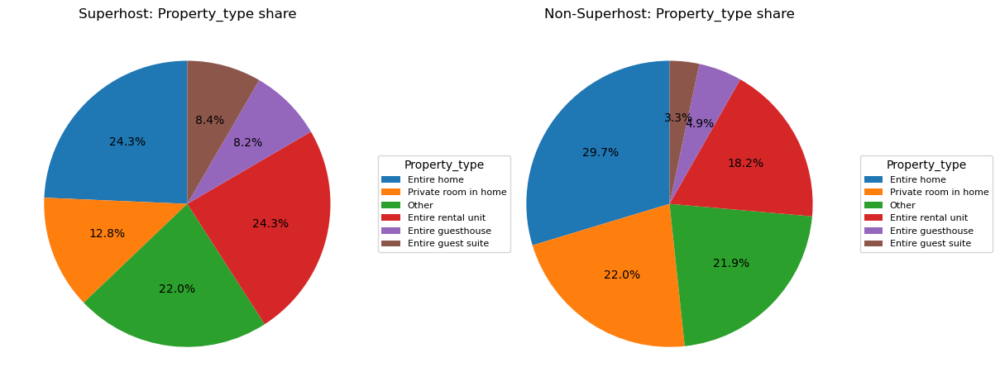

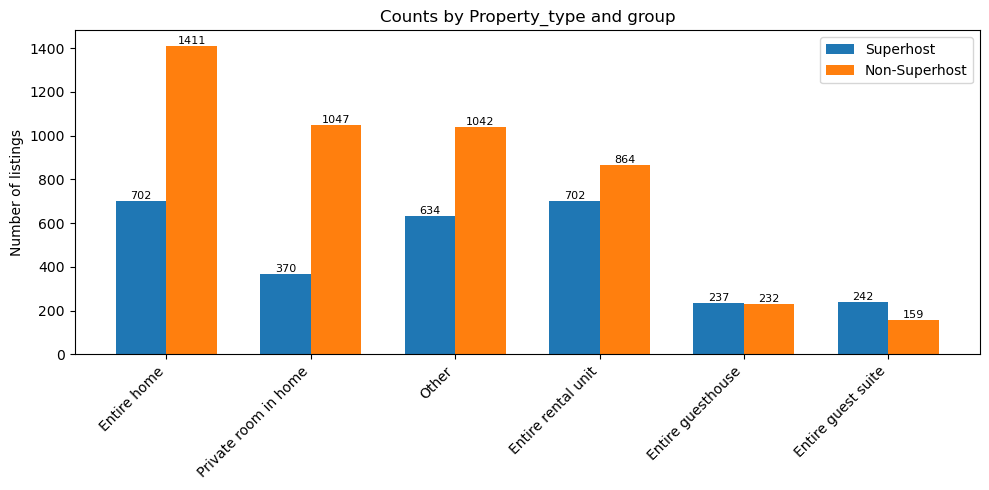

In [535]:
akl = d[d["region_parent_name"] == "Auckland"].copy()
compare_by_config(akl, "property_type", "Property_type", top_n=5)

Top 5 property types in Auckland:
['Entire home', 'Entire rental unit', 'Private room in home', 'Entire guesthouse', 'Entire guest suite']


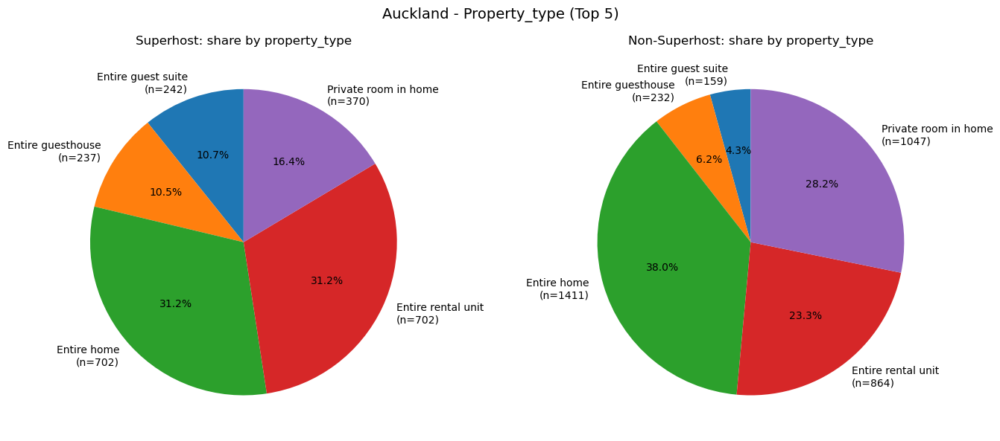


Share table (Top 5 property_type in Auckland):


group,Non-Superhost,Superhost
property_type,,
Entire guest suite,4.28%,10.74%
Entire guesthouse,6.25%,10.52%
Entire home,38.00%,31.16%
Entire rental unit,23.27%,31.16%
Private room in home,28.20%,16.42%


In [537]:
akl = d[d["region_parent_name"] == "Auckland"].copy()

# Top 5 property_type
top5_types = (
    akl["property_type"]
    .value_counts()
    .head(5)
    .index
)

akl_top = akl[akl["property_type"].isin(top5_types)].copy()
akl_top["property_type"] = akl_top["property_type"].astype(str)
print("Top 5 property types in Auckland:")
print(top5_types.tolist())

def plot_type_share_pies(df, title_prefix="Auckland - Property_type (Top 5)"):
    #count
    cnt = (
        df.groupby(["property_type", "group"])[ID_COL]
          .size()
          .reset_index(name="count")
    )
    pivot_counts = (
        cnt.pivot(index="property_type", columns="group", values="count")
           .fillna(0)
    )
    share = pivot_counts.div(pivot_counts.sum(axis=0), axis=1)

    def _plot_one(ax, group_name):
        if group_name not in pivot_counts.columns:
            ax.text(0.5, 0.5, "No data", ha="center", va="center")
            ax.axis("off")
            return

        sizes = share[group_name].values
        labels = [
            f"{t}\n(n={int(pivot_counts.loc[t, group_name])})"
            for t in share.index
        ]
        wedges, texts, autotexts = ax.pie(
            sizes,
            labels=labels,
            autopct="%1.1f%%",
            startangle=90
        )
        ax.set_title(f"{group_name}: share by property_type")

    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    fig.suptitle(title_prefix, fontsize=14)

    _plot_one(axes[0], "Superhost")
    _plot_one(axes[1], "Non-Superhost")

    plt.tight_layout()
    plt.show()

    # share table
    print("\nShare table (Top 5 property_type in Auckland):")
    display(
        share.style.format("{:.2%}")
             .set_caption("Share of listings in each property_type (Superhost vs Non-Superhost)")
    )


plot_type_share_pies(akl_top)


Price summary by property_type (Top 5, Auckland):


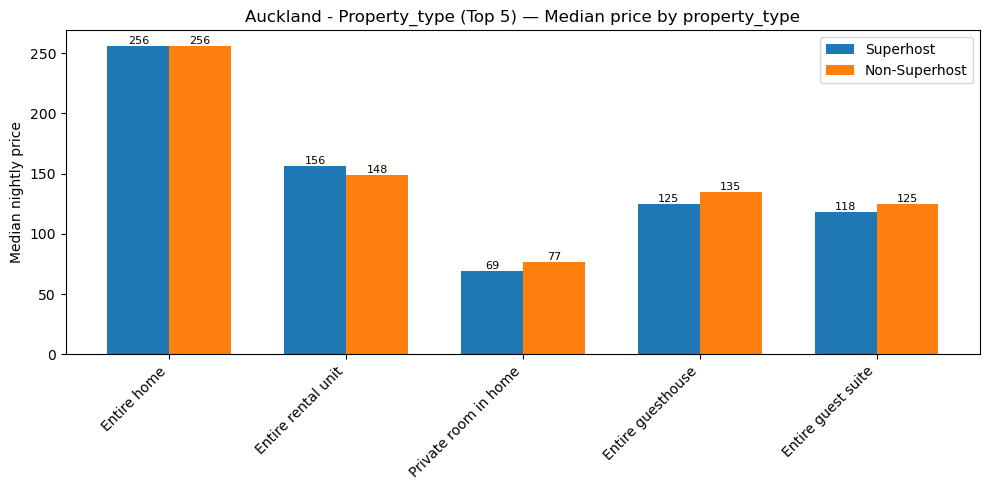

In [538]:
def plot_type_price_bars(df, title_prefix="Auckland - Property_type (Top 5)"):
    stats = (
        df.groupby(["property_type", "group"])[PRICE]
          .agg(mean_price="mean", median_price="median", count="size")
          .reset_index()
    )

    #by count
    order = (
        stats.groupby("property_type")["count"]
             .sum()
             .sort_values(ascending=False)
             .index
    )
    stats["property_type"] = pd.Categorical(stats["property_type"], categories=order, ordered=True)
    stats = stats.sort_values(["property_type", "group"])

    print("\nPrice summary by property_type (Top 5, Auckland):")
    display(
        stats.pivot(index="property_type", columns="group", values=["mean_price", "median_price"])
             .style.format("{:.2f}")
    )

    types = order.tolist()
    x = np.arange(len(types))
    width = 0.35

    def _bar_for_metric(metric, ylabel, title_suffix):
        plt.figure(figsize=(10, 5))
        super_vals = []
        non_vals   = []
        for t in types:
            tmp = stats[stats["property_type"] == t]
            super_vals.append(tmp.loc[tmp["group"] == "Superhost", metric].values[0]
                              if "Superhost" in tmp["group"].values else np.nan)
            non_vals.append(tmp.loc[tmp["group"] == "Non-Superhost", metric].values[0]
                            if "Non-Superhost" in tmp["group"].values else np.nan)

        plt.bar(x - width/2, super_vals, width, label="Superhost")
        plt.bar(x + width/2, non_vals,   width, label="Non-Superhost")

        plt.xticks(x, types, rotation=45, ha="right")
        plt.ylabel(ylabel)
        plt.title(f"{title_prefix} — {title_suffix}")
        plt.legend()

        for i, v in enumerate(super_vals):
            if not np.isnan(v):
                plt.text(x[i] - width/2, v, f"{v:.0f}", ha="center", va="bottom", fontsize=8)
        for i, v in enumerate(non_vals):
            if not np.isnan(v):
                plt.text(x[i] + width/2, v, f"{v:.0f}", ha="center", va="bottom", fontsize=8)

        plt.tight_layout()
        plt.show()

    # median price
    _bar_for_metric("median_price", "Median nightly price", "Median price by property_type")

plot_type_price_bars(akl_top)

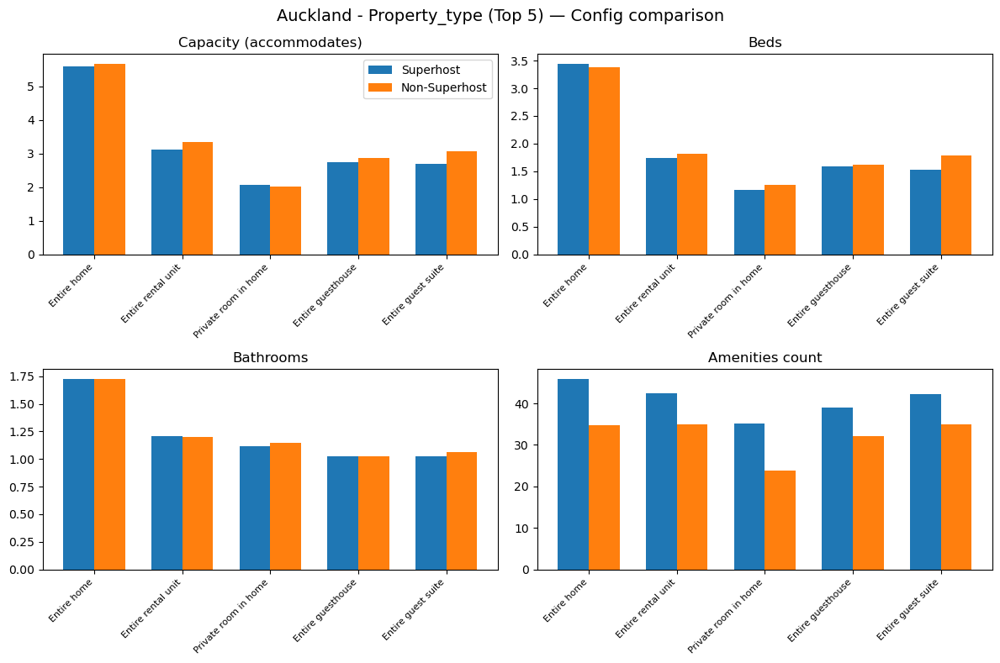

In [539]:
def plot_type_config_bars(df, title_prefix="Auckland - Property_type (Top 5)"):
    metrics = [
        ("accommodates",    "Capacity (accommodates)"),
        ("beds",            "Beds"),
        ("bathrooms",       "Bathrooms"),
        ("amenities_count", "Amenities count"),
    ]

    stats_cfg = (
        df.groupby(["property_type", "group"])[[m[0] for m in metrics]]
          .mean()
          .reset_index()
    )

    order = (
        df["property_type"]
        .value_counts()
        .loc[stats_cfg["property_type"].unique()]
        .sort_values(ascending=False)
        .index
    )
    stats_cfg["property_type"] = pd.Categorical(stats_cfg["property_type"], categories=order, ordered=True)
    stats_cfg = stats_cfg.sort_values(["property_type", "group"])
    types = order.tolist()
    x = np.arange(len(types))
    width = 0.35

    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f"{title_prefix} — Config comparison", fontsize=14)
    axes = axes.ravel()

    for ax, (col, label) in zip(axes, metrics):
        super_vals = []
        non_vals   = []
        for t in types:
            tmp = stats_cfg[stats_cfg["property_type"] == t]
            super_vals.append(tmp.loc[tmp["group"] == "Superhost", col].values[0]
                              if "Superhost" in tmp["group"].values else np.nan)
            non_vals.append(tmp.loc[tmp["group"] == "Non-Superhost", col].values[0]
                            if "Non-Superhost" in tmp["group"].values else np.nan)

        ax.bar(x - width/2, super_vals, width, label="Superhost")
        ax.bar(x + width/2, non_vals,   width, label="Non-Superhost")
        ax.set_title(label)
        ax.set_xticks(x)
        ax.set_xticklabels(types, rotation=45, ha="right", fontsize=8)

    axes[0].legend(loc="upper right")
    plt.tight_layout()
    plt.show()

plot_type_config_bars(akl_top)

In [522]:
report='''
Queenstown property type and capacity with price Comparsion
'''
print(report)


Queenstown property type and capacity with price Comparsion




=== Comparison by Property_type (Superhost vs Non-Superhost) — detail table ===


,group,Property_type,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
2,Non-Superhost,Entire home,642,387.60,395.50,6.01,3.75,2.92,1.80,37.03
4,Non-Superhost,Other,283,286.48,268.00,3.63,2.45,1.73,1.38,34.25
3,Non-Superhost,Entire rental unit,236,291.39,264.50,3.70,2.23,1.68,1.31,36.42
5,Non-Superhost,Private room in home,107,164.00,135.00,2.17,1.20,1.10,1.21,28.42
1,Non-Superhost,Entire guesthouse,80,203.43,189.50,3.05,1.84,1.35,1.09,34.31
0,Non-Superhost,Entire guest suite,65,182.54,167.00,2.69,1.62,1.03,1.02,35.06
9,Superhost,Entire rental unit,777,317.37,299.00,3.89,2.33,1.82,1.45,41.68
8,Superhost,Entire home,702,395.84,395.50,5.96,3.75,2.87,1.88,45.07
10,Superhost,Other,478,287.58,270.00,3.67,2.32,1.64,1.31,39.01
7,Superhost,Entire guesthouse,193,207.63,183.00,2.72,1.61,1.18,1.08,39.09



=== Share table by Property_type (within each group) ===


group,Non-Superhost,Superhost
Property_type,,
Entire home,45.44%,28.33%
Other,20.03%,19.29%
Entire rental unit,16.70%,31.36%
Private room in home,7.57%,5.69%
Entire guesthouse,5.66%,7.79%
Entire guest suite,4.60%,7.55%


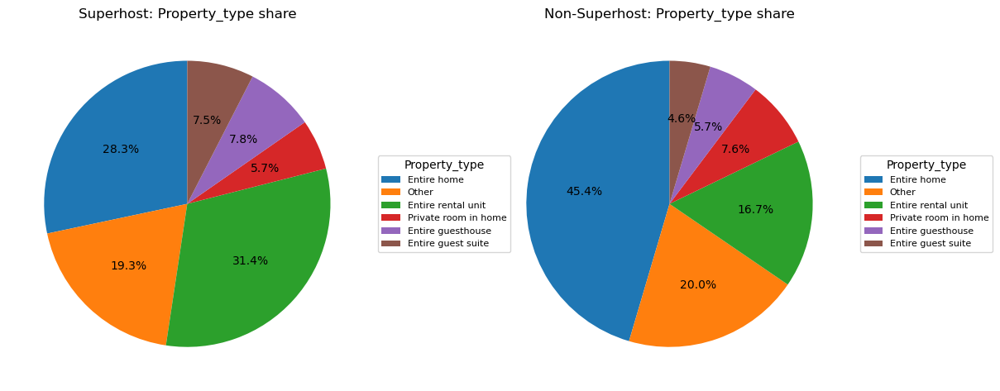

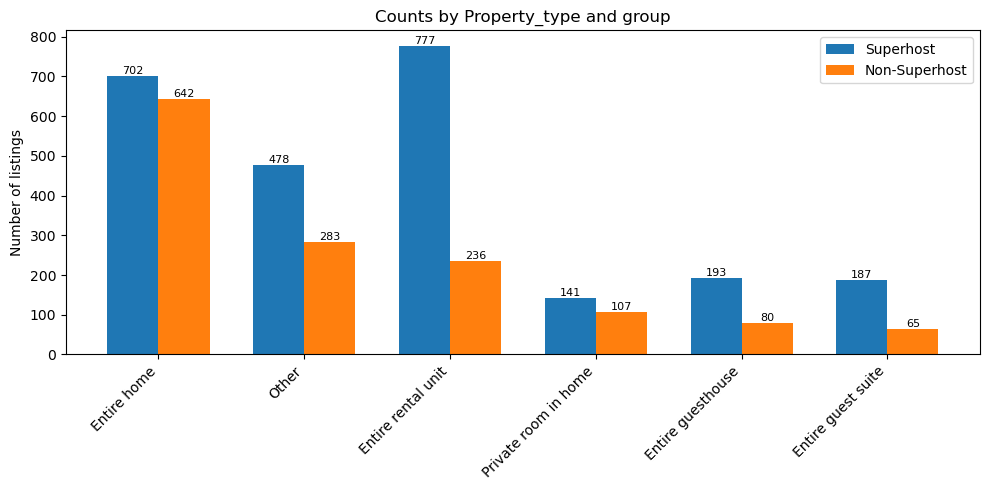

In [530]:
# Queenstown
qt = d[d["region_parent_name"] == "Queenstown-Lakes District"].copy()
compare_by_config(qt, "property_type", "Property_type", top_n=5)

Top 5 property types in Queenstown:
['Entire home', 'Entire rental unit', 'Entire guesthouse', 'Entire guest suite', 'Private room in home']


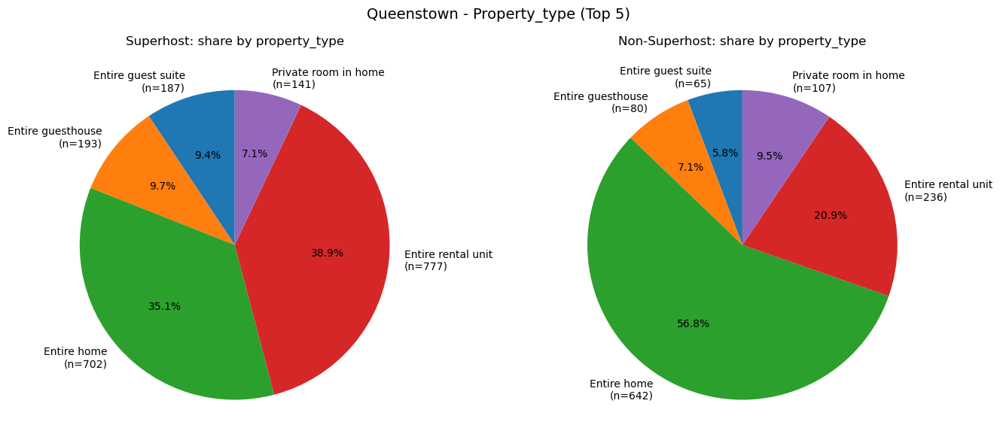


Share table (Top 5 property_type in Queenstown):


group,Non-Superhost,Superhost
property_type,,
Entire guest suite,5.75%,9.35%
Entire guesthouse,7.08%,9.65%
Entire home,56.81%,35.10%
Entire rental unit,20.88%,38.85%
Private room in home,9.47%,7.05%


In [532]:
qt = d[d["region_parent_name"] == "Queenstown-Lakes District"].copy()

# Top 5 property_type
top5_types = (
    qt["property_type"]
      .value_counts()
      .head(5)
      .index
)

qt_top = qt[qt["property_type"].isin(top5_types)].copy()
qt_top["property_type"] = qt_top["property_type"].astype(str)
print("Top 5 property types in Queenstown:")
print(top5_types.tolist())

def plot_type_share_pies(df, title_prefix="Queenstown - Property_type (Top 5)"):
    # count
    cnt = (
        df.groupby(["property_type", "group"])[ID_COL]
          .size()
          .reset_index(name="count")
    )
    pivot_counts = (
        cnt.pivot(index="property_type", columns="group", values="count")
           .fillna(0)
    )
    share = pivot_counts.div(pivot_counts.sum(axis=0), axis=1)

    def _plot_one(ax, group_name):
        if group_name not in pivot_counts.columns:
            ax.text(0.5, 0.5, "No data", ha="center", va="center")
            ax.axis('off')
            return

        sizes = share[group_name].values
        labels = [
            f"{t}\n(n={int(pivot_counts.loc[t, group_name])})"
            for t in share.index
        ]
        wedges, texts, autotexts = ax.pie(
            sizes,
            labels=labels,
            autopct="%1.1f%%",
            startangle=90
        )
        ax.set_title(f"{group_name}: share by property_type")

    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    fig.suptitle(title_prefix, fontsize=14)

    _plot_one(axes[0], "Superhost")
    _plot_one(axes[1], "Non-Superhost")

    plt.tight_layout()
    plt.show()

    # share table
    print("\nShare table (Top 5 property_type in Queenstown):")
    display(
        share.style.format("{:.2%}")
             .set_caption(
                 "Share of listings in each property_type "
                 "(Superhost vs Non-Superhost, Queenstown)"
             )
    )

plot_type_share_pies(qt_top)


Price summary by property_type (Top 5, Queenstown):


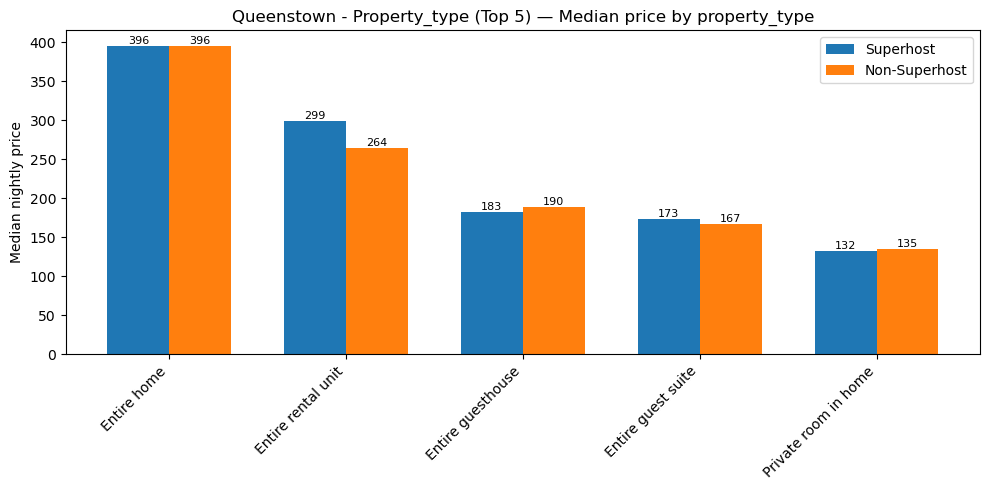

In [533]:
def plot_type_price_bars(df, title_prefix="Queenstown - Property_type (Top 5)"):
    stats = (
        df.groupby(["property_type", "group"])[PRICE]
          .agg(mean_price="mean", median_price="median", count="size")
          .reset_index()
    )

    # by count 
    order = (
        stats.groupby("property_type")["count"]
             .sum()
             .sort_values(ascending=False)
             .index
    )
    stats["property_type"] = pd.Categorical(
        stats["property_type"], categories=order, ordered=True
    )
    stats = stats.sort_values(["property_type", "group"])

    print("\nPrice summary by property_type (Top 5, Queenstown):")
    display(
        stats.pivot(index="property_type", columns="group", values=["mean_price", "median_price"])
             .style.format("{:.2f}")
    )

    types = order.tolist()
    x = np.arange(len(types))
    width = 0.35

    def _bar_for_metric(metric, ylabel, title_suffix):
        plt.figure(figsize=(10, 5))
        super_vals = []
        non_vals   = []
        for t in types:
            tmp = stats[stats["property_type"] == t]
            super_vals.append(
                tmp.loc[tmp["group"] == "Superhost", metric].values[0]
                if "Superhost" in tmp["group"].values else np.nan
            )
            non_vals.append(
                tmp.loc[tmp["group"] == "Non-Superhost", metric].values[0]
                if "Non-Superhost" in tmp["group"].values else np.nan
            )

        plt.bar(x - width/2, super_vals, width, label="Superhost")
        plt.bar(x + width/2, non_vals,   width, label="Non-Superhost")

        plt.xticks(x, types, rotation=45, ha="right")
        plt.ylabel(ylabel)
        plt.title(f"{title_prefix} — {title_suffix}")
        plt.legend()

        for i, v in enumerate(super_vals):
            if not np.isnan(v):
                plt.text(x[i] - width/2, v, f"{v:.0f}", ha="center", va="bottom", fontsize=8)
        for i, v in enumerate(non_vals):
            if not np.isnan(v):
                plt.text(x[i] + width/2, v, f"{v:.0f}", ha="center", va="bottom", fontsize=8)

        plt.tight_layout()
        plt.show()

    # median price
    _bar_for_metric("median_price", "Median nightly price", "Median price by property_type")

plot_type_price_bars(qt_top, title_prefix="Queenstown - Property_type (Top 5)")

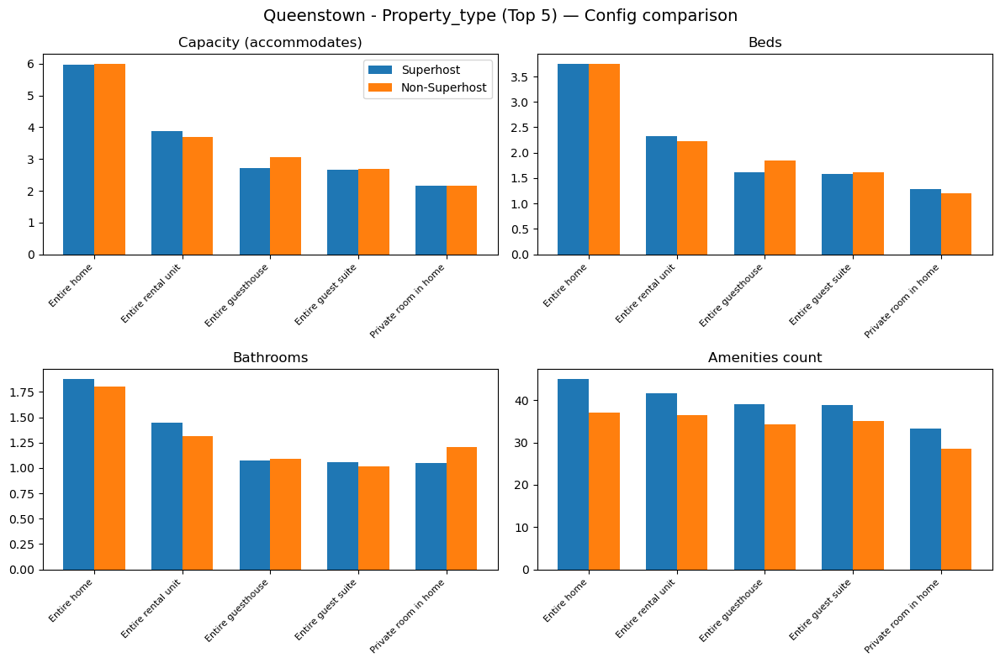

In [534]:
def plot_type_config_bars(df, title_prefix="Queenstown - Property_type (Top 5)"):
    metrics = [
        ("accommodates",    "Capacity (accommodates)"),
        ("beds",            "Beds"),
        ("bathrooms",       "Bathrooms"),
        ("amenities_count", "Amenities count"),
    ]

    stats_cfg = (
        df.groupby(["property_type", "group"])[[m[0] for m in metrics]]
          .mean()
          .reset_index()
    )

    order = (
        df["property_type"]
          .value_counts()
          .loc[stats_cfg["property_type"].unique()]
          .sort_values(ascending=False)
          .index
    )
    stats_cfg["property_type"] = pd.Categorical(
        stats_cfg["property_type"], categories=order, ordered=True
    )
    stats_cfg = stats_cfg.sort_values(["property_type", "group"])

    types = order.tolist()
    x = np.arange(len(types))
    width = 0.35

    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f"{title_prefix} — Config comparison", fontsize=14)
    axes = axes.ravel()

    for ax, (col, label) in zip(axes, metrics):
        super_vals = []
        non_vals   = []
        for t in types:
            tmp = stats_cfg[stats_cfg["property_type"] == t]
            super_vals.append(
                tmp.loc[tmp["group"] == "Superhost", col].values[0]
                if "Superhost" in tmp["group"].values else np.nan
            )
            non_vals.append(
                tmp.loc[tmp["group"] == "Non-Superhost", col].values[0]
                if "Non-Superhost" in tmp["group"].values else np.nan
            )

        ax.bar(x - width/2, super_vals, width, label="Superhost")
        ax.bar(x + width/2, non_vals,   width, label="Non-Superhost")
        ax.set_title(label)
        ax.set_xticks(x)
        ax.set_xticklabels(types, rotation=45, ha="right", fontsize=8)

    axes[0].legend(loc="upper right")
    plt.tight_layout()
    plt.show()

plot_type_config_bars(qt_top, title_prefix="Queenstown - Property_type (Top 5)")

In [521]:
report='''
Christchurch property type and capacity with price Comparsion
'''
print(report)


Christchurch property type and capacity with price Comparsion




=== Comparison by Property_type (Superhost vs Non-Superhost) — detail table ===


,group,Property_type,count,mean_price,median_price,acc_mean,beds_mean,bedrooms_mean,baths_mean,amen_mean
1,Non-Superhost,Entire home,375,233.10,206.00,5.65,3.30,2.68,1.62,35.41
4,Non-Superhost,Other,293,160.95,147.00,3.02,1.88,1.33,1.03,28.54
2,Non-Superhost,Entire rental unit,180,180.93,156.50,3.75,2.14,1.74,1.35,34.99
5,Non-Superhost,Private room in home,157,82.79,70.00,2.06,1.18,1.08,1.13,24.29
3,Non-Superhost,Entire townhouse,76,164.43,134.50,4.87,2.74,2.18,1.63,43.53
0,Non-Superhost,Entire guesthouse,38,127.89,103.50,2.39,1.39,0.92,1.03,34.63
7,Superhost,Entire home,494,187.14,166.00,5.57,3.25,2.54,1.70,48.33
8,Superhost,Entire rental unit,323,148.72,135.00,3.66,2.07,1.61,1.28,43.91
10,Superhost,Other,254,143.81,121.50,3.26,1.99,1.37,1.17,38.66
11,Superhost,Private room in home,142,68.09,65.00,2.06,1.26,1.13,1.10,36.94



=== Share table by Property_type (within each group) ===


group,Non-Superhost,Superhost
Property_type,,
Entire home,33.51%,34.69%
Other,26.18%,17.84%
Entire rental unit,16.09%,22.68%
Private room in home,14.03%,9.97%
Entire townhouse,6.79%,8.71%
Entire guesthouse,3.40%,6.11%


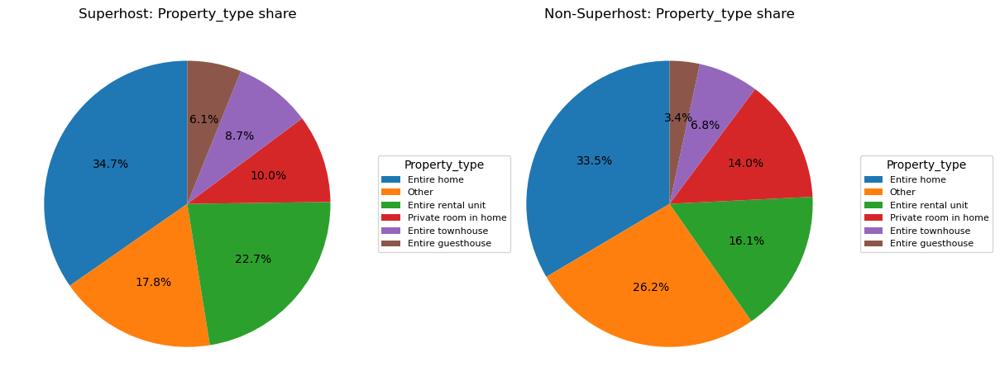

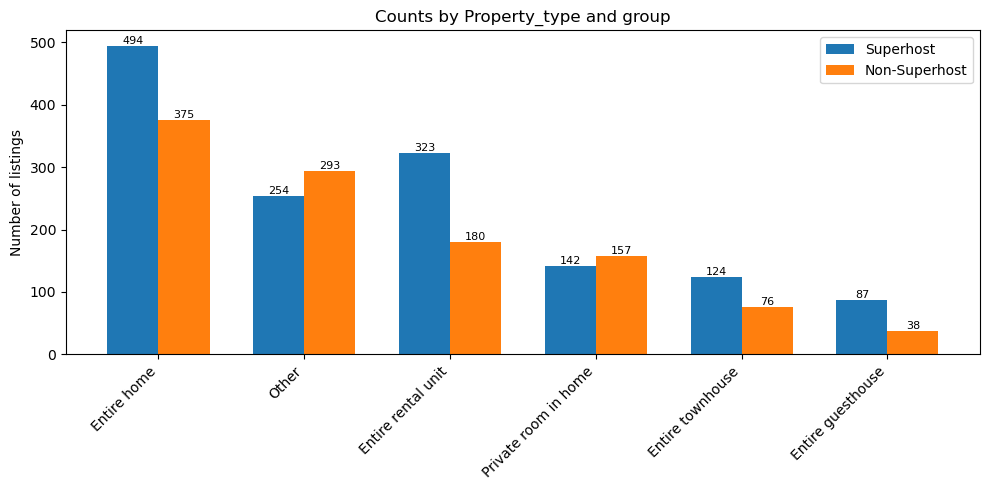

In [524]:
chch = d[d["region_parent_name"] == "Christchurch City"].copy()

compare_by_config(chch, "property_type", "Property_type", top_n=5)

Top 5 property types in Christchurch:
['Entire home', 'Entire rental unit', 'Private room in home', 'Entire townhouse', 'Entire guesthouse']


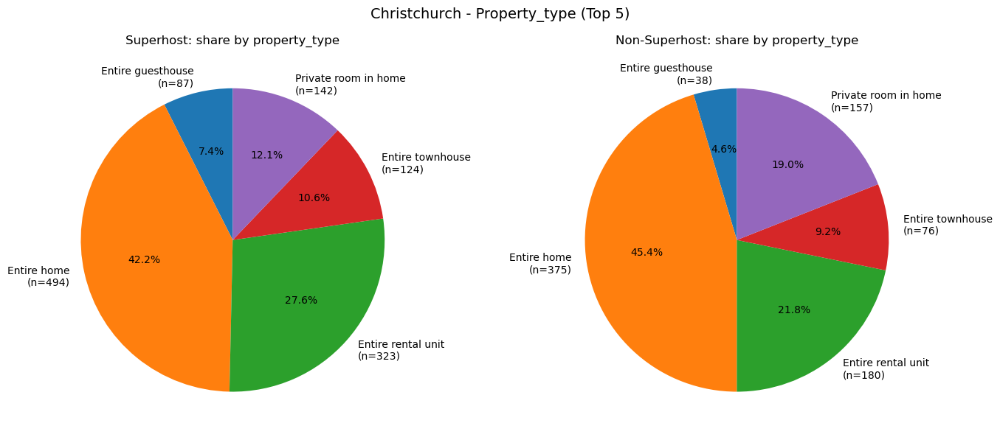


Share table (Top 5 property_type in Christchurch):


group,Non-Superhost,Superhost
property_type,,
Entire guesthouse,4.60%,7.44%
Entire home,45.40%,42.22%
Entire rental unit,21.79%,27.61%
Entire townhouse,9.20%,10.60%
Private room in home,19.01%,12.14%


In [526]:
chch = d[d["region_parent_name"] == "Christchurch City"].copy()

# Top 5 property_type
top5_types = (
    chch["property_type"]
        .value_counts()
        .head(5)
        .index
)

chch_top = chch[chch["property_type"].isin(top5_types)].copy()
chch_top["property_type"] = chch_top["property_type"].astype(str)
print("Top 5 property types in Christchurch:")
print(top5_types.tolist())

def plot_type_share_pies(df, title_prefix="Christchurch - Property_type (Top 5)"):
    # count
    cnt = (
        df.groupby(["property_type", "group"])[ID_COL]
          .size()
          .reset_index(name="count")
    )
    pivot_counts = (
        cnt.pivot(index="property_type", columns="group", values="count")
           .fillna(0)
    )
    share = pivot_counts.div(pivot_counts.sum(axis=0), axis=1)

    def _plot_one(ax, group_name):
        if group_name not in pivot_counts.columns:
            ax.text(0.5, 0.5, "No data", ha="center", va="center")
            ax.axis('off')
            return

        sizes = share[group_name].values
        labels = [
            f"{t}\n(n={int(pivot_counts.loc[t, group_name])})"
            for t in share.index
        ]
        wedges, texts, autotexts = ax.pie(
            sizes,
            labels=labels,
            autopct="%1.1f%%",
            startangle=90
        )
        ax.set_title(f"{group_name}: share by property_type")

    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    fig.suptitle(title_prefix, fontsize=14)

    _plot_one(axes[0], "Superhost")
    _plot_one(axes[1], "Non-Superhost")

    plt.tight_layout()
    plt.show()

    # share table
    print("\nShare table (Top 5 property_type in Christchurch):")
    display(
        share.style.format("{:.2%}")
             .set_caption(
                 "Share of listings in each property_type "
                 "(Superhost vs Non-Superhost, Christchurch)"
             )
    )

plot_type_share_pies(chch_top)

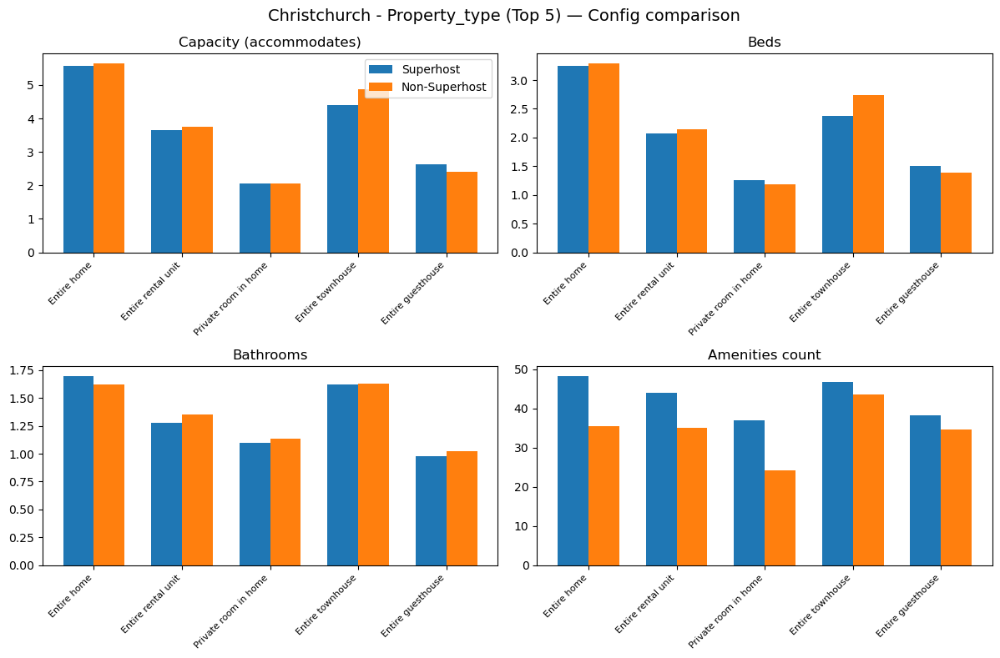

In [541]:
def plot_type_config_bars(df, title_prefix="Christchurch - Property_type (Top 5)"):
    metrics = [
        ("accommodates",    "Capacity (accommodates)"),
        ("beds",            "Beds"),
        ("bathrooms",       "Bathrooms"),
        ("amenities_count", "Amenities count"),
    ]

    stats_cfg = (
        df.groupby(["property_type", "group"])[[m[0] for m in metrics]]
          .mean()
          .reset_index()
    )

    order = (
        df["property_type"]
          .value_counts()
          .loc[stats_cfg["property_type"].unique()]
          .sort_values(ascending=False)
          .index
    )
    stats_cfg["property_type"] = pd.Categorical(
        stats_cfg["property_type"], categories=order, ordered=True
    )
    stats_cfg = stats_cfg.sort_values(["property_type", "group"])

    types = order.tolist()
    x = np.arange(len(types))
    width = 0.35

    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f"{title_prefix} — Config comparison", fontsize=14)
    axes = axes.ravel()

    for ax, (col, label) in zip(axes, metrics):
        super_vals = []
        non_vals   = []
        for t in types:
            tmp = stats_cfg[stats_cfg["property_type"] == t]
            super_vals.append(
                tmp.loc[tmp["group"] == "Superhost", col].values[0]
                if "Superhost" in tmp["group"].values else np.nan
            )
            non_vals.append(
                tmp.loc[tmp["group"] == "Non-Superhost", col].values[0]
                if "Non-Superhost" in tmp["group"].values else np.nan
            )

        ax.bar(x - width/2, super_vals, width, label="Superhost")
        ax.bar(x + width/2, non_vals,   width, label="Non-Superhost")
        ax.set_title(label)
        ax.set_xticks(x)
        ax.set_xticklabels(types, rotation=45, ha="right", fontsize=8)

    axes[0].legend(loc="upper right")
    plt.tight_layout()
    plt.show()
    
plot_type_config_bars(chch_top, title_prefix="Christchurch - Property_type (Top 5)")